In [35]:
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import symnum
import symnum.numpy as snp
import jax
import jax.numpy as jnp
from jax.scipy.stats import norm 
from jax import jit, vmap, value_and_grad
from jax.example_libraries.optimizers import adam
from jax.lax import scan 
import matplotlib.pyplot as plt

In [36]:
### Class for computing Kalman filtering under interacting underdamped Langevin dynamics
### Observable: X, rough, Hidden: Y, smooth

class ips_udl_filtering:
    def __init__(self, dt_data, grad_potential_func):
        self.step_size_data = dt_data
        self.grad_potential_func = grad_potential_func
    
    def calc_coeff_mat_obs(self, θ):
        λ, γ, *_ = θ
        dt = self.step_size_data
        return jnp.array(
            [dt - 0.5 * γ * (dt ** 2)]
        )
    
    def calc_mean_obs(self, obs, θ, empirical_mean):
        *_, κ = θ
        dt = self.step_size_data
        grad_potential = self.grad_potential_func(obs, θ)
        return obs + 0.5 * (dt ** 2) * (- grad_potential - κ * (obs - empirical_mean))  
    
    def calc_mean_hidden(self, obs, θ, empirical_mean):
        *_, κ = θ
        dt = self.step_size_data
        grad_potential = self.grad_potential_func(obs, θ)
        return (- grad_potential - κ * (obs - empirical_mean)) * dt


    def matrix_A(self, θ):
        λ, γ, *_ = θ
        dt = self.step_size_data
        return jnp.array(
            [
                [dt - 0.5 * γ * (dt ** 2)],
                [1 - γ * dt]
            ]
        ) 
    
    def mean_one_step(self, obs, hidden, θ, empirical_mean):
        dt = self.step_size_data
        λ, γ, *_ = θ 
        A = jnp.array(
            [
                dt - 0.5 * γ * (dt ** 2),
                1 - γ * dt
            ]
        )
        
        return jnp.array([
            self.calc_mean_obs(obs, θ, empirical_mean),
            self.calc_mean_hidden(obs, θ, empirical_mean)
            ]) +  hidden * A
        
    def covariance_one_step(self, θ, inv_temp = 1.0):
        dt = self.step_size_data
        *_, σ, κ = θ 
        return σ**2 * jnp.array([
            [(dt**3) / 3, (dt**2) / 2], 
            [(dt**2) / 2, dt]
            ])
    
    def prediction_covariance(self, forward_filter_covariance, θ):
        Σ =self.covariance_one_step(θ)
        A = self.matrix_A(θ)
        pred_cov =  Σ + (A @ A.T)*forward_filter_covariance
        pred_cov_oo = pred_cov[0,0] # covariance of  (obs, obs) 
        pred_cov_ho = pred_cov[1,0] # covariance of  (hiden, obs) 
        pred_cov_hh = pred_cov[1,1] # covariance of  (hiden, hidden) 
        return pred_cov_oo, pred_cov_ho, pred_cov_hh
    
    
    def prediction_mean(self, obs, forward_filter_mean, θ, empirical_mean):
        pred_mean = self.mean_one_step(obs, forward_filter_mean, θ, empirical_mean) 
        pred_mean_obs = pred_mean[0]
        pred_mean_hidden = pred_mean[1]
        return pred_mean_obs, pred_mean_hidden
    

    def forward_filter_mean_cov_one_step(self, current_obs, next_obs, forward_filter_mean, forward_filter_covariance, θ, empirical_mean):
        μ_o, μ_h = self.prediction_mean(current_obs, forward_filter_mean, θ, empirical_mean)
        Λ_oo, Λ_ho, Λ_hh = self.prediction_covariance(forward_filter_covariance, θ) 
        next_filter_mean = μ_h + ((next_obs - μ_o)/Λ_oo)*Λ_ho
        next_filter_cov = Λ_hh - (Λ_ho**2) / Λ_oo
        return jnp.array([next_filter_mean]), jnp.array([next_filter_cov])
    
    
    def forward_filter_mean_cov_paths_scan(self, obs_path, initial_mean, initial_cov, θ, empirical_mean_path):
        @jit
        def step_func(filter_mean_cov, path_current_next):
            filter_mean, filter_cov = filter_mean_cov
            obs_current, obs_next, empirical_mean_current = path_current_next
            filter_next = self.forward_filter_mean_cov_one_step(obs_current, obs_next, filter_mean, filter_cov, θ, empirical_mean_current)     
            return filter_next, filter_next 
        
        _, filter_mean_cov = scan(step_func, (initial_mean, initial_cov), (obs_path[:-1], obs_path[1:], empirical_mean_path[:-1]))
        filter_mean, filter_cov = filter_mean_cov

        return jnp.concatenate((initial_mean[None], filter_mean)), jnp.concatenate((initial_cov[None], filter_cov)) 
    
    
    def get_contrast_function_fixed_index(self, θ, obs_path, initial_mean, initial_cov, empirical_mean_path):
        filter_mean_path, filter_cov_path = self.forward_filter_mean_cov_paths_scan(obs_path, initial_mean, initial_cov, θ, empirical_mean_path)
        initial_log_likelihood = norm.logpdf(obs_path[0], loc = obs_path[0], scale = 1.0)
        Σ = self.covariance_one_step(θ)

        @jit
        def step_func(loglikelihood, qset_filtermeancov_empiricalmean):
            q_current, q_next, filter_mean, filter_cov, empirical_mean = qset_filtermeancov_empiricalmean
            A_q = self.calc_coeff_mat_obs(θ)
            q_mean = self.calc_mean_obs(q_current, θ, empirical_mean) + jnp.dot(A_q, filter_mean)
            vec = filter_cov * A_q 
            scalar = jnp.dot(vec, A_q)
            q_scale = jnp.sqrt(scalar + Σ[0,0])
            loglikelihood_next = loglikelihood + norm.logpdf(q_next, q_mean, q_scale)
            return loglikelihood_next, loglikelihood_next
        
        _, log_likelihood_seq = scan(step_func, initial_log_likelihood, (obs_path[:-1], obs_path[1:], filter_mean_path[:-1], filter_cov_path[:-1], empirical_mean_path[:-1])
                                     )

        return -2*log_likelihood_seq[-1]
    
    
    def get_contrast_function(self, θ, obs_path_particles, initial_mean, initial_cov, empirical_mean_path):
        contrast_function = jnp.sum(
            vmap(self.get_contrast_function_fixed_index, (None, 1, None, None, None))(
                θ, obs_path_particles, initial_mean, initial_cov, empirical_mean_path
            )
        )

        return contrast_function

In [37]:
class ips_udl_em:
    def __init__(self, dt_data, grad_potential_func):
        self.dt_data = dt_data
        self.grad_potential_func = grad_potential_func

    def get_contrast_function_fixed_index(self, θ, obs_path, empirical_mean_path):
        λ, γ, σ, κ = θ
        dt = self.dt_data
        a = σ ** 2

        @jit
        def step_func(contrast, state_and_empiricalmean):
            X_t2, X_t1, X_t0, Y_t0, empirical_mean = state_and_empiricalmean
            drift_rough = - self.grad_potential_func(Y_t0, θ) - κ * (Y_t0 - empirical_mean) - γ * X_t0
            contrast_next = contrast + (1.5 * (X_t2 - X_t1 - drift_rough * dt) ** 2 / (a * dt) + jnp.log(a))
        
            return contrast_next, contrast_next
        
        hidden_path = (obs_path[1:] - obs_path[:-1]) / dt
        Y_t0_seq = obs_path[:-3].reshape(-1)  # Observations at time t0
        X_t0_seq = hidden_path[:-2].reshape(-1)  # Synthetic data at time t0
        X_t1_seq = hidden_path[1:-1].reshape(-1)  # Synthetic data at time t1
        X_t2_seq = hidden_path[2:].reshape(-1)  # Synthetic data at time t2
        empirical_mean_path = jnp.array(empirical_mean_path[:-3]) 

        initial_contrast = 0.0      

        _, contrast_seq = scan(step_func, initial_contrast, (X_t2_seq, X_t1_seq, X_t0_seq, Y_t0_seq, empirical_mean_path))

        return contrast_seq[-1]

    def get_contrast_function(self, θ, obs_path_particles, empirical_mean_path):
        contrast_function = jnp.sum(
            vmap(self.get_contrast_function_fixed_index, (None, 1, None))(
                θ, obs_path_particles, empirical_mean_path
            )
        )

        return contrast_function

In [38]:
# Define the interaction term
def interaction_term(v_i, v_j):
    """Compute the interaction term between two particles."""
    return v_j - v_i

# Function to run a single simulation using JAX and scan
def run_simulation(seed, num_particles, num_steps, dt, model_parameters, grad_potential_func, discard_steps=0, inv_temp = 1.0):
    # Set the random seed for reproducibility
    key = jax.random.PRNGKey(seed)

    λ = model_parameters['lambda']
    γ = model_parameters['gamma']
    σ = model_parameters['sigma']
    κ = model_parameters['kappa']

    # Initialize variables
    p = jnp.zeros(num_particles)  # Voltage-like variable
    q = jnp.zeros(num_particles)  # Recovery-like variable

    # Define the step function for scan
    def step(carry, _):
        p, q, key = carry

        # Compute interaction terms using jax.vmap
        def compute_interaction(v_all):
            return jax.vmap(lambda v_i: jnp.sum(jax.vmap(lambda v_j: interaction_term(v_i, v_j))(v_all)))(v_all)

        interaction = compute_interaction(q)

        # Generate random noise
        key, subkey = jax.random.split(key)
        noise = jax.random.normal(subkey, shape=(num_particles, ))

        # Update underdamped langevin equations with interaction and noise
        grad_potential = 4 * λ * (q**2 - 0.5) * q
        dp = (- grad_potential + κ * interaction/num_particles - γ * p) * dt + σ * jnp.sqrt(dt) * noise
        dq = p * dt # + (- grad_potential + κ * interaction/num_particles - γ * p) * (dt ** 2) * 0.5
        
        p += dp
        q += dq

        return (p, q, key), (p, q)

    # Run the simulation using scan
    (p_final, q_final, _), (p_history, q_history) = jax.lax.scan(step, (p, q, key), jnp.arange(num_steps))

    # Combine v and w into pairs for each particle at each time step
    pq_pairs = jnp.stack((p_history, q_history), axis=-1)  # Shape: (num_steps, num_particles, 2)
    return pq_pairs[discard_steps:, :, :]


In [39]:
# Plot the results

def showplots(x_seq_sim, x_seq_obs, t_seq_sim, t_seq_obs):
    plt.figure(figsize=(12, 6))
    plt.plot(t_seq_sim, x_seq_sim, '.', alpha=0.5, markersize=0.5)
    plt.plot(t_seq_obs, x_seq_obs, '.', alpha=0.5, markersize=0.5)
    plt.title('Positional Components Over Time')
    plt.xlabel('Time')
    plt.ylabel('v')
    plt.grid()
    plt.show()

In [40]:
### Contrast function based upon LG and Kalman filter 

def compute_contrast_estimator_lg(objective_func, obs_path_particles, θ_0, initial_mean, initial_cov, empirical_mean_seq, optimizer=adam, n_steps=5000, step_size= 0.01):
    optimizer_init, optimizer_update, optimizer_get_params = optimizer(step_size) 

    @jit
    def optimizer_step(state, obs_path_particles, initial_mean, initial_cov, empirical_mean_seq, step_index):
        value, grad = value_and_grad(objective_func)(
            optimizer_get_params(state), obs_path_particles, initial_mean, initial_cov, empirical_mean_seq
        )
        state = optimizer_update(step_index, grad, state)
        return value, state
    
    state = optimizer_init(θ_0)

    for s in range(n_steps):
        _, state = optimizer_step(state, obs_path_particles, initial_mean, initial_cov, empirical_mean_seq, s)
        # print(optimizer_get_params(state))
        
    return optimizer_get_params(state)

### Contrast function based upon EM and finite difference 

def compute_contrast_estimator_em(objective_func, obs_path_particles, θ_0, empirical_mean_seq, optimizer=adam, n_steps=5000, step_size= 0.01):
    optimizer_init, optimizer_update, optimizer_get_params = optimizer(step_size) 

    @jit
    def optimizer_step(state, obs_path_particles, empirical_mean_seq, step_index):
        value, grad = value_and_grad(objective_func)(
            optimizer_get_params(state), obs_path_particles, empirical_mean_seq
        )
        state = optimizer_update(step_index, grad, state)
        return value, state
    
    state = optimizer_init(θ_0)

    for s in range(n_steps):
        _, state = optimizer_step(state, obs_path_particles, empirical_mean_seq, s)
        # print(optimizer_get_params(state))
        
    return optimizer_get_params(state)


In [41]:
# Simulation setting 
num_particles = 50  # Number of particles
dt_sim = 0.0005            # Time step for simulation 
dt_obs = 0.01          # Time step for observation (subsampling) 
num_steps = 60000     # Number of time steps for simulation
discard_steps = 0 # Steps to discard for initial transients  
initial_mean = jnp.array([0.0]) 
initial_cov = jnp.array([1.0]) 

# Interacting underdamped Langevin dynamics parameters
λ = 2.0  # Control the effect of double well-potential
γ = 1.5  # friction
σ = 0.5
κ = 2.0  # Strength of interaction between particles

model_parameters = {'lambda': λ, 'gamma': γ, 'sigma': σ, 'kappa': κ} 

def grad_potential_func(obs, θ):
    λ, *_ = θ
    return λ * 4 * (obs ** 2  - 0.5) * obs

num_iter = 100
θ_seq_lg = np.zeros((4, num_iter))
θ_seq_em = np.zeros((4, num_iter))

θ_true = [model_parameters['lambda'], model_parameters['gamma'], model_parameters['sigma'], model_parameters['kappa']]

sub_interval = int(dt_obs/dt_sim) 
t_seq_sim = np.arange(discard_steps, num_steps) * dt_sim 
t_seq_obs = t_seq_sim[::sub_interval] 

ips_udl = ips_udl_filtering(dt_obs, grad_potential_func)
ips_udl_em = ips_udl_em(dt_obs, grad_potential_func)


In [42]:
xy_seq_particles_sim = run_simulation(seed=int(20250625), 
num_particles=int(num_particles), num_steps=int(num_steps), dt=float(dt_sim), model_parameters=model_parameters, 
grad_potential_func=grad_potential_func, discard_steps=int(discard_steps))

x_seq_particles_sim = xy_seq_particles_sim[:, :, 1]  # Voltage variable
# Run simulation for each iteration
x_seq_particles_obs = x_seq_particles_sim[::sub_interval, :]  # Downsampled for observation

empirical_mean_seq = x_seq_particles_obs[:, :].mean(axis=1)

ret = ips_udl_em.get_contrast_function_fixed_index(θ_true, x_seq_particles_obs[:,0], empirical_mean_seq)

ret = ips_udl_em.get_contrast_function(θ_true, x_seq_particles_obs, empirical_mean_seq)

Iteration 1
Compute the sample paths


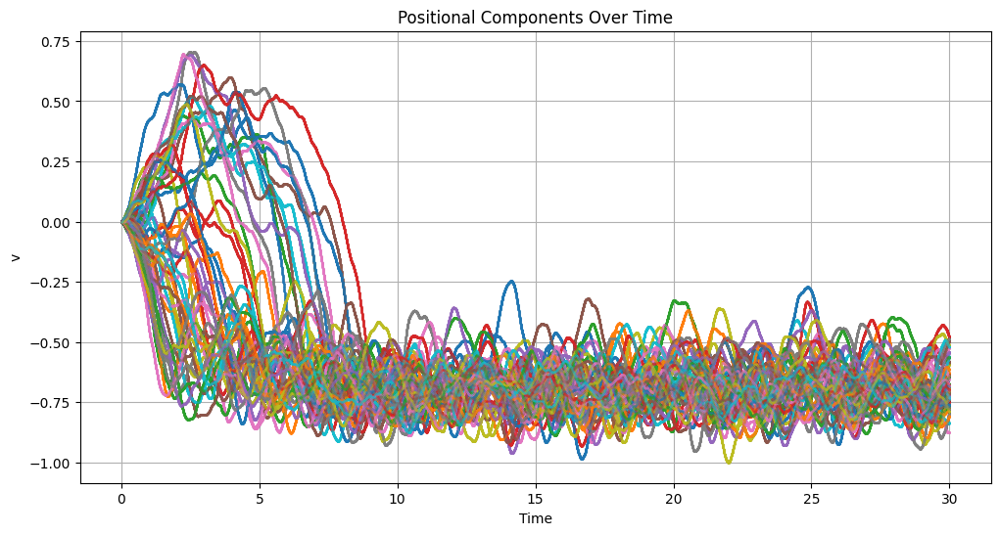

Optimising EM-based contrast estimator starts.
[1.97755158 1.62452793 0.49529248 1.95331037]
Likelihood value and gradient with estimated parameters:
(Array(-60721.227, dtype=float32), Array([-2.877065e-05,  1.936853e-04, -7.754060e-02,  8.850533e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00445032 1.5395335  0.49905398 1.97945511]
Likelihood value and gradient with estimated parameters:
(Array(-1926210.8, dtype=float32), Array([-3.1626597e-04,  8.1753731e-04,  3.4831822e-02, -4.3802895e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 2
Compute the sample paths


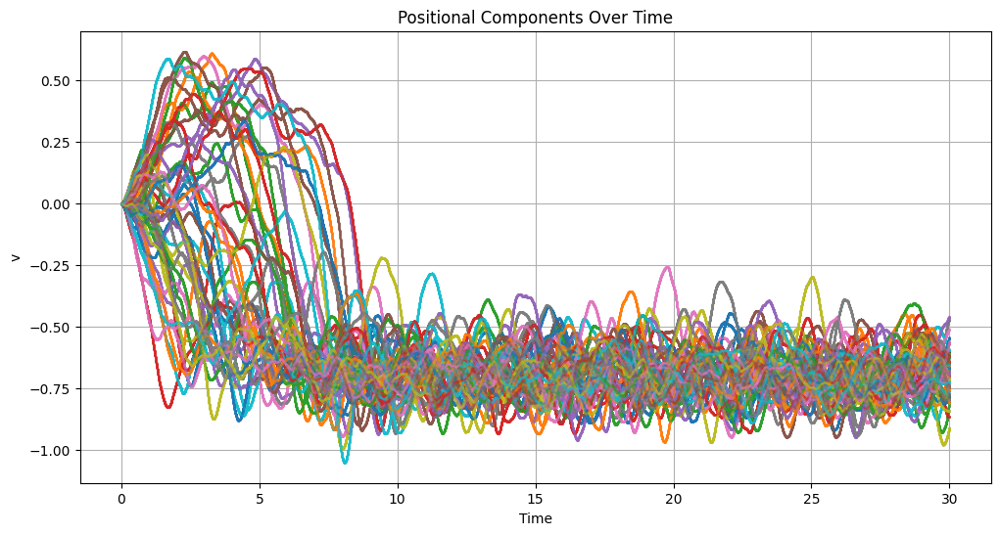

Optimising EM-based contrast estimator starts.
[1.95030725 1.62764156 0.49457172 2.04758501]
Likelihood value and gradient with estimated parameters:
(Array(-61157.723, dtype=float32), Array([ 9.3039358e-05,  7.1171671e-06, -5.6070983e-03,  2.8310518e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97583687 1.53710234 0.49809361 2.0753119 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926787., dtype=float32), Array([ 1.2965500e-04,  6.5279007e-04, -2.0479703e-01, -4.1636406e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 3
Compute the sample paths


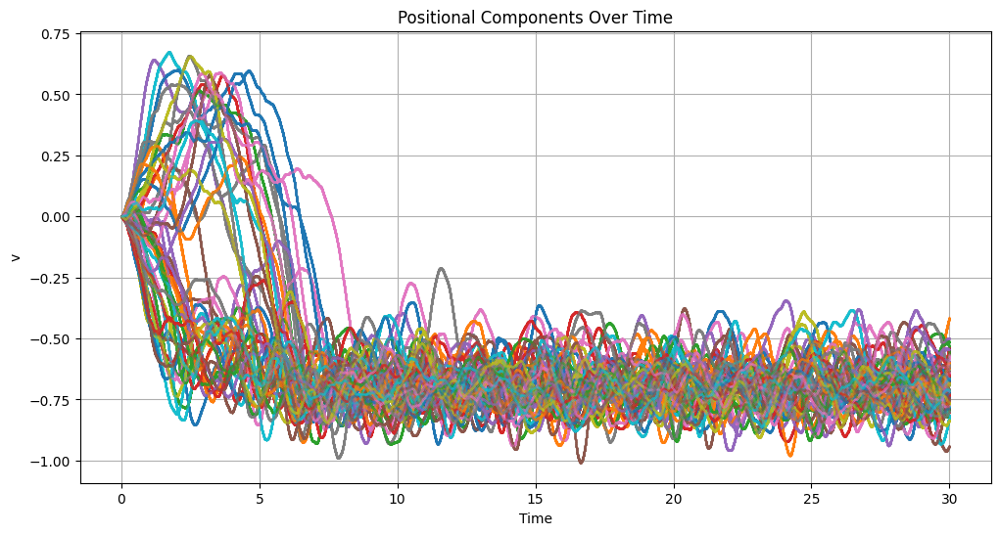

Optimising EM-based contrast estimator starts.
[2.00581622 1.55512071 0.49496821 2.05854225]
Likelihood value and gradient with estimated parameters:
(Array(-60917.535, dtype=float32), Array([ 2.0108791e-04, -1.4463812e-04,  1.0196031e-04,  5.6083605e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.03392029 1.46596181 0.49836206 2.08467889]
Likelihood value and gradient with estimated parameters:
(Array(-1926586.8, dtype=float32), Array([-4.0948391e-04,  3.6847591e-03, -1.3267249e-01, -2.2349472e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 4
Compute the sample paths


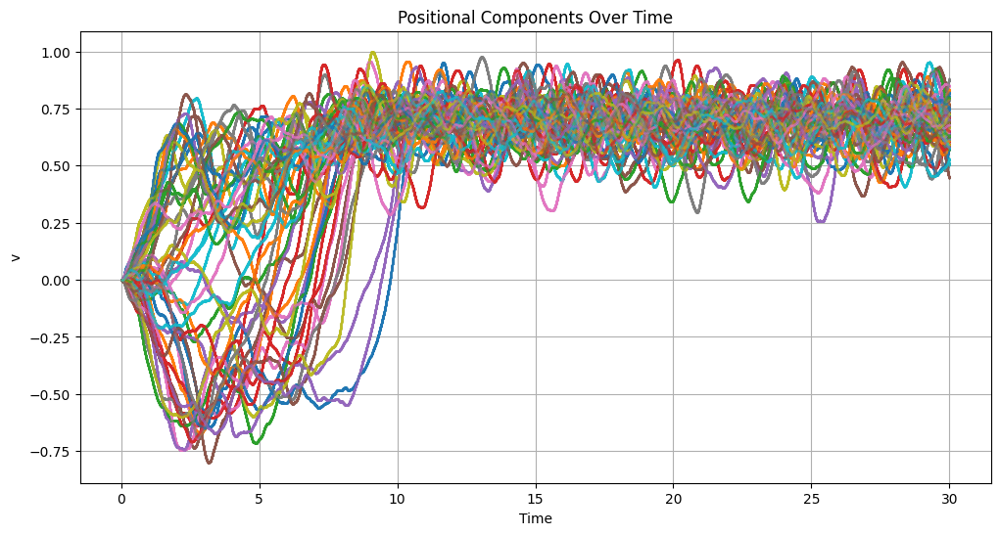

Optimising EM-based contrast estimator starts.
[1.93084693 1.59273541 0.49461353 1.95669377]
Likelihood value and gradient with estimated parameters:
(Array(-61132.39, dtype=float32), Array([ 1.49763655e-05,  2.31944025e-04,  3.78598385e-02, -1.49609405e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95752919 1.51114738 0.49814254 1.98321247]
Likelihood value and gradient with estimated parameters:
(Array(-1926744., dtype=float32), Array([-1.1296570e-04, -1.3966560e-03,  4.2992616e-01, -3.6828220e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 5
Compute the sample paths


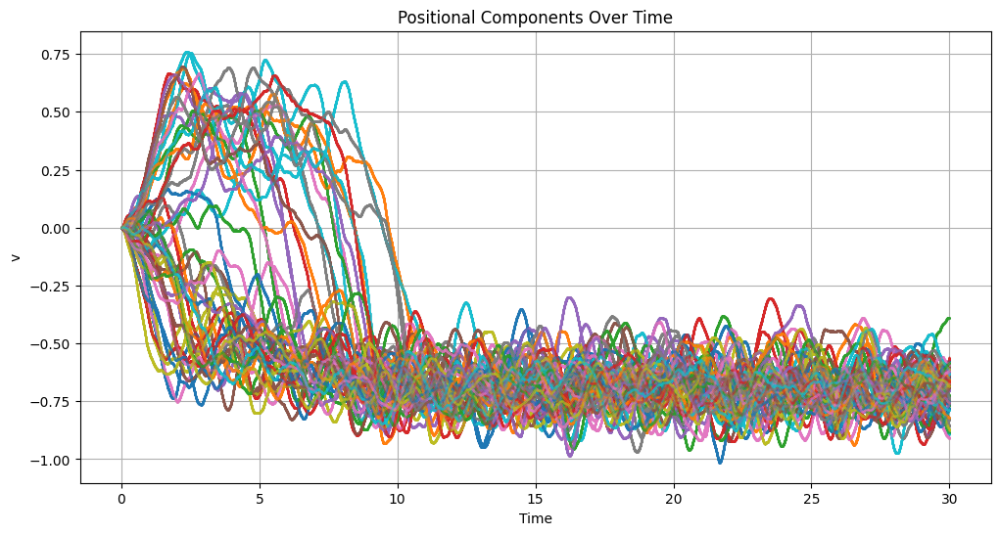

Optimising EM-based contrast estimator starts.
[1.97121203 1.62308049 0.49577227 1.93553305]
Likelihood value and gradient with estimated parameters:
(Array(-60431.094, dtype=float32), Array([-5.2353600e-05,  2.0861626e-05, -4.5994497e-03, -1.5425729e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99786782 1.54226708 0.4994339  1.96163476]
Likelihood value and gradient with estimated parameters:
(Array(-1925983.5, dtype=float32), Array([ 4.4557080e-04, -3.1392574e-03, -8.6969566e-01,  2.0224601e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 6
Compute the sample paths


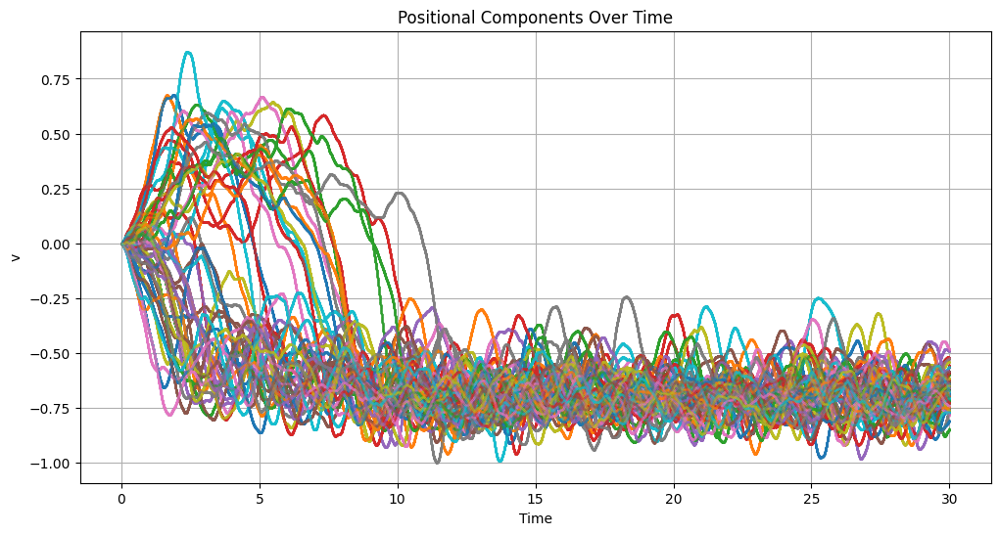

Optimising EM-based contrast estimator starts.
[1.93932855 1.59300387 0.49435711 1.88232327]
Likelihood value and gradient with estimated parameters:
(Array(-61287.758, dtype=float32), Array([ 1.7450762e-04, -2.8706342e-04, -1.3104582e-02, -9.9762314e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9665246  1.51685095 0.49795803 1.90723932]
Likelihood value and gradient with estimated parameters:
(Array(-1926856.5, dtype=float32), Array([ 1.6143918e-04, -2.1307468e-03, -3.1179076e-01, -5.7680532e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 7
Compute the sample paths


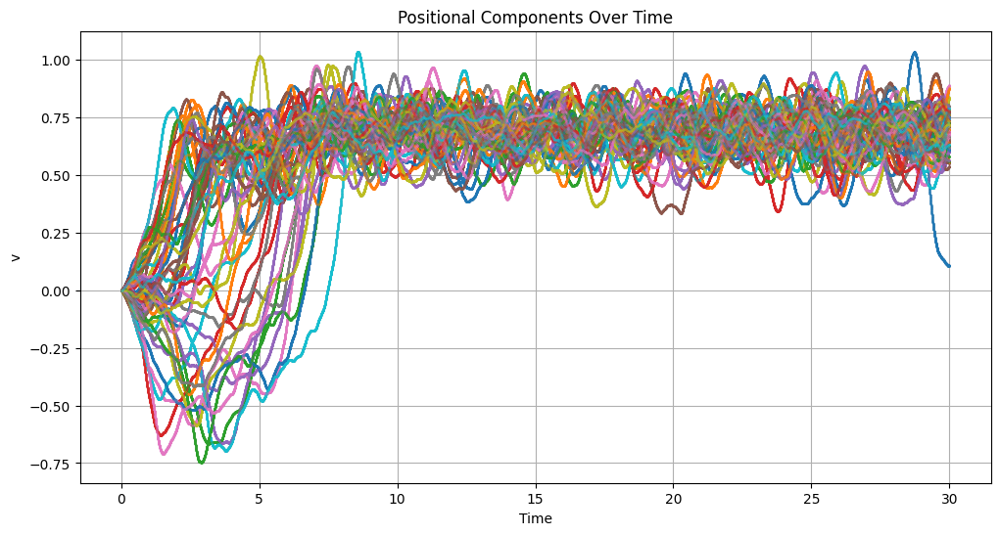

Optimising EM-based contrast estimator starts.
[2.0434556  1.65275609 0.49406683 1.93609953]
Likelihood value and gradient with estimated parameters:
(Array(-61463.812, dtype=float32), Array([ 2.4243724e-05, -1.5103817e-04, -1.2250650e-02, -1.1085067e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.07180667 1.55543375 0.49726185 1.9633075 ]
Likelihood value and gradient with estimated parameters:
(Array(-1927298.8, dtype=float32), Array([ 1.5920401e-04, -1.7131567e-03, -9.0490937e-02, -1.1866912e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 8
Compute the sample paths


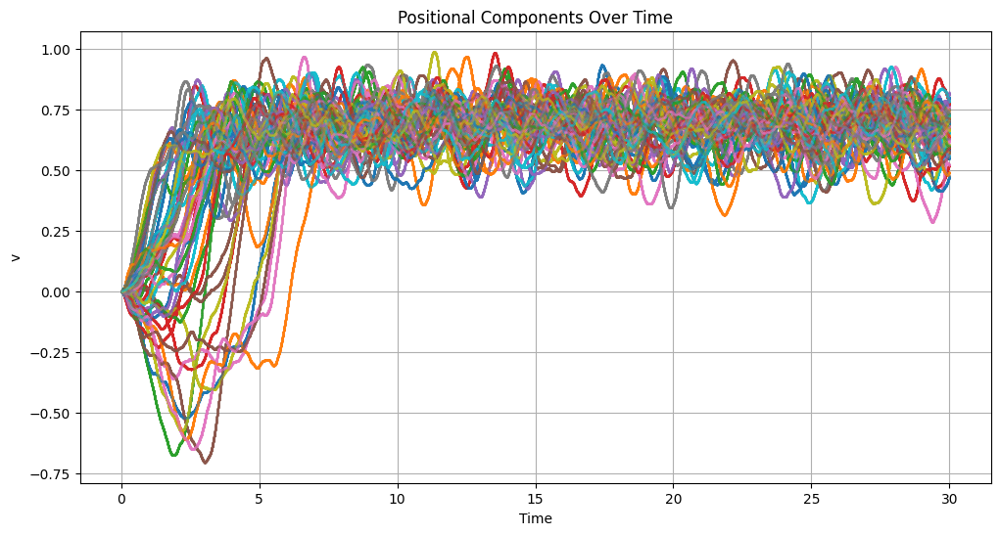

Optimising EM-based contrast estimator starts.
[1.97283566 1.66874707 0.49494269 1.97902036]
Likelihood value and gradient with estimated parameters:
(Array(-60932.996, dtype=float32), Array([ 1.0200590e-04, -3.9961189e-05,  3.2134723e-02, -1.6866252e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99958169 1.56483233 0.49795717 2.00789547]
Likelihood value and gradient with estimated parameters:
(Array(-1926884.1, dtype=float32), Array([ 1.3606250e-04, -8.7392330e-04, -3.6353838e-01, -2.7481932e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 9
Compute the sample paths


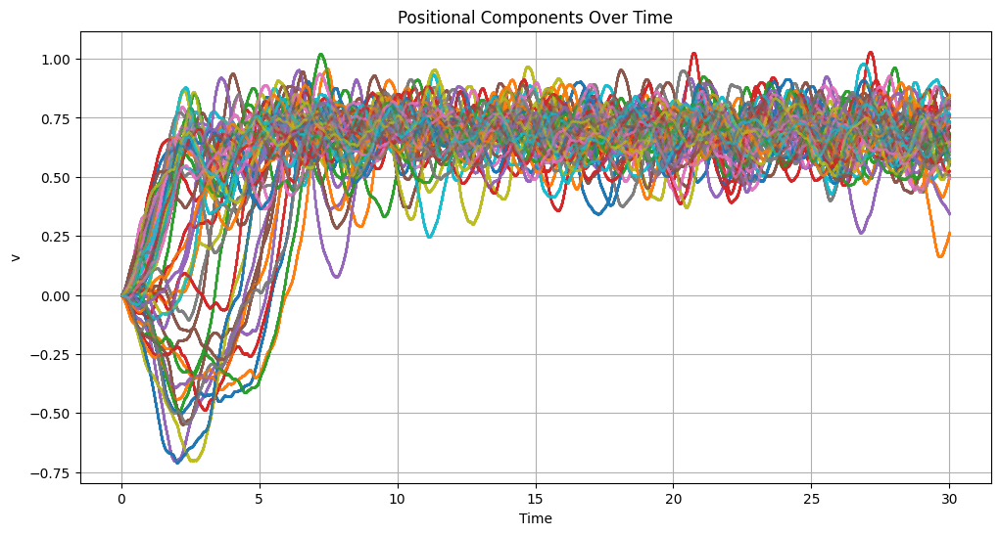

Optimising EM-based contrast estimator starts.
[1.93815398 1.57168221 0.49393332 1.87464678]
Likelihood value and gradient with estimated parameters:
(Array(-61544.812, dtype=float32), Array([1.14344235e-04, 2.18562782e-05, 9.82085913e-02, 8.13539373e-07],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96424258 1.4855653  0.49765006 1.89959228]
Likelihood value and gradient with estimated parameters:
(Array(-1927026.1, dtype=float32), Array([-1.1776388e-04, -1.2273788e-03,  9.3451679e-02, -3.3032149e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 10
Compute the sample paths


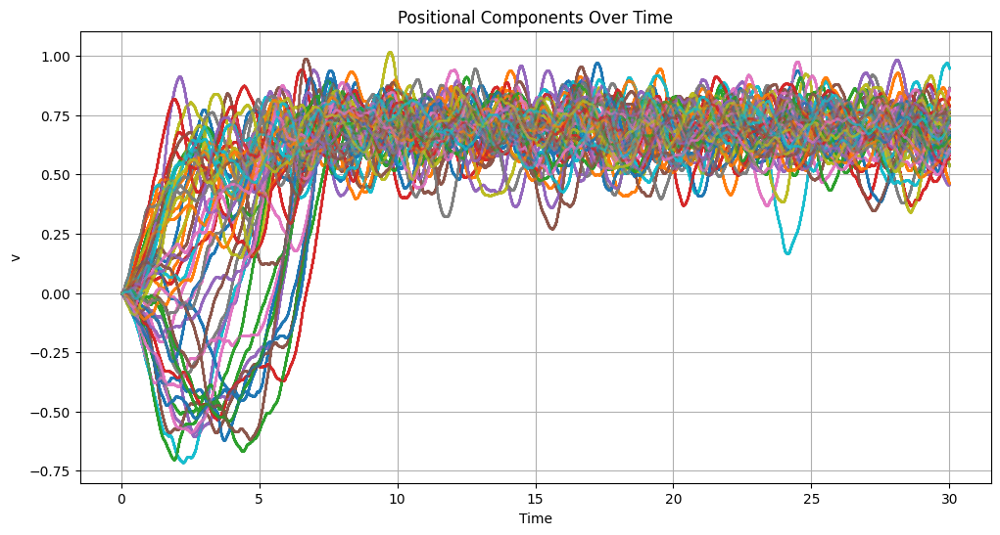

Optimising EM-based contrast estimator starts.
[1.92489052 1.60065186 0.49636784 2.01104522]
Likelihood value and gradient with estimated parameters:
(Array(-60071.28, dtype=float32), Array([ 2.1325843e-04,  8.4787607e-06,  4.7166910e-02, -3.3016782e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94989693 1.50718391 0.49962944 2.03840566]
Likelihood value and gradient with estimated parameters:
(Array(-1925847.2, dtype=float32), Array([ 6.9587119e-04, -5.2673817e-03, -7.5468326e-01,  3.2964163e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 11
Compute the sample paths


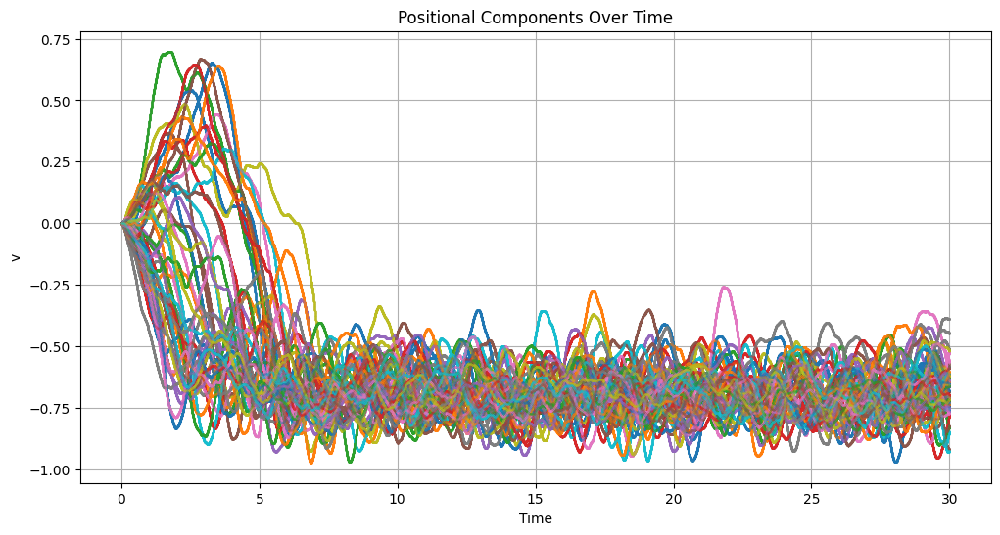

Optimising EM-based contrast estimator starts.
[1.93668365 1.62534153 0.49483216 2.09481311]
Likelihood value and gradient with estimated parameters:
(Array(-60999.938, dtype=float32), Array([-7.8839366e-05, -1.1384487e-04,  2.0433648e-03,  7.1132847e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96257293 1.53170478 0.49810845 2.12389851]
Likelihood value and gradient with estimated parameters:
(Array(-1926775.2, dtype=float32), Array([ 5.0015748e-05, -7.2574615e-04, -1.0596275e-02,  2.4857000e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 12
Compute the sample paths


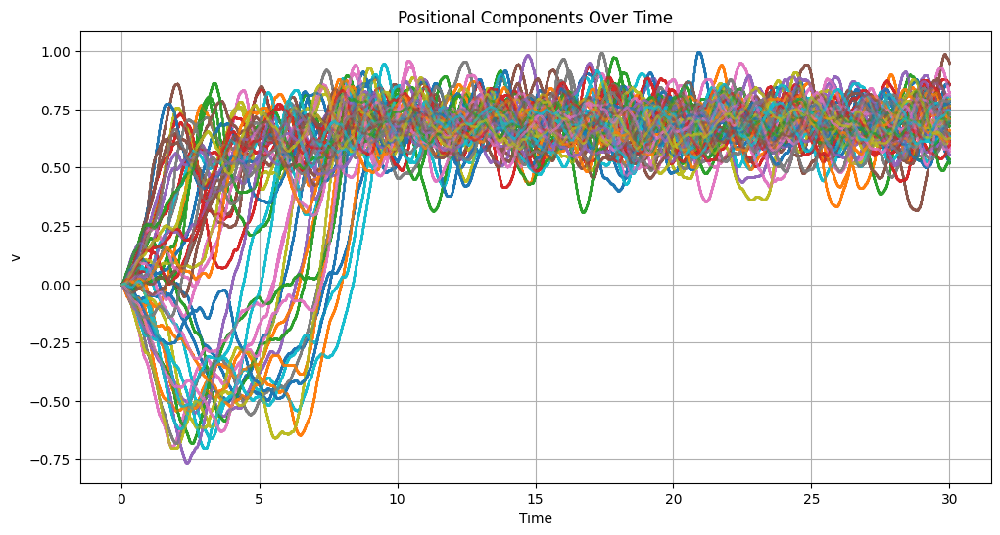

Optimising EM-based contrast estimator starts.
[1.96261799 1.67173278 0.49475059 1.8621527 ]
Likelihood value and gradient with estimated parameters:
(Array(-61049.312, dtype=float32), Array([-1.3505644e-04,  1.6793609e-04, -6.5048501e-02,  2.3911824e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99089241 1.58359814 0.49801216 1.88840365]
Likelihood value and gradient with estimated parameters:
(Array(-1926860., dtype=float32), Array([-1.4089048e-04,  6.1035156e-04, -4.0845126e-01,  1.7743558e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 13
Compute the sample paths


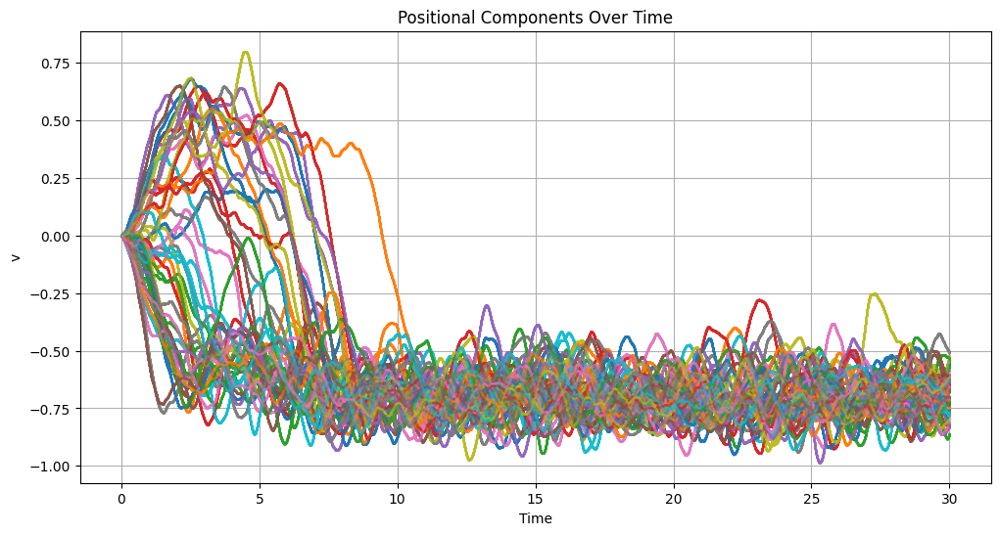

Optimising EM-based contrast estimator starts.
[1.96636975 1.68673992 0.49389634 1.86323512]
Likelihood value and gradient with estimated parameters:
(Array(-61567.273, dtype=float32), Array([ 7.3711737e-05,  5.3320080e-05, -1.8784128e-03, -2.3848144e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99432576 1.6029979  0.49767554 1.88901985]
Likelihood value and gradient with estimated parameters:
(Array(-1927075.2, dtype=float32), Array([ 2.0490587e-04, -2.9165745e-03,  8.5184908e-01,  5.0864182e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 14
Compute the sample paths


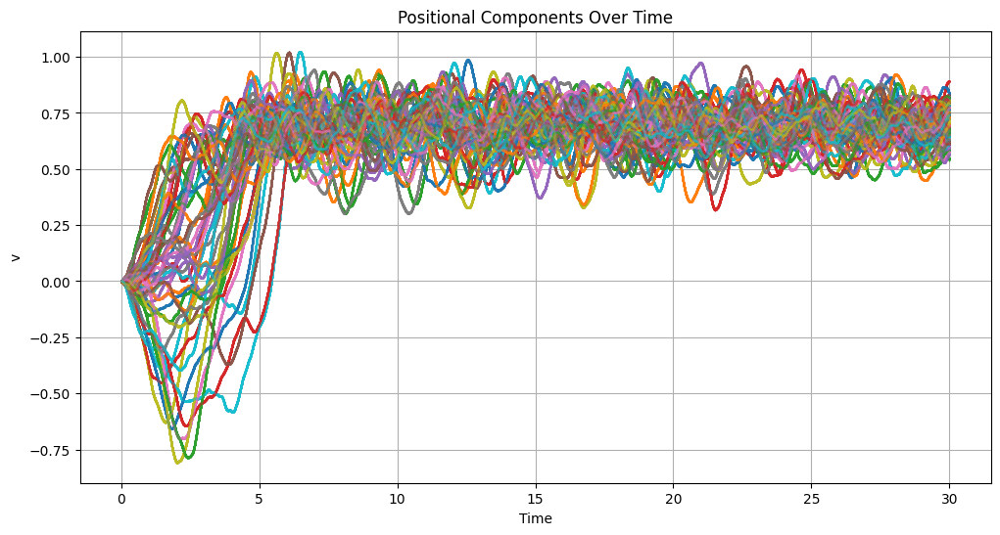

Optimising EM-based contrast estimator starts.
[1.91195238 1.61064303 0.49495628 2.20347881]
Likelihood value and gradient with estimated parameters:
(Array(-60924.75, dtype=float32), Array([ 7.3428731e-05, -1.1384487e-05, -8.8027388e-02, -3.1160715e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9364816  1.51074827 0.49828771 2.23555112]
Likelihood value and gradient with estimated parameters:
(Array(-1926656.8, dtype=float32), Array([ 4.3224916e-04, -5.9640408e-03,  4.4810748e-01, -3.6763027e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 15
Compute the sample paths


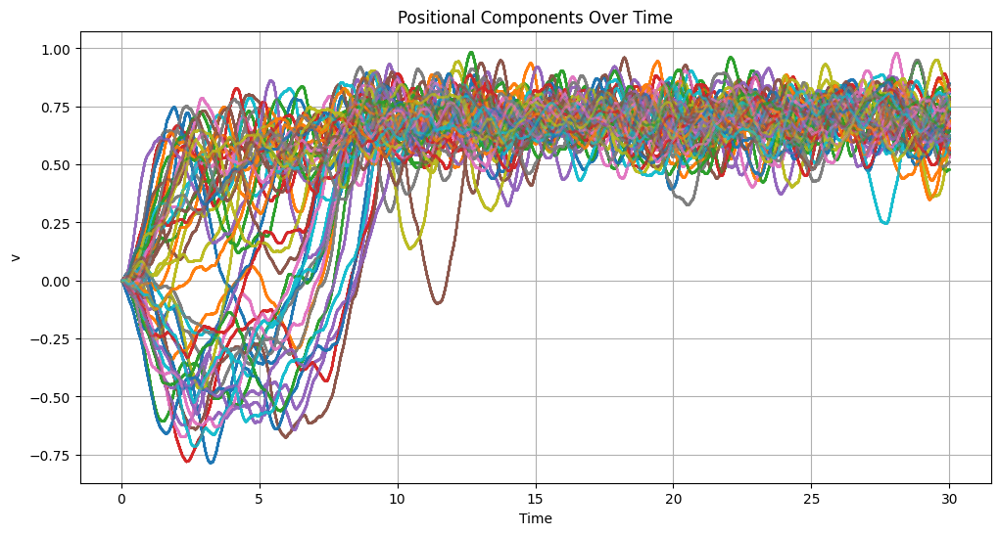

Optimising EM-based contrast estimator starts.
[1.98033631 1.65412927 0.49602863 2.00025415]
Likelihood value and gradient with estimated parameters:
(Array(-60276.113, dtype=float32), Array([-1.3061578e-04,  2.6665628e-05, -5.3814143e-02, -1.0191556e-04],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00729561 1.5725522  0.49962452 2.02779722]
Likelihood value and gradient with estimated parameters:
(Array(-1925886.6, dtype=float32), Array([ 9.7855926e-05, -1.3434887e-03,  2.2443411e-01, -5.7143625e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 16
Compute the sample paths


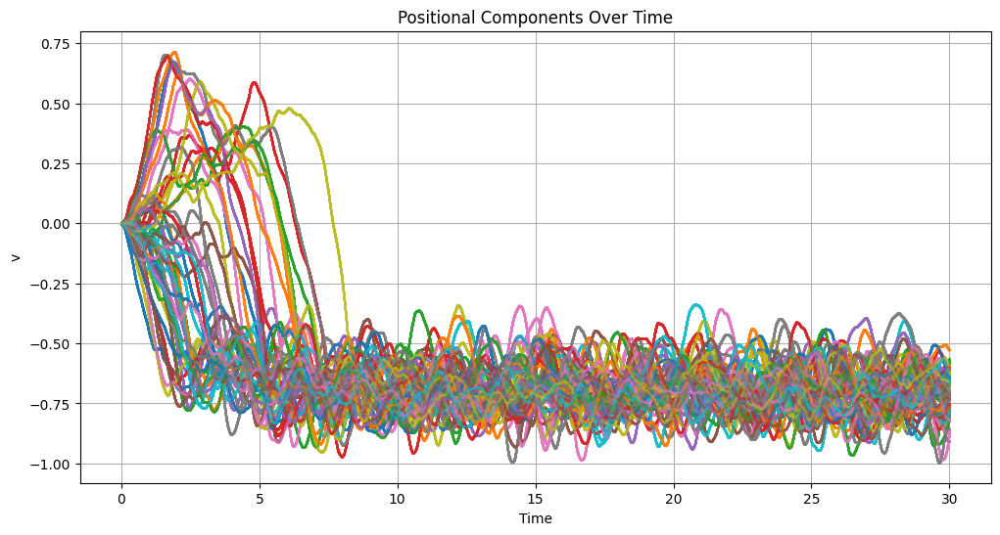

Optimising EM-based contrast estimator starts.
[2.01106453 1.59879065 0.49627745 1.9637444 ]
Likelihood value and gradient with estimated parameters:
(Array(-60125.832, dtype=float32), Array([ 2.5934062e-04,  2.3737550e-05, -5.1353302e-02,  1.2978795e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.03674579 1.49908721 0.49947408 1.9900614 ]
Likelihood value and gradient with estimated parameters:
(Array(-1925936.2, dtype=float32), Array([-1.0827184e-04,  1.1551380e-04, -9.2737055e-01, -2.1174550e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 17
Compute the sample paths


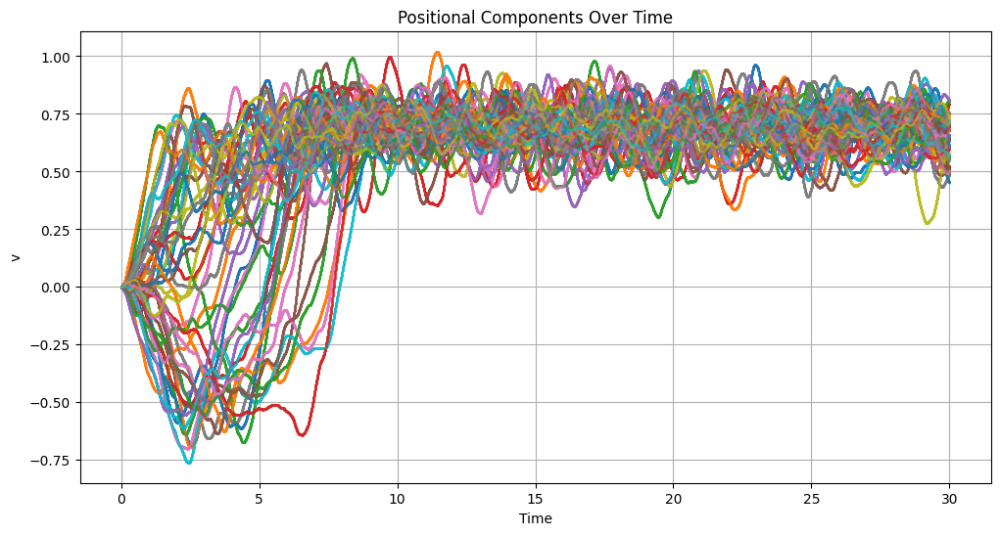

Optimising EM-based contrast estimator starts.
[2.01333928 1.56280446 0.49293971 1.98562598]
Likelihood value and gradient with estimated parameters:
(Array(-62148.336, dtype=float32), Array([ 3.845070e-05, -9.787083e-05,  4.174711e-02, -6.670598e-07],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.04238725 1.47503269 0.49645719 2.01145101]
Likelihood value and gradient with estimated parameters:
(Array(-1927739., dtype=float32), Array([ 4.9132109e-04, -5.9883595e-03,  2.6353359e-02, -3.3430755e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 18
Compute the sample paths


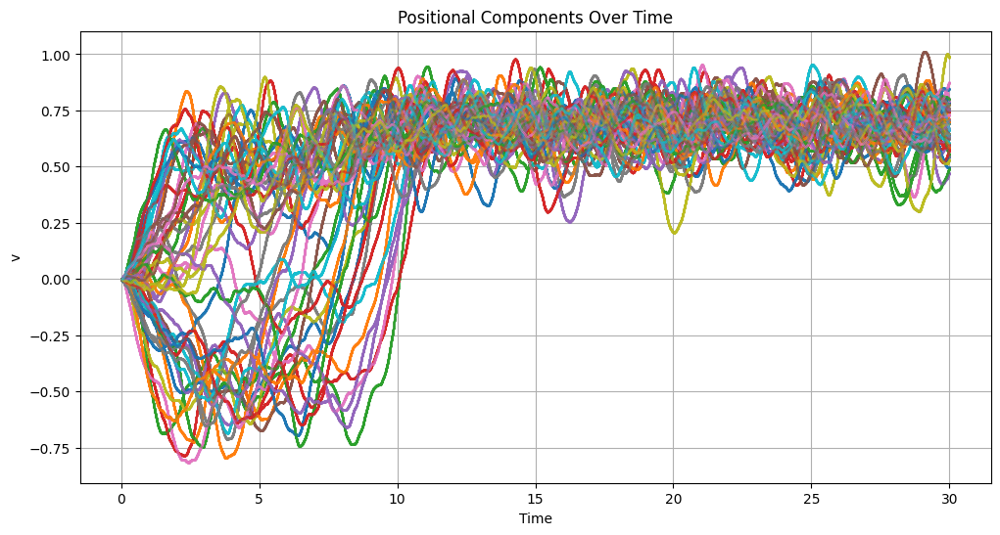

Optimising EM-based contrast estimator starts.
[1.97586715 1.57352698 0.49567351 1.89672661]
Likelihood value and gradient with estimated parameters:
(Array(-60490.805, dtype=float32), Array([ 1.5725964e-04, -1.6652048e-04, -1.9384937e-02,  5.9252488e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00334024 1.49901438 0.4994593  1.92191339]
Likelihood value and gradient with estimated parameters:
(Array(-1925945.2, dtype=float32), Array([-1.43095851e-04,  4.01258469e-04,  4.93754089e-01, -1.29307155e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 19
Compute the sample paths


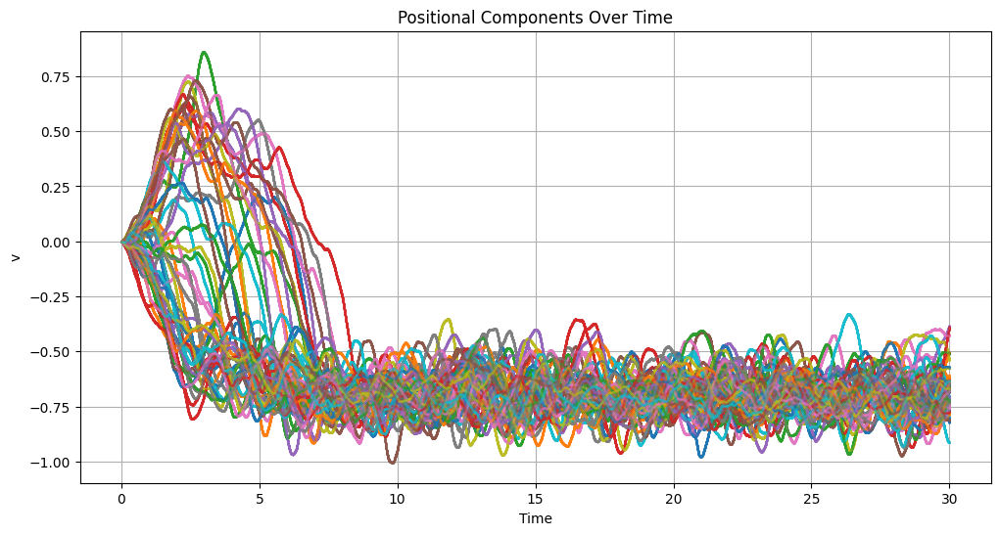

Optimising EM-based contrast estimator starts.
[2.00427532 1.66256773 0.4948324  1.99315667]
Likelihood value and gradient with estimated parameters:
(Array(-60999.777, dtype=float32), Array([ 1.5141210e-04, -1.3900548e-04, -3.0198397e-02,  1.2382981e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.03191447 1.56843305 0.49817672 2.02088976]
Likelihood value and gradient with estimated parameters:
(Array(-1926754.5, dtype=float32), Array([ 8.7730587e-05, -4.3435097e-03,  3.0438110e-01, -9.0420246e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 20
Compute the sample paths


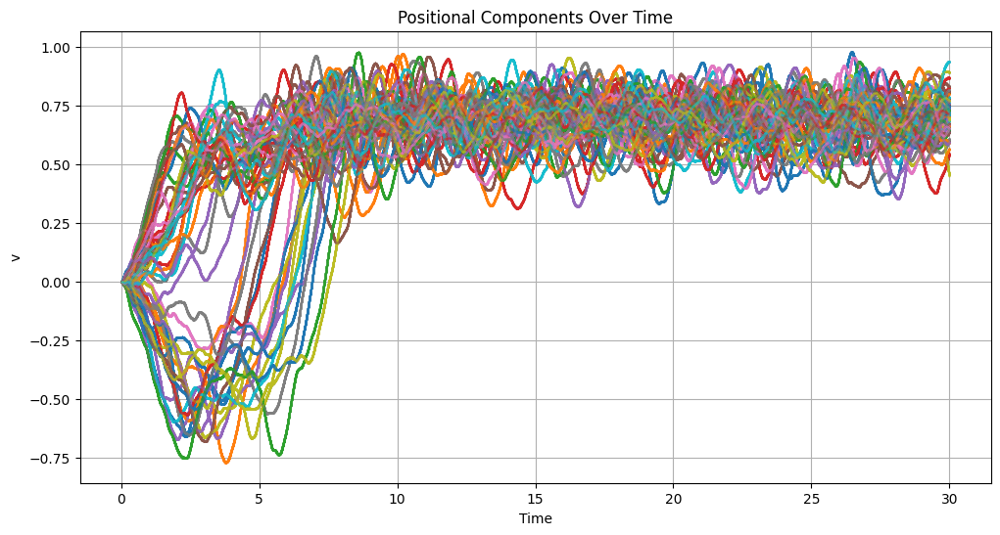

Optimising EM-based contrast estimator starts.
[1.94338548 1.58588684 0.49375024 1.90408111]
Likelihood value and gradient with estimated parameters:
(Array(-61655.938, dtype=float32), Array([ 4.0419167e-05, -2.8811395e-05,  1.4487941e-02,  7.2458992e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96818697 1.50011039 0.49728125 1.92942429]
Likelihood value and gradient with estimated parameters:
(Array(-1927257., dtype=float32), Array([-9.4705820e-04,  2.8252602e-03,  8.5018635e-01, -1.1788402e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 21
Compute the sample paths


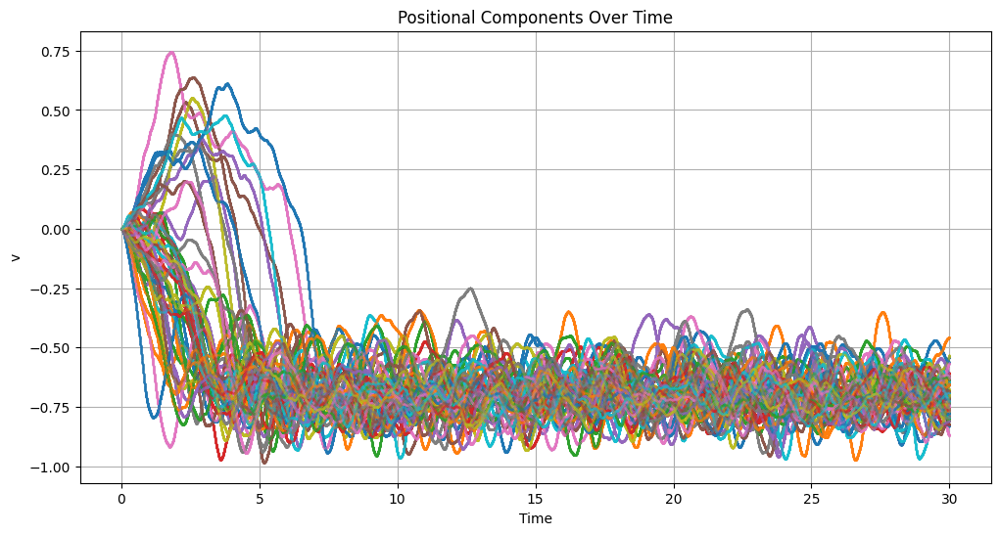

Optimising EM-based contrast estimator starts.
[2.0026195  1.59858727 0.49573645 1.89888418]
Likelihood value and gradient with estimated parameters:
(Array(-60452.75, dtype=float32), Array([-2.0907179e-04,  8.5897744e-05,  2.1435443e-02, -1.3728568e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.03089356 1.50217199 0.49906918 1.92294133]
Likelihood value and gradient with estimated parameters:
(Array(-1926181.9, dtype=float32), Array([ 1.0037422e-04, -6.6614151e-04,  2.9081398e-01,  5.5243727e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 22
Compute the sample paths


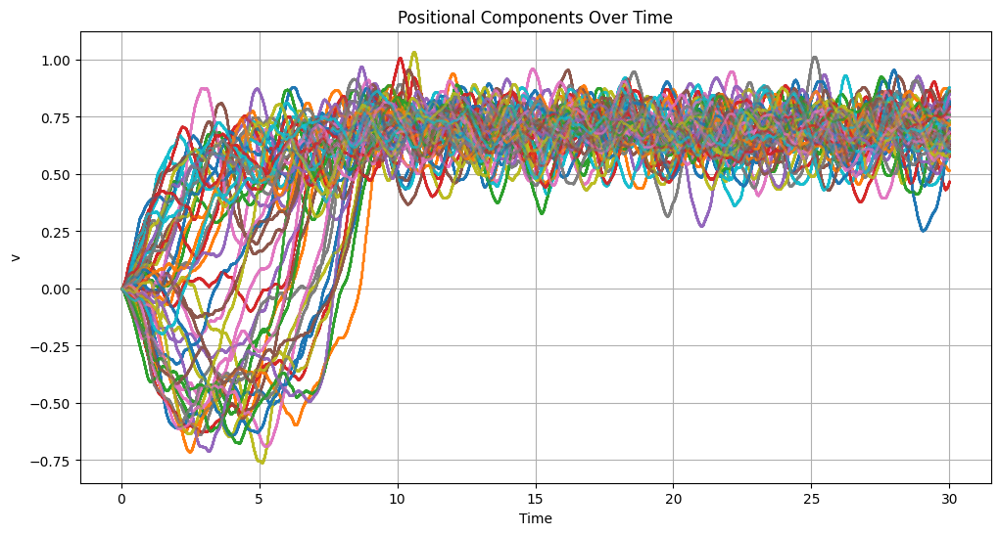

Optimising EM-based contrast estimator starts.
[1.99672318 1.65118265 0.49400994 1.97635758]
Likelihood value and gradient with estimated parameters:
(Array(-61498.32, dtype=float32), Array([-2.0369072e-05,  2.6732683e-05, -5.1088750e-02,  6.7965302e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.02433658 1.56395733 0.49765107 2.0038693 ]
Likelihood value and gradient with estimated parameters:
(Array(-1927067.9, dtype=float32), Array([ 7.4420124e-05, -5.9890747e-04,  4.2517591e-01,  4.4070184e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 23
Compute the sample paths


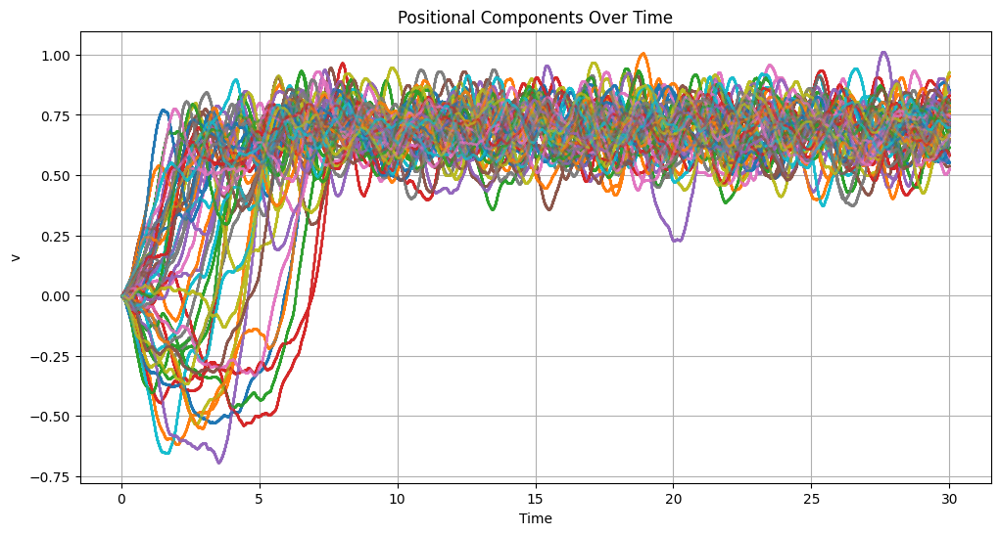

Optimising EM-based contrast estimator starts.
[1.90362406 1.57932842 0.49441269 1.95262194]
Likelihood value and gradient with estimated parameters:
(Array(-61254.074, dtype=float32), Array([ 6.8397203e-05,  1.7496571e-04, -4.9687587e-02, -5.3293770e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9290632  1.49009538 0.49783695 1.97830069]
Likelihood value and gradient with estimated parameters:
(Array(-1926915.8, dtype=float32), Array([8.863956e-05, 7.452965e-04, 6.839627e-02, 3.259629e-07], dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 24
Compute the sample paths


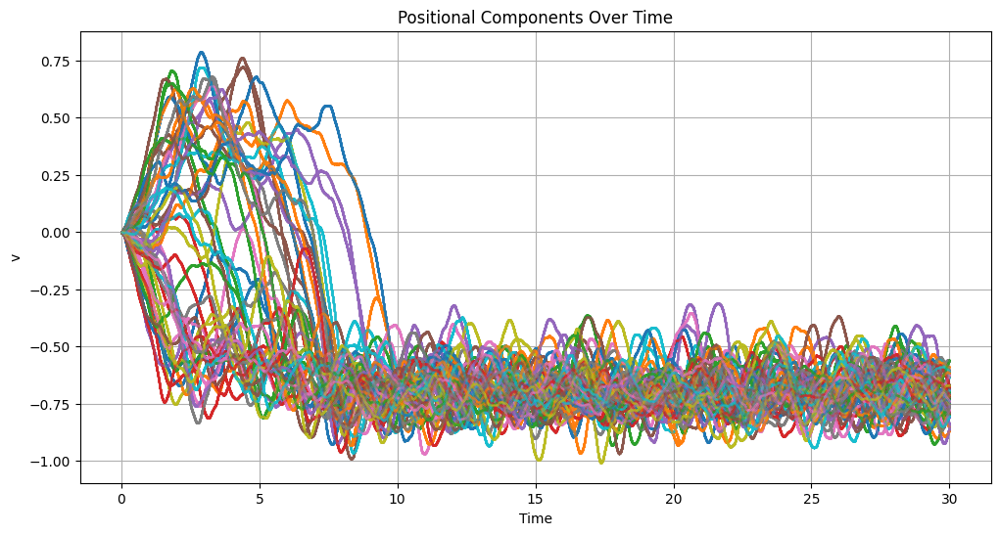

Optimising EM-based contrast estimator starts.
[2.00560832 1.59620321 0.4952392  2.03009939]
Likelihood value and gradient with estimated parameters:
(Array(-60753.492, dtype=float32), Array([-2.0456966e-05, -7.8041106e-05, -1.0541667e-03,  4.1264633e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.0342741  1.5056864  0.49850529 2.05715895]
Likelihood value and gradient with estimated parameters:
(Array(-1926522.1, dtype=float32), Array([ 3.9100647e-05, -3.2353401e-03,  2.2208238e-01, -4.7730282e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 25
Compute the sample paths


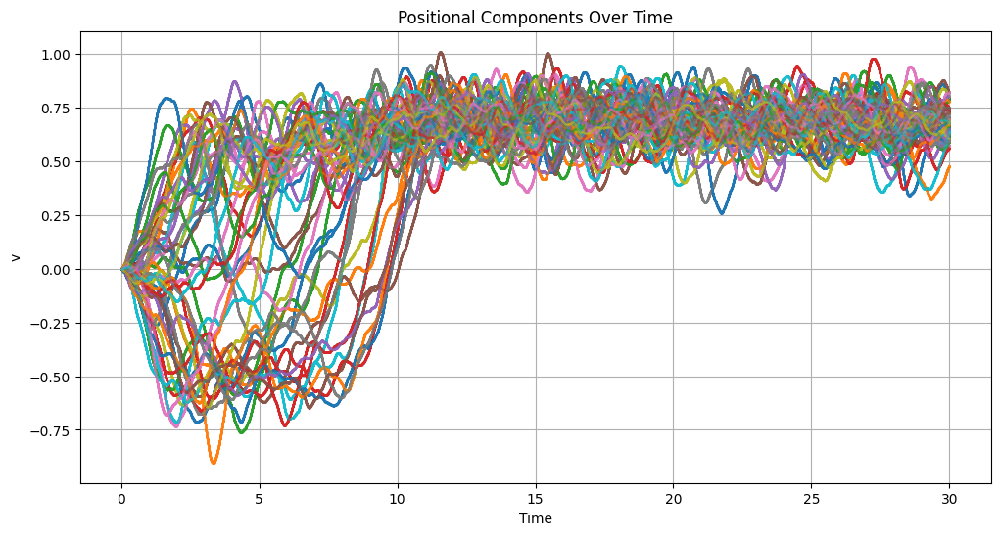

Optimising EM-based contrast estimator starts.
[1.96925092 1.61925173 0.49337047 1.84461308]
Likelihood value and gradient with estimated parameters:
(Array(-61886.492, dtype=float32), Array([ 2.5064219e-06, -3.5226345e-05, -1.4077801e-03,  1.3425015e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99648643 1.54372132 0.49701491 1.86959672]
Likelihood value and gradient with estimated parameters:
(Array(-1927440.2, dtype=float32), Array([ 2.5911629e-04, -3.2522678e-03,  3.8318098e-01, -6.9704838e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 26
Compute the sample paths


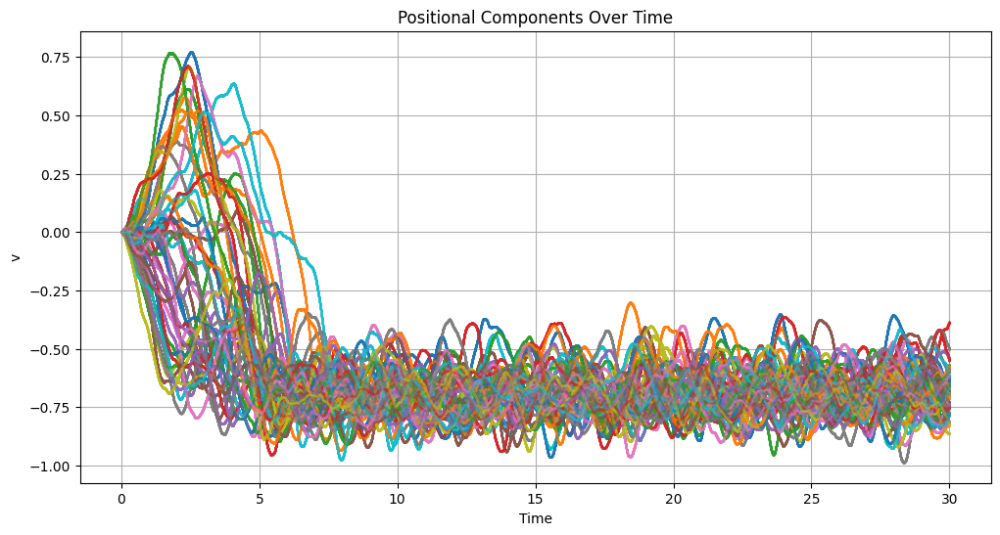

Optimising EM-based contrast estimator starts.
[1.89354169 1.58886993 0.49467799 2.11451745]
Likelihood value and gradient with estimated parameters:
(Array(-61093.32, dtype=float32), Array([4.0156534e-05, 5.0321221e-05, 1.0548592e-02, 1.6908743e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.92000854 1.50229764 0.49829918 2.14258075]
Likelihood value and gradient with estimated parameters:
(Array(-1926644.8, dtype=float32), Array([-1.7535686e-04,  3.4070015e-03,  1.6058686e-01,  2.6729889e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 27
Compute the sample paths


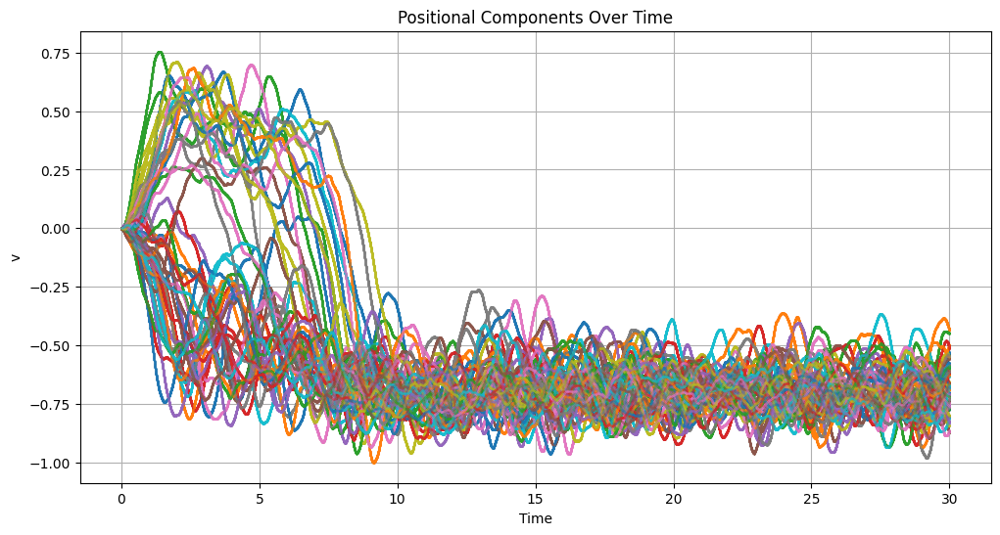

Optimising EM-based contrast estimator starts.
[1.93974245 1.60019743 0.49478132 2.04726505]
Likelihood value and gradient with estimated parameters:
(Array(-61030.727, dtype=float32), Array([-2.0759180e-06,  9.3048438e-06,  3.1088039e-02, -3.0312454e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96627784 1.50932634 0.4978343  2.0746417 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926927.4, dtype=float32), Array([-3.8310885e-05,  1.1421442e-03, -6.0560346e-02, -5.4701231e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 28
Compute the sample paths


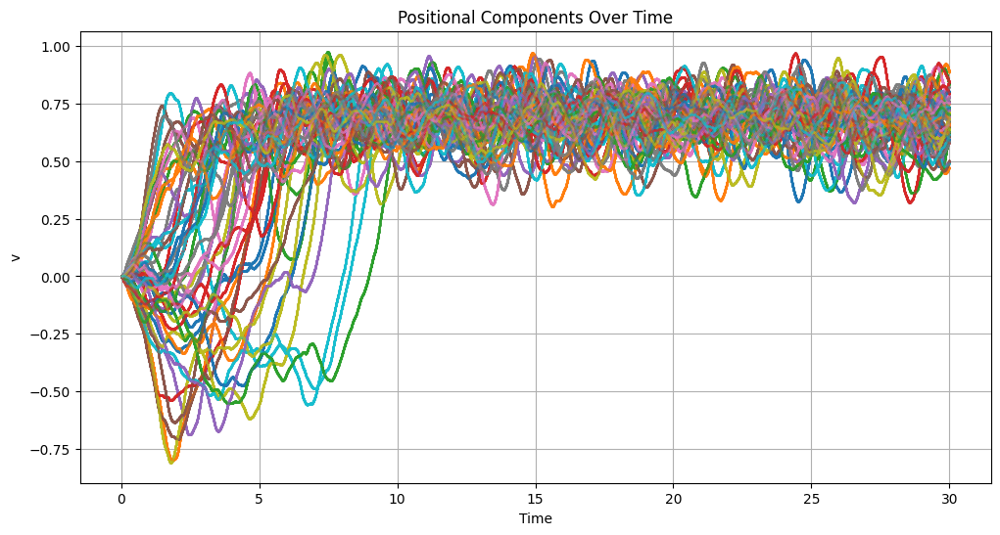

Optimising EM-based contrast estimator starts.
[2.00367594 1.52553844 0.49635145 1.89244306]
Likelihood value and gradient with estimated parameters:
(Array(-60081.19, dtype=float32), Array([-8.8961562e-05, -4.3641776e-05,  1.1040594e-01, -1.8686536e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.02860355 1.42789221 0.49909052 1.91620672]
Likelihood value and gradient with estimated parameters:
(Array(-1926128., dtype=float32), Array([-5.4790382e-04,  5.6676865e-03,  1.5459621e-01,  1.1513708e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 29
Compute the sample paths


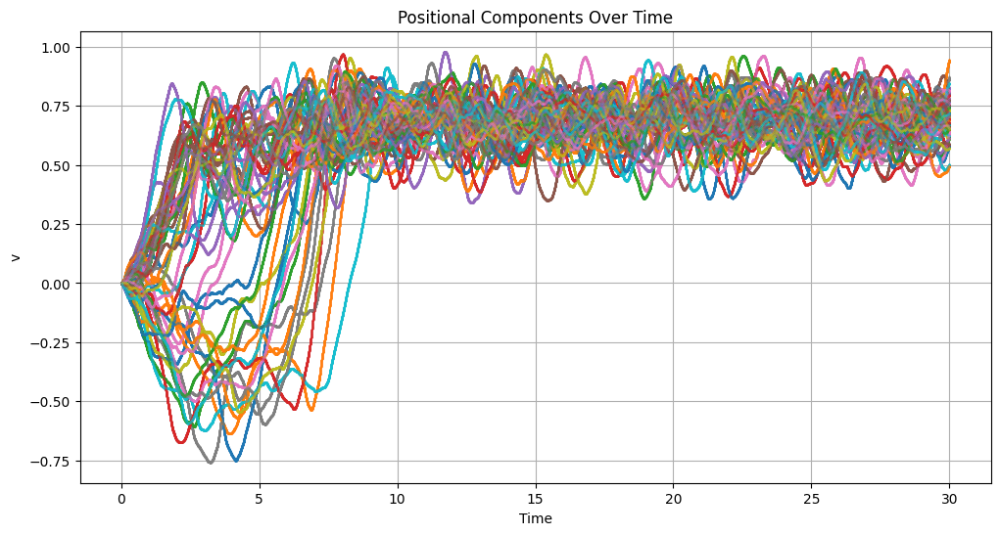

Optimising EM-based contrast estimator starts.
[1.94699872 1.60682368 0.49550647 1.93325734]
Likelihood value and gradient with estimated parameters:
(Array(-60591.812, dtype=float32), Array([-1.2545311e-04, -1.1777878e-04,  1.2687070e-02,  2.5924412e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97284877 1.52217984 0.49920276 1.95904958]
Likelihood value and gradient with estimated parameters:
(Array(-1926112.2, dtype=float32), Array([ 3.7336722e-04, -4.7779083e-04, -1.5223944e-01,  4.3277629e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 30
Compute the sample paths


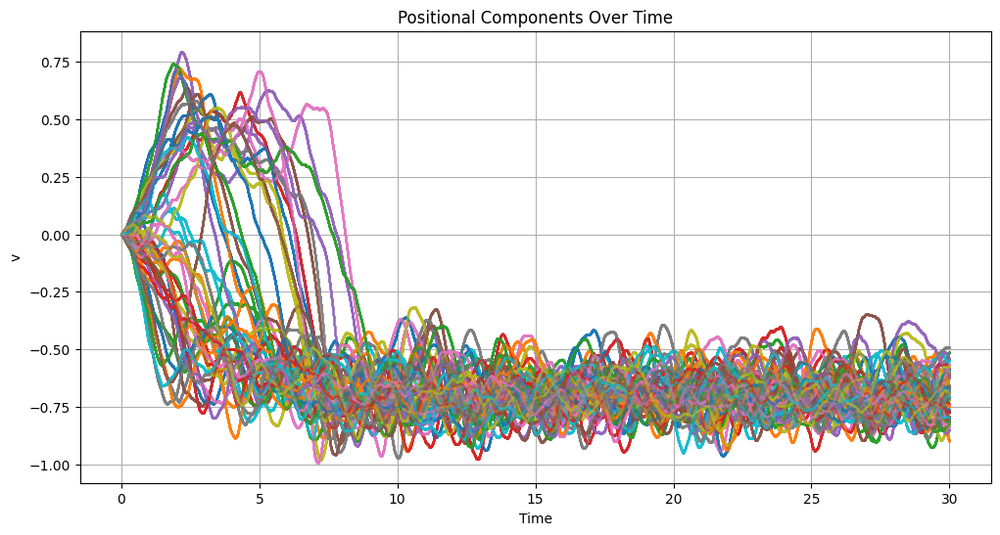

Optimising EM-based contrast estimator starts.
[1.94565701 1.69241571 0.49490598 1.93847382]
Likelihood value and gradient with estimated parameters:
(Array(-60955.24, dtype=float32), Array([ 2.1400221e-05,  9.4261020e-05,  5.0573505e-02, -4.0822633e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97317231 1.60436296 0.49835974 1.96632433]
Likelihood value and gradient with estimated parameters:
(Array(-1926664.5, dtype=float32), Array([ 1.7209165e-04, -1.9252300e-03,  3.1068289e-01,  1.6147271e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 31
Compute the sample paths


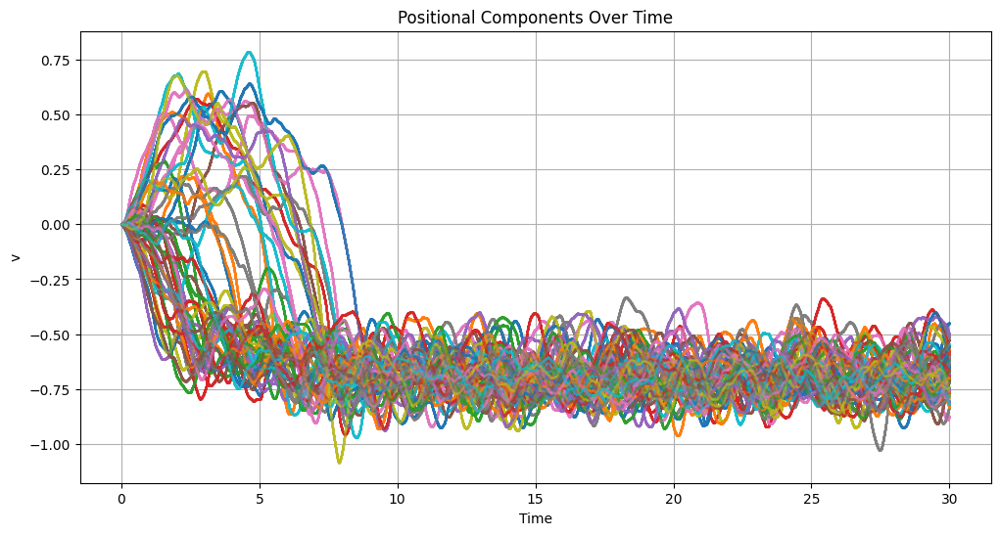

Optimising EM-based contrast estimator starts.
[1.92439318 1.64975345 0.4935931  1.97997797]
Likelihood value and gradient with estimated parameters:
(Array(-61751.32, dtype=float32), Array([ 8.8117551e-05, -5.8200210e-05, -2.0772243e-02,  7.9764286e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94839442 1.55749094 0.49676573 2.00774312]
Likelihood value and gradient with estimated parameters:
(Array(-1927597.9, dtype=float32), Array([-9.3221664e-05,  7.5352192e-04, -3.5586774e-01, -1.3827812e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 32
Compute the sample paths


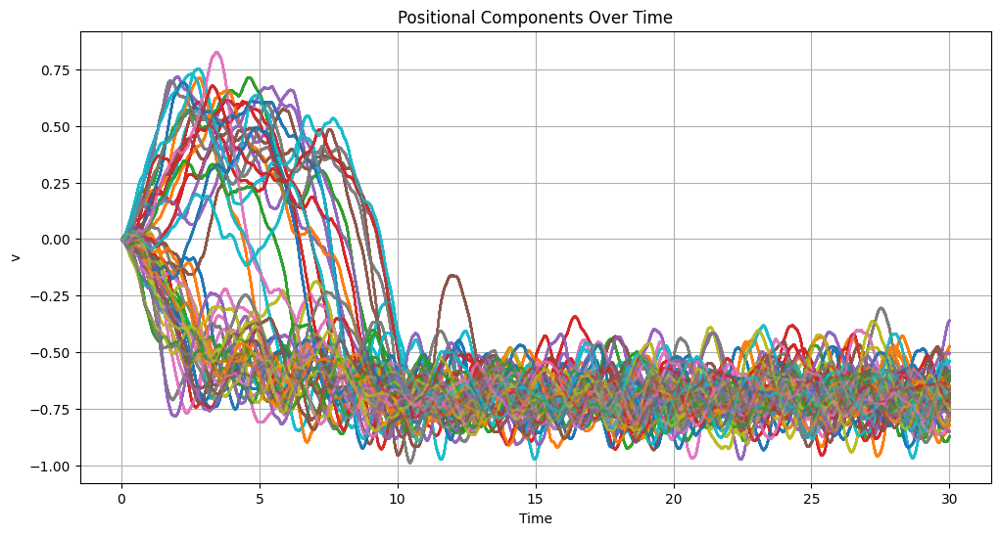

Optimising EM-based contrast estimator starts.
[1.98417854 1.64837408 0.49667966 1.88571334]
Likelihood value and gradient with estimated parameters:
(Array(-59883.055, dtype=float32), Array([ 1.3215956e-04, -3.8668513e-05,  7.9688452e-02, -5.2500029e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.01122642 1.56205213 0.49975392 1.91162288]
Likelihood value and gradient with estimated parameters:
(Array(-1925803., dtype=float32), Array([-6.7236833e-05,  9.0003014e-05,  5.6683064e-02,  2.7002301e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 33
Compute the sample paths


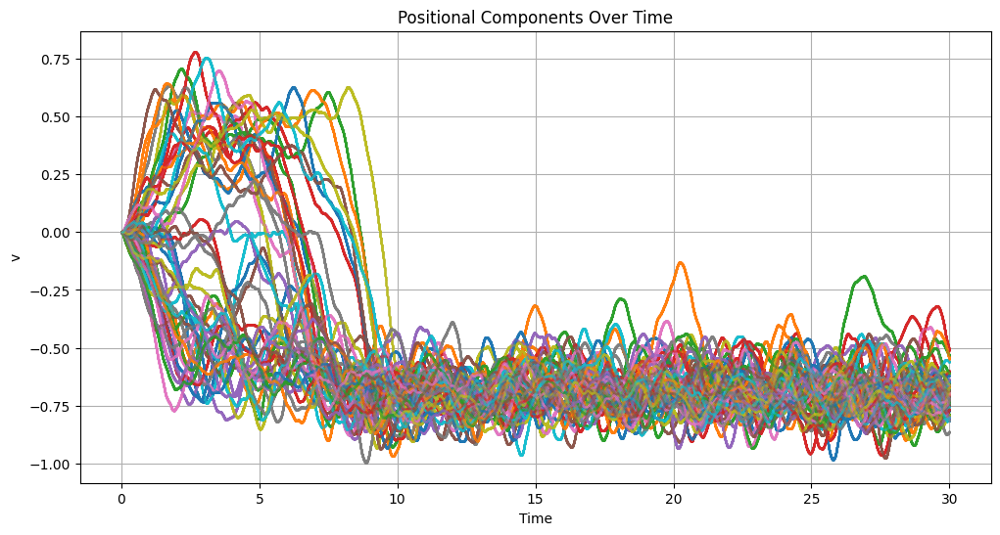

Optimising EM-based contrast estimator starts.
[1.92321742 1.69917083 0.49597624 1.94996619]
Likelihood value and gradient with estimated parameters:
(Array(-60307.79, dtype=float32), Array([ 1.1462363e-04, -2.7209520e-05, -5.7903215e-02, -4.1880907e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95083392 1.61643958 0.49936125 1.97810698]
Likelihood value and gradient with estimated parameters:
(Array(-1926069.5, dtype=float32), Array([-3.4924783e-04,  2.4743080e-03,  1.0850009e-01, -2.4154782e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 34
Compute the sample paths


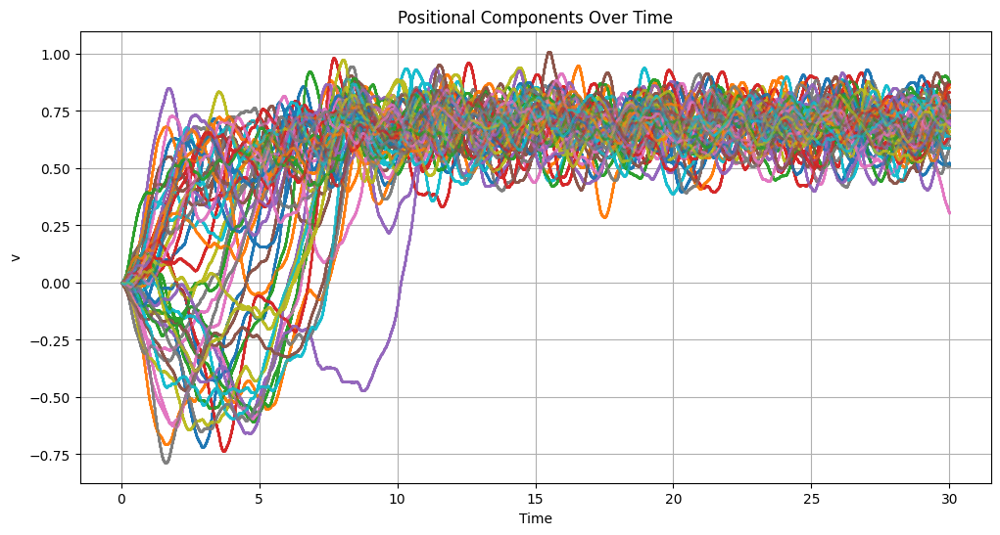

Optimising EM-based contrast estimator starts.
[1.91627407 1.62665308 0.49655133 2.01152349]
Likelihood value and gradient with estimated parameters:
(Array(-59960.5, dtype=float32), Array([-3.5172037e-05,  1.4815480e-04, -7.1024664e-02,  1.1762808e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94384348 1.54971182 0.50026417 2.03935003]
Likelihood value and gradient with estimated parameters:
(Array(-1925492.1, dtype=float32), Array([ 7.1394444e-04, -4.8422813e-03, -1.9472986e-01, -7.8855082e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 35
Compute the sample paths


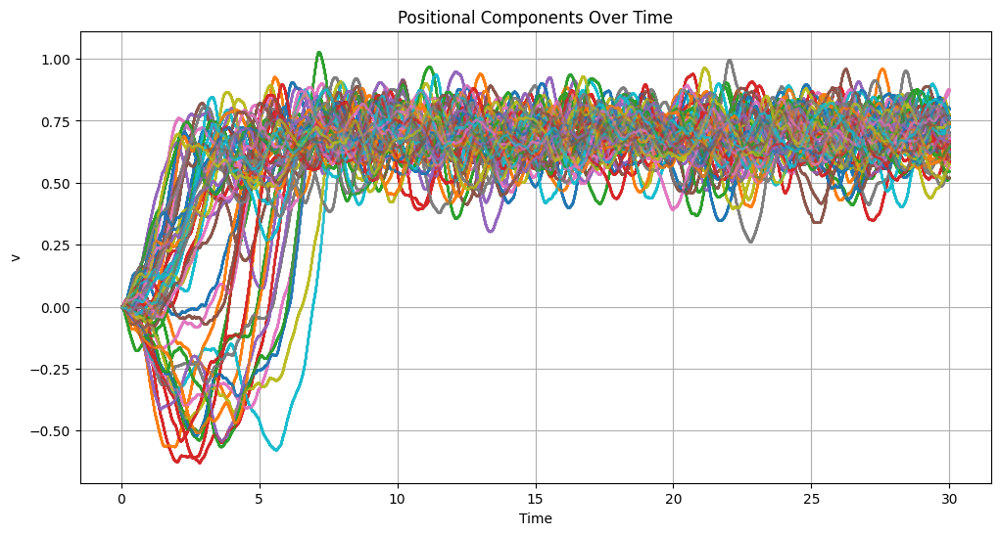

Optimising EM-based contrast estimator starts.
[1.92766941 1.65673101 0.49509251 1.96921778]
Likelihood value and gradient with estimated parameters:
(Array(-60842.28, dtype=float32), Array([-1.0572653e-04,  1.0982156e-05, -3.4373029e-04, -3.8991682e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95438302 1.56017852 0.49820256 1.99677134]
Likelihood value and gradient with estimated parameters:
(Array(-1926734.4, dtype=float32), Array([-2.1830574e-04,  3.1619072e-03,  2.1820724e-01,  5.4581964e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 36
Compute the sample paths


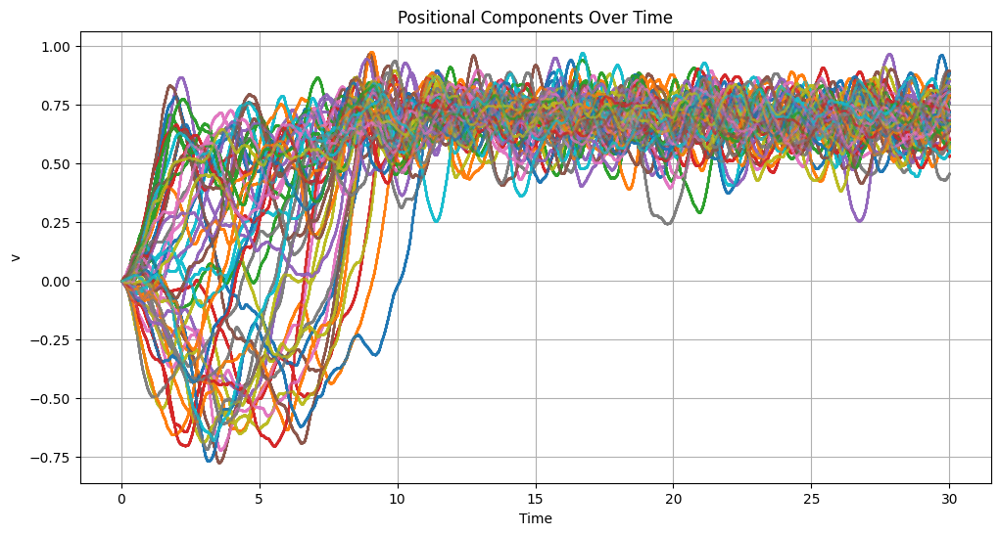

Optimising EM-based contrast estimator starts.
[1.95181775 1.60724521 0.49358198 2.03061128]
Likelihood value and gradient with estimated parameters:
(Array(-61758.074, dtype=float32), Array([ 6.7969318e-05, -3.1620264e-05, -8.5105537e-04,  1.2460281e-04],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9793992  1.52355075 0.49681911 2.0585053 ]
Likelihood value and gradient with estimated parameters:
(Array(-1927547.8, dtype=float32), Array([-3.0219555e-04, -8.7952614e-04,  1.7709401e-01,  5.5162236e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 37
Compute the sample paths


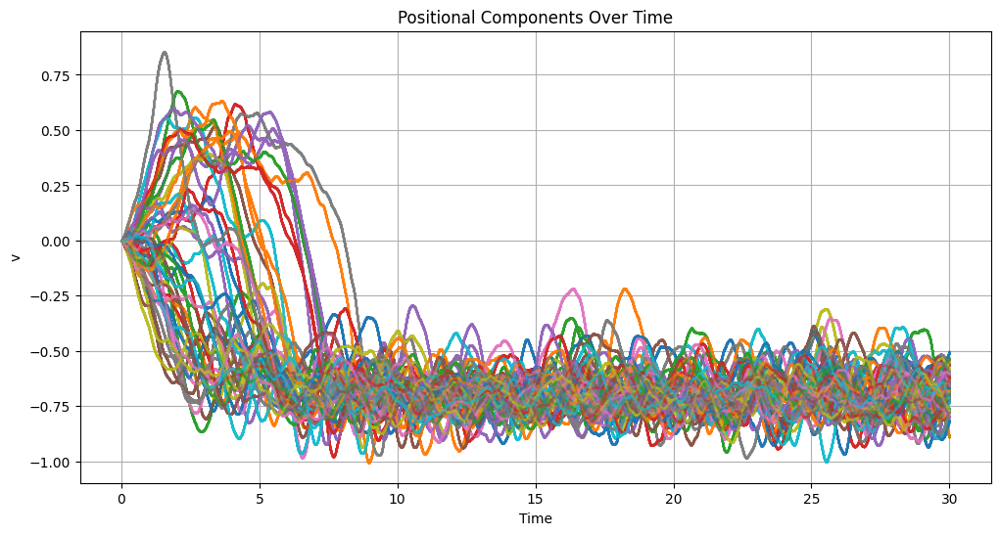

Optimising EM-based contrast estimator starts.
[1.96623087 1.64709103 0.49456406 1.95796704]
Likelihood value and gradient with estimated parameters:
(Array(-61162.375, dtype=float32), Array([-1.6884762e-05, -1.9822270e-05, -4.0950095e-03,  1.2474367e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99359095 1.56027985 0.49820641 1.98509228]
Likelihood value and gradient with estimated parameters:
(Array(-1926732.4, dtype=float32), Array([3.2268465e-05, 1.4579296e-03, 2.0196426e-01, 4.4811517e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 38
Compute the sample paths


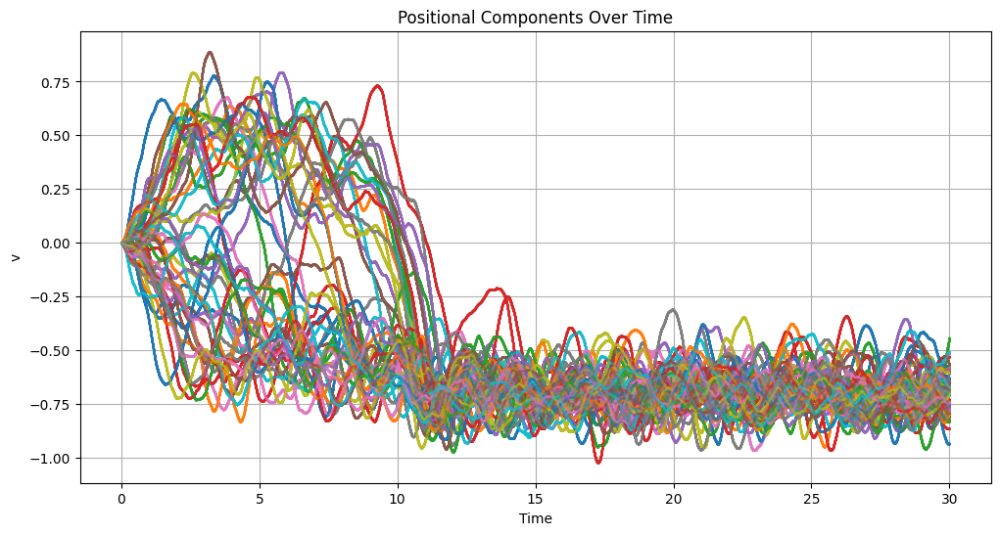

Optimising EM-based contrast estimator starts.
[1.95093465 1.59797931 0.49534333 2.00432229]
Likelihood value and gradient with estimated parameters:
(Array(-60690.48, dtype=float32), Array([-5.1670475e-05, -3.6299229e-05, -6.0478054e-02,  9.5195370e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97719216 1.5165118  0.4985055  2.0313766 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926527.2, dtype=float32), Array([ 1.4725327e-04, -5.6384802e-03, -5.2021945e-01, -5.7274941e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 39
Compute the sample paths


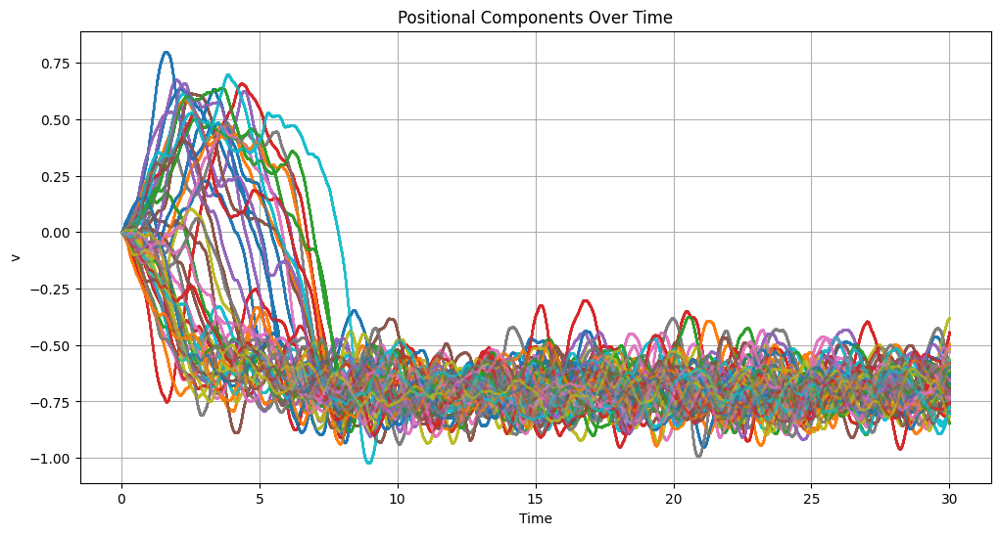

Optimising EM-based contrast estimator starts.
[1.97886634 1.69154286 0.49403927 2.03005791]
Likelihood value and gradient with estimated parameters:
(Array(-61480.555, dtype=float32), Array([-1.09609566e-04, -1.31443143e-04,  4.87661734e-02, -1.25023653e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00749874 1.60384417 0.49805865 2.0589571 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926843.8, dtype=float32), Array([ 4.3909252e-04, -4.9576759e-03, -3.8260436e-01, -2.2656284e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 40
Compute the sample paths


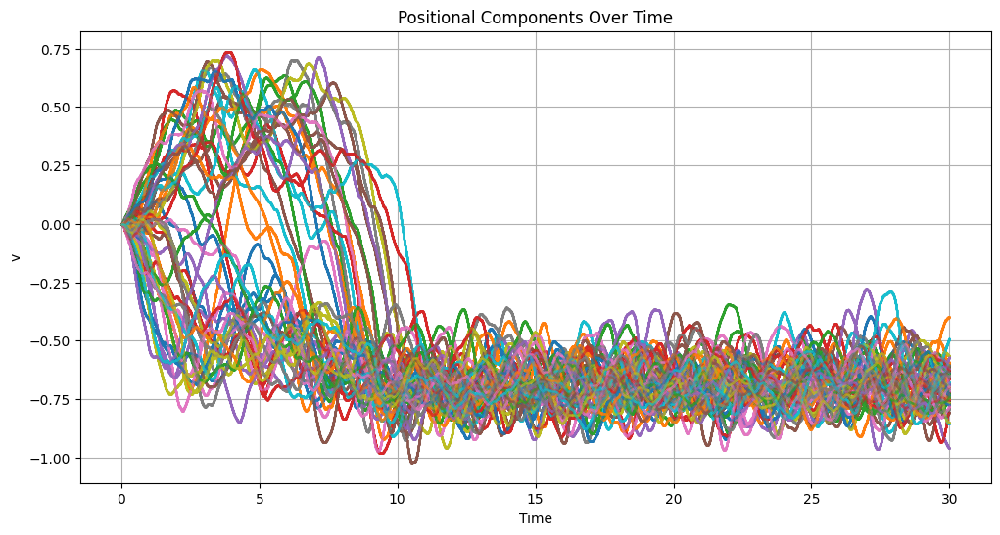

Optimising EM-based contrast estimator starts.
[1.9719075  1.61348355 0.49543649 2.02452207]
Likelihood value and gradient with estimated parameters:
(Array(-60634.1, dtype=float32), Array([-1.9411324e-05,  3.1616539e-05, -5.5664409e-02,  7.1409158e-07],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99946094 1.52803111 0.49864668 2.05200052]
Likelihood value and gradient with estimated parameters:
(Array(-1926449.1, dtype=float32), Array([-1.4337897e-04,  2.7000904e-04, -1.7071332e-01,  2.9027578e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 41
Compute the sample paths


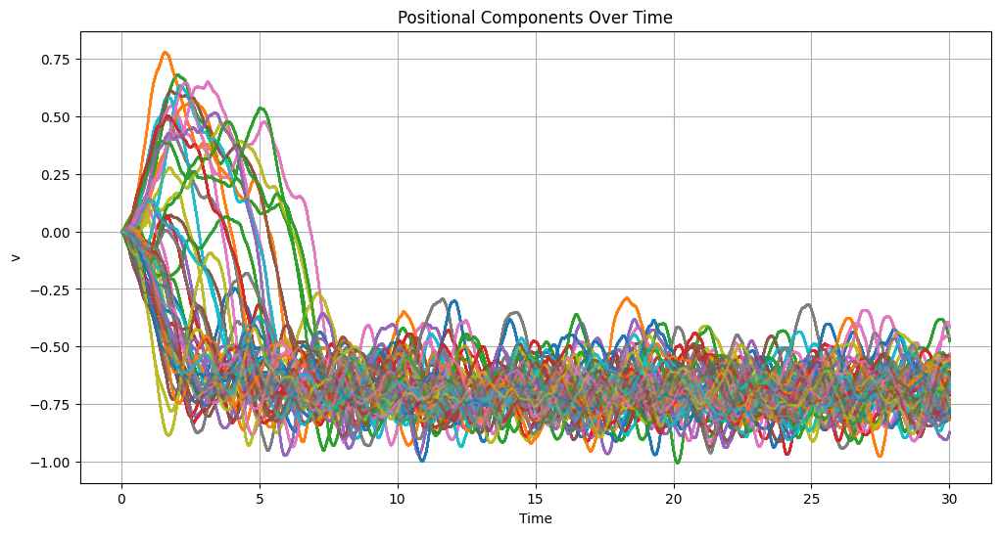

Optimising EM-based contrast estimator starts.
[1.93356395 1.5412991  0.49567014 1.87090683]
Likelihood value and gradient with estimated parameters:
(Array(-60492.832, dtype=float32), Array([ 1.6343582e-04, -2.0944327e-04,  2.8734967e-02,  4.4732587e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95989501 1.44945073 0.49867013 1.89430439]
Likelihood value and gradient with estimated parameters:
(Array(-1926392.4, dtype=float32), Array([ 1.7097592e-04, -1.8775463e-03, -1.9982433e-01,  3.4054508e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 42
Compute the sample paths


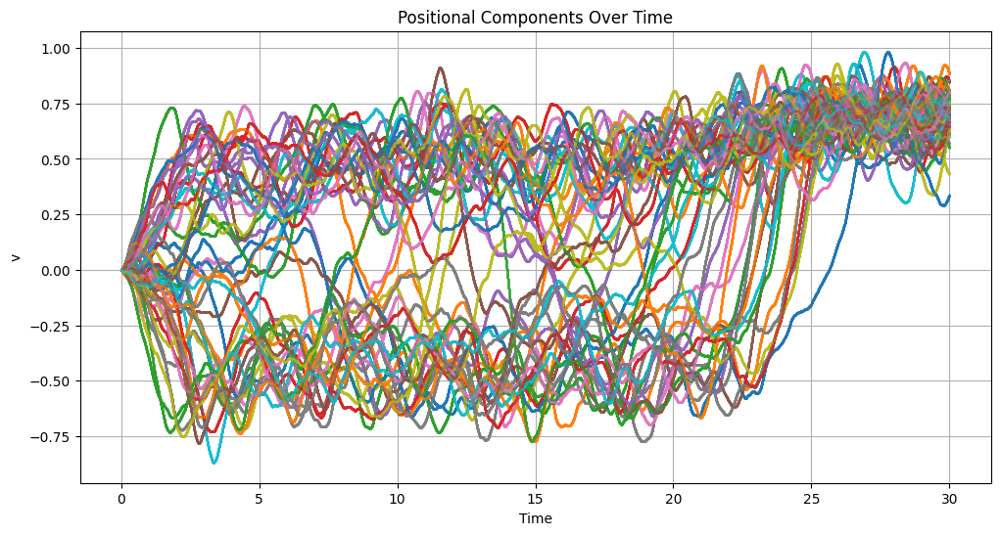

Optimising EM-based contrast estimator starts.
[1.91017771 1.62740242 0.4954024  1.95332003]
Likelihood value and gradient with estimated parameters:
(Array(-60654.75, dtype=float32), Array([ 1.3360422e-04,  9.5218420e-05, -9.2184944e-03, -2.7616101e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.93672371 1.59973323 0.49907497 1.98039651]
Likelihood value and gradient with estimated parameters:
(Array(-1926231.2, dtype=float32), Array([-7.0054084e-05,  6.0081482e-05,  1.9154489e-01, -2.6472844e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 43
Compute the sample paths


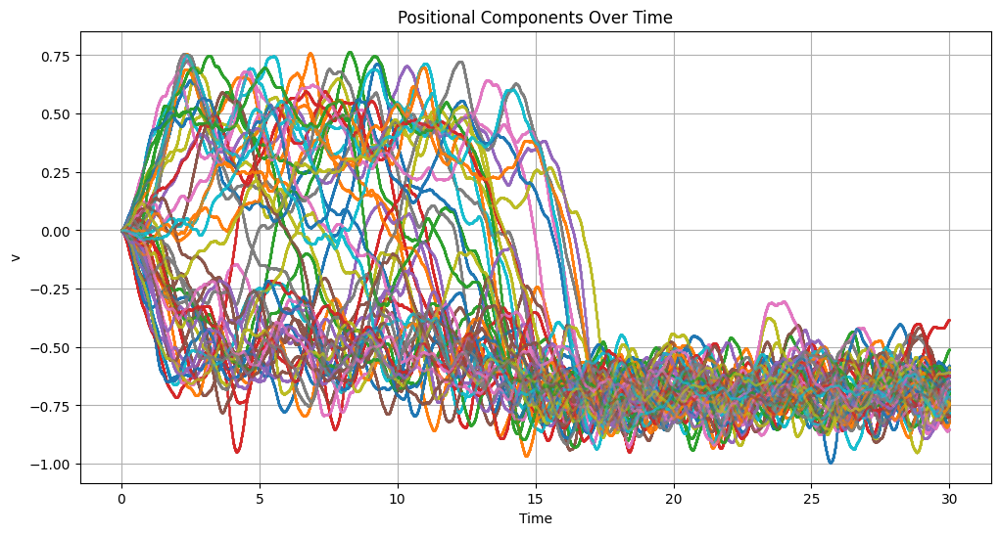

Optimising EM-based contrast estimator starts.
[1.93757653 1.59664059 0.49354342 1.97223508]
Likelihood value and gradient with estimated parameters:
(Array(-61781.492, dtype=float32), Array([-2.1073478e-04,  1.7408282e-05, -2.1896018e-03,  3.5060511e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96485245 1.53760052 0.49731764 1.99936247]
Likelihood value and gradient with estimated parameters:
(Array(-1927256., dtype=float32), Array([-9.7289681e-05,  1.4338493e-03,  1.0331120e+00, -4.5778230e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 44
Compute the sample paths


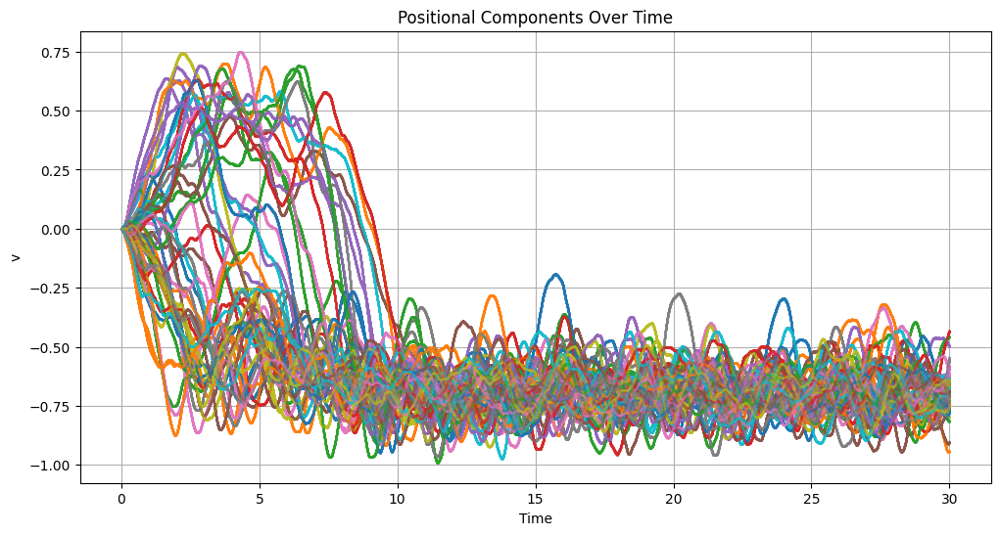

Optimising EM-based contrast estimator starts.
[1.98082447 1.54865432 0.49422544 1.89429021]
Likelihood value and gradient with estimated parameters:
(Array(-61367.633, dtype=float32), Array([ 1.4057395e-04, -1.6202778e-04,  6.7229584e-02,  5.8891950e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00697064 1.46134818 0.49742466 1.9186995 ]
Likelihood value and gradient with estimated parameters:
(Array(-1927148.2, dtype=float32), Array([-4.2614341e-04,  4.2078495e-03, -2.1862566e-02,  4.8234593e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 45
Compute the sample paths


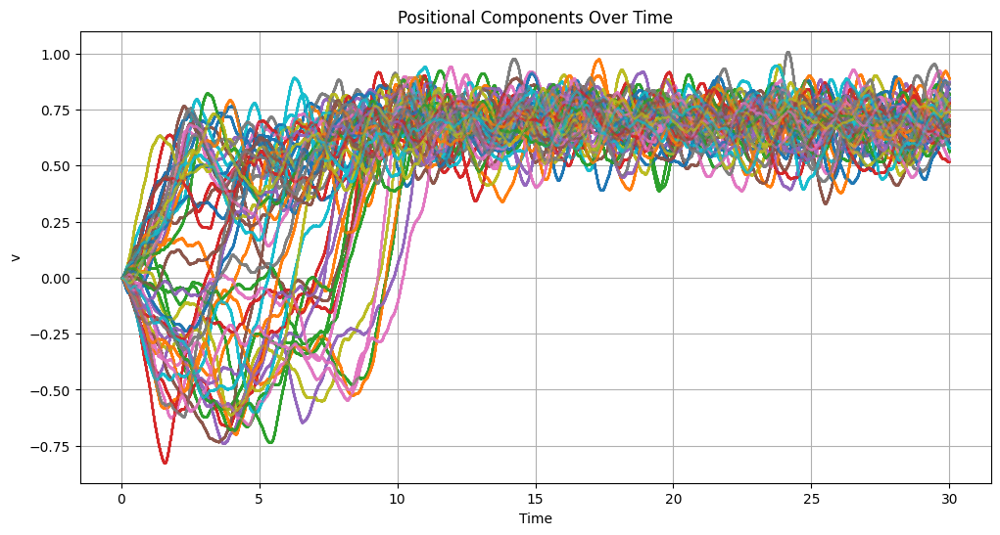

Optimising EM-based contrast estimator starts.
[1.92175305 1.66847098 0.49397948 1.94648969]
Likelihood value and gradient with estimated parameters:
(Array(-61516.78, dtype=float32), Array([-5.2965479e-05, -8.1956387e-06, -3.5409424e-02, -3.9832899e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95050967 1.5938468  0.49759054 1.97413969]
Likelihood value and gradient with estimated parameters:
(Array(-1927120.8, dtype=float32), Array([-1.9878149e-04,  3.1113625e-04, -4.6524167e-01, -2.6407652e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 46
Compute the sample paths


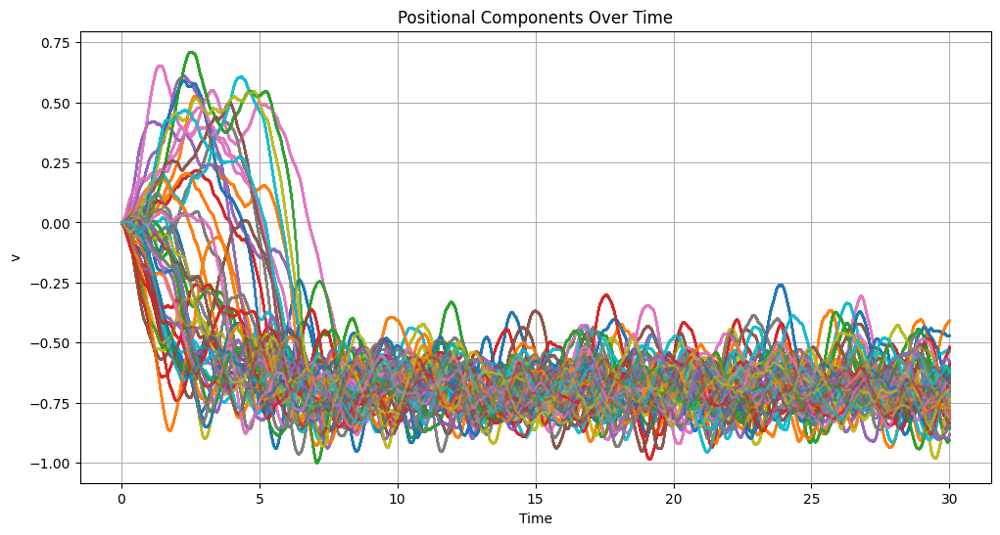

Optimising EM-based contrast estimator starts.
[1.93255937 1.605142   0.49485284 2.03086662]
Likelihood value and gradient with estimated parameters:
(Array(-60987.414, dtype=float32), Array([ 1.5478174e-04,  6.7368150e-05, -2.7371850e-03,  4.5795809e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95834482 1.50656295 0.49765259 2.05830169]
Likelihood value and gradient with estimated parameters:
(Array(-1927035.8, dtype=float32), Array([ 1.0687113e-04, -4.1360110e-03,  2.5262403e-01, -7.9180114e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 47
Compute the sample paths


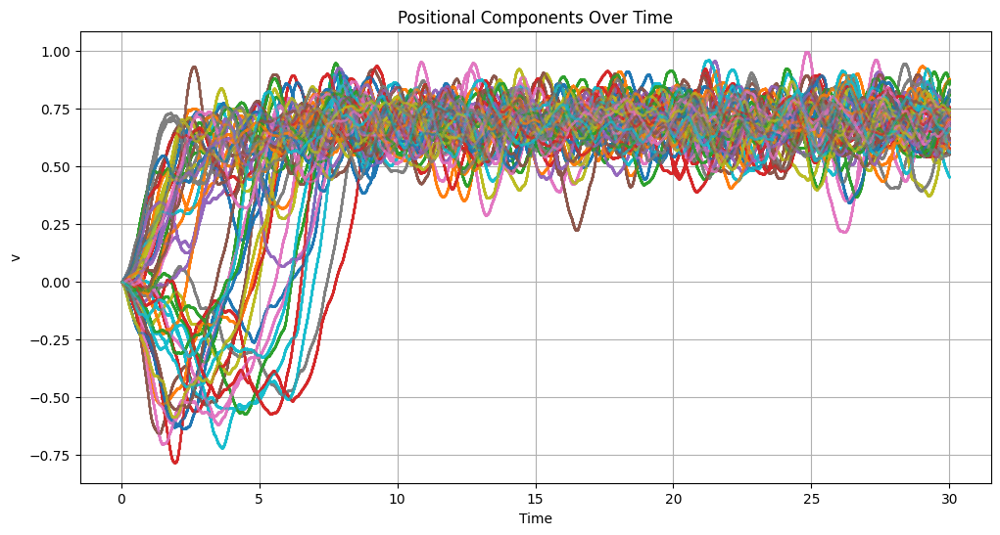

Optimising EM-based contrast estimator starts.
[1.98988831 1.56280649 0.49334803 1.91148126]
Likelihood value and gradient with estimated parameters:
(Array(-61900.156, dtype=float32), Array([ 1.1145987e-04, -3.5728514e-04, -5.0046377e-02, -3.7901395e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.01773047 1.47462952 0.49645483 1.93562269]
Likelihood value and gradient with estimated parameters:
(Array(-1927740.2, dtype=float32), Array([-7.5948238e-04,  7.7128410e-04, -1.5637910e-01, -1.5551131e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 48
Compute the sample paths


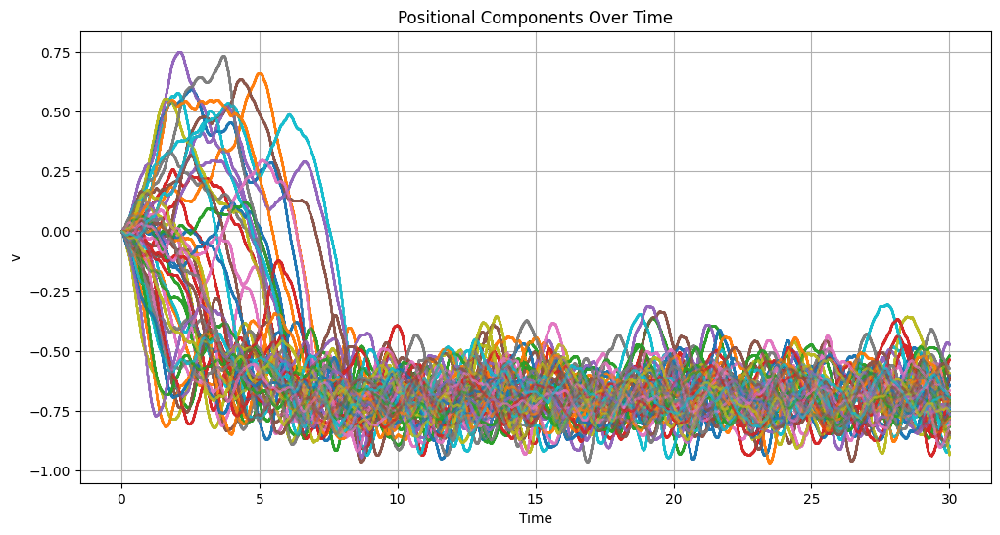

Optimising EM-based contrast estimator starts.
[1.95902002 1.67806494 0.49590558 1.91315508]
Likelihood value and gradient with estimated parameters:
(Array(-60350.504, dtype=float32), Array([-7.3009753e-05, -2.0071864e-05, -1.1910330e-02,  1.1139433e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98647165 1.5967226  0.49964261 1.93996871]
Likelihood value and gradient with estimated parameters:
(Array(-1925889., dtype=float32), Array([-5.4284930e-04,  4.8220158e-03, -4.1045308e-02, -2.1241140e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 49
Compute the sample paths


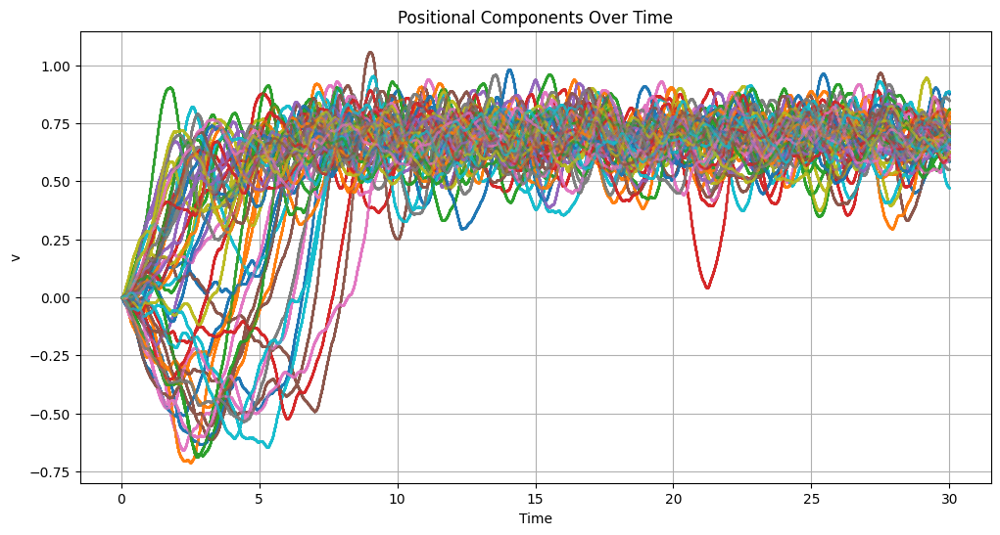

Optimising EM-based contrast estimator starts.
[1.95452225 1.61791313 0.49398389 1.87457502]
Likelihood value and gradient with estimated parameters:
(Array(-61514.152, dtype=float32), Array([ 8.6597865e-06, -7.1242452e-05,  7.4257568e-02, -4.1145890e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98101211 1.53940105 0.49807596 1.9000926 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926798.5, dtype=float32), Array([-2.1348894e-04,  5.4769516e-03, -3.5930216e-01,  3.1493604e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 50
Compute the sample paths


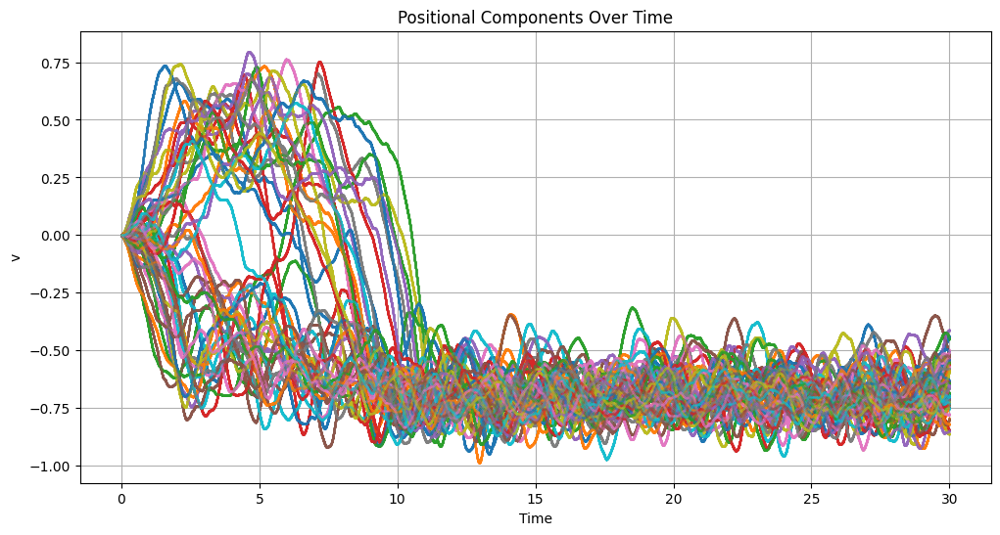

Optimising EM-based contrast estimator starts.
[2.03537226 1.62334144 0.49552506 1.94205391]
Likelihood value and gradient with estimated parameters:
(Array(-60580.57, dtype=float32), Array([-2.3385510e-04,  5.2392483e-05, -5.9664737e-02,  3.4156954e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.06442833 1.54273009 0.49895367 1.96864903]
Likelihood value and gradient with estimated parameters:
(Array(-1926272., dtype=float32), Array([-3.7503242e-04, -2.4604797e-03, -2.3804837e-01,  5.4887496e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 51
Compute the sample paths


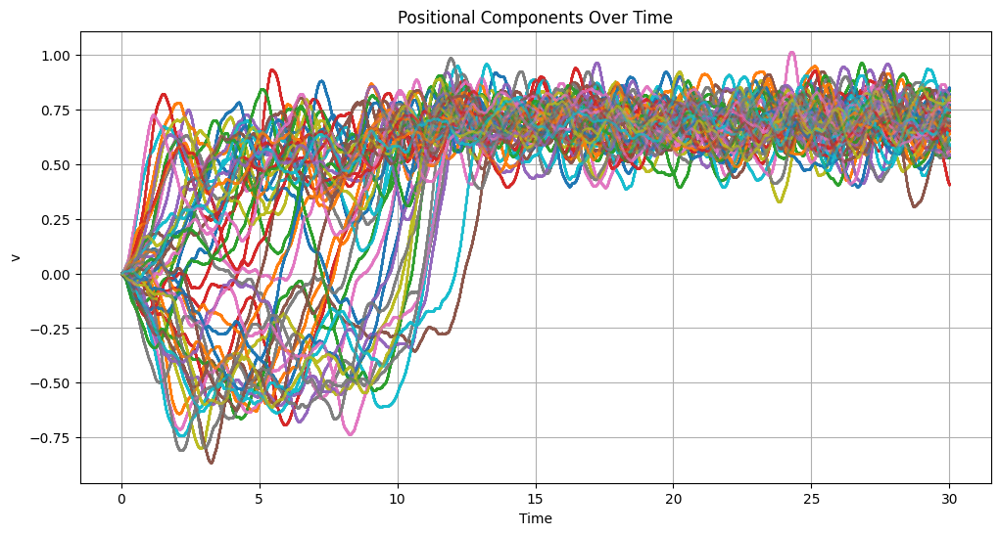

Optimising EM-based contrast estimator starts.
[1.91791618 1.60670483 0.49361464 1.85139871]
Likelihood value and gradient with estimated parameters:
(Array(-61738.24, dtype=float32), Array([-3.9624516e-05, -7.8380108e-05, -1.4118662e-02, -4.7006877e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94509888 1.53404117 0.49687216 1.87692082]
Likelihood value and gradient with estimated parameters:
(Array(-1927521.5, dtype=float32), Array([ 5.3827465e-04, -1.4364719e-03, -5.5489695e-01, -2.0289421e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 52
Compute the sample paths


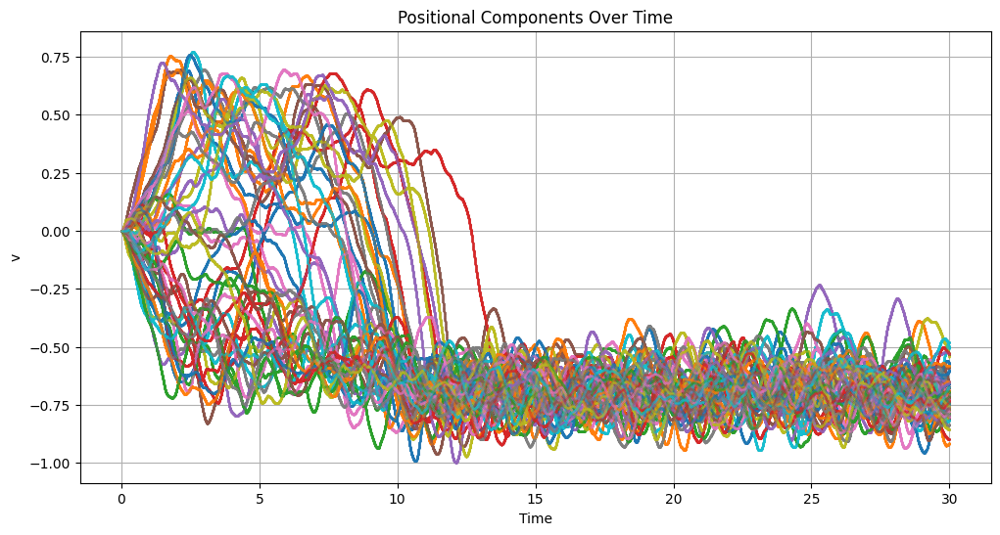

Optimising EM-based contrast estimator starts.
[1.90486956 1.61539662 0.49628323 1.91789579]
Likelihood value and gradient with estimated parameters:
(Array(-60122.355, dtype=float32), Array([ 1.2418814e-04,  7.2047114e-05, -7.4178196e-02, -1.8836232e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9303112  1.5409826  0.49950895 1.94371355]
Likelihood value and gradient with estimated parameters:
(Array(-1925938., dtype=float32), Array([-1.1835992e-04,  5.3942204e-04, -1.3645855e+00,  9.3392795e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 53
Compute the sample paths


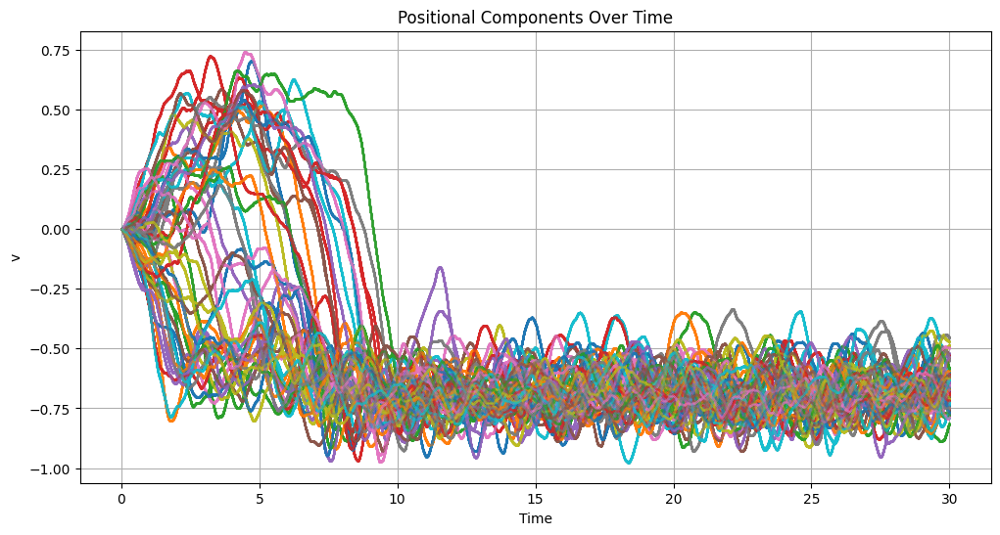

Optimising EM-based contrast estimator starts.
[1.94865012 1.67887962 0.49603051 1.93660927]
Likelihood value and gradient with estimated parameters:
(Array(-60275.023, dtype=float32), Array([ 1.10702415e-04, -1.34322792e-04, -4.24989499e-03,  7.22378027e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97571278 1.59050322 0.49911976 1.96400928]
Likelihood value and gradient with estimated parameters:
(Array(-1926198.5, dtype=float32), Array([ 1.14720315e-05,  5.99026680e-05, -1.34794712e-02, -2.41287053e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 54
Compute the sample paths


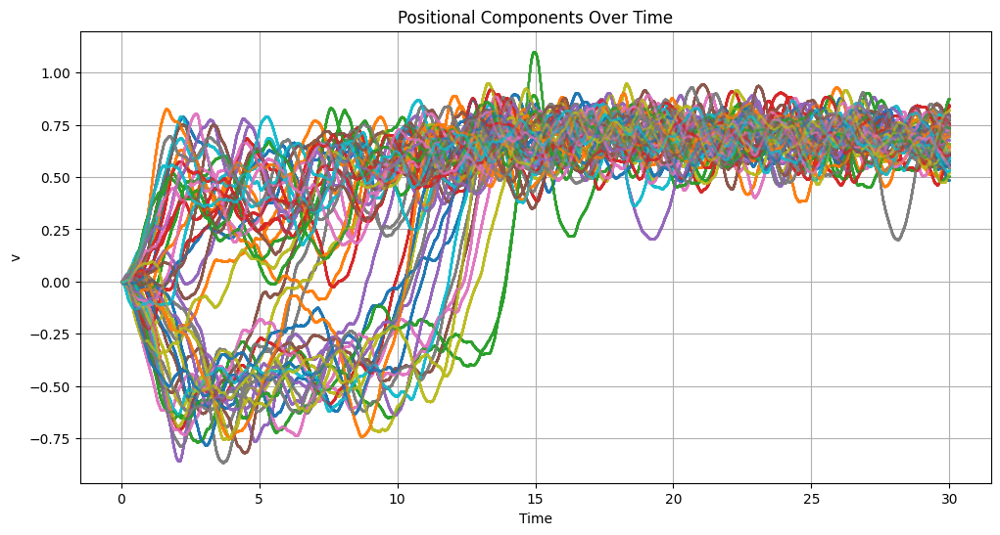

Optimising EM-based contrast estimator starts.
[1.97206771 1.64613628 0.49571434 1.87824774]
Likelihood value and gradient with estimated parameters:
(Array(-60466.086, dtype=float32), Array([ 5.9918500e-05, -8.1880018e-05, -7.9104319e-02,  1.9304454e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00206208 1.57564557 0.49884945 1.90522552]
Likelihood value and gradient with estimated parameters:
(Array(-1926353.1, dtype=float32), Array([ 1.8796325e-04, -3.6759973e-03, -1.2934961e+00, -2.6114285e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 55
Compute the sample paths


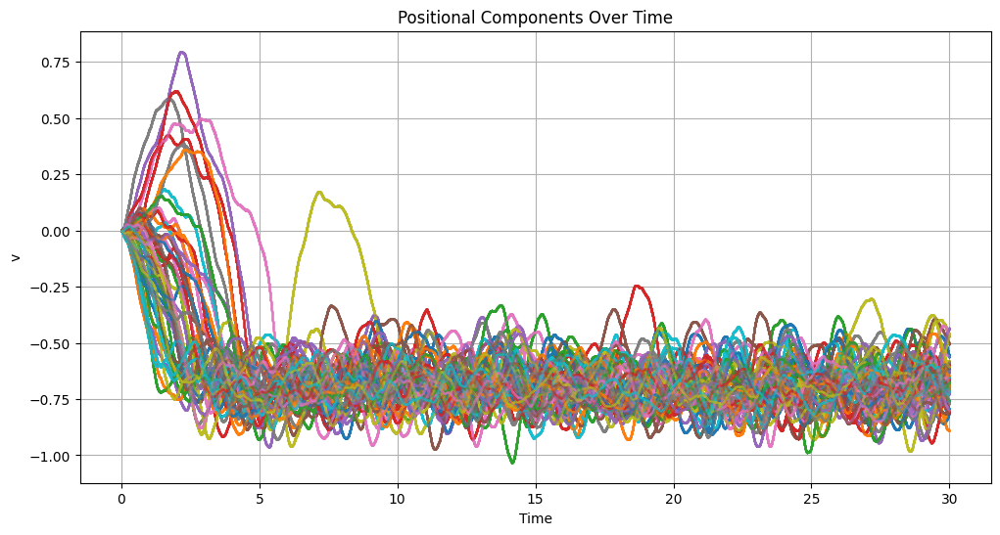

Optimising EM-based contrast estimator starts.
[1.93714118 1.58675146 0.49407935 1.92111874]
Likelihood value and gradient with estimated parameters:
(Array(-61456.234, dtype=float32), Array([1.0646792e-04, 2.4274737e-04, 4.2039640e-02, 4.9300143e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96284342 1.49833894 0.49804658 1.94849801]
Likelihood value and gradient with estimated parameters:
(Array(-1926794., dtype=float32), Array([-1.3816170e-04,  2.5529861e-03,  4.8369312e-01,  6.0478225e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 56
Compute the sample paths


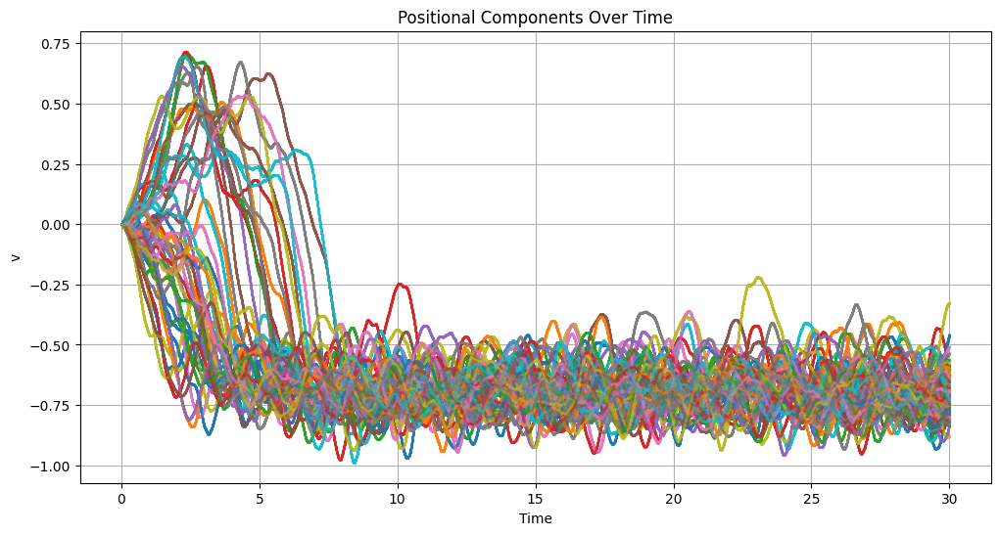

Optimising EM-based contrast estimator starts.
[1.99767101 1.59600651 0.49386287 1.90502429]
Likelihood value and gradient with estimated parameters:
(Array(-61587.58, dtype=float32), Array([-1.5812507e-04, -2.4884939e-05,  2.7587436e-02,  1.7946586e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.02467752 1.51394331 0.49774668 1.9302187 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926982.5, dtype=float32), Array([ 1.09312125e-04,  1.02400780e-03, -9.67554808e-01,  1.22692436e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 57
Compute the sample paths


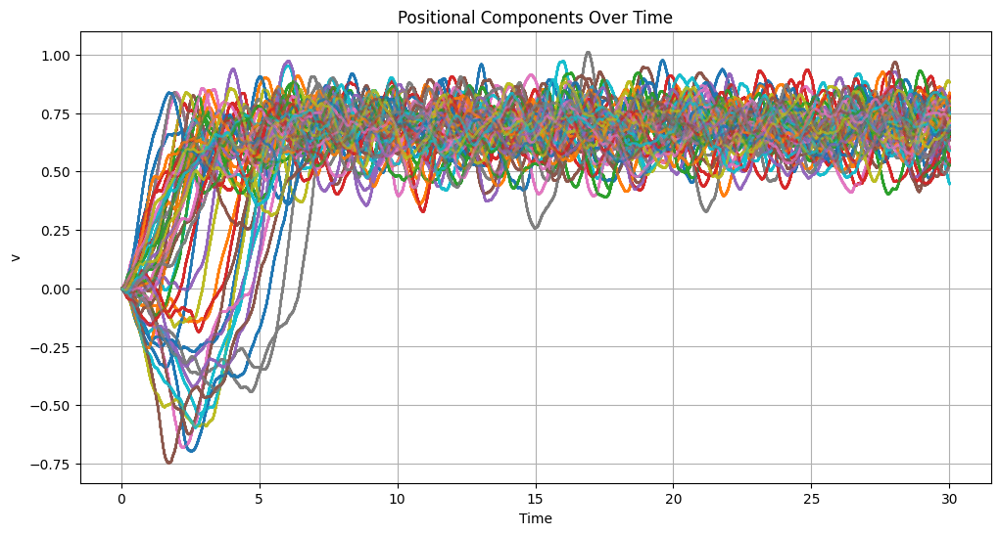

Optimising EM-based contrast estimator starts.
[1.96977746 1.61989164 0.49469087 1.89459395]
Likelihood value and gradient with estimated parameters:
(Array(-61085.492, dtype=float32), Array([ 1.7615035e-05,  4.4569373e-05, -3.9276127e-02,  3.1896692e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99611652 1.52214277 0.49790943 1.9202745 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926889.2, dtype=float32), Array([-1.0893494e-04, -3.1175613e-03,  4.9492502e-01, -1.0375783e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 58
Compute the sample paths


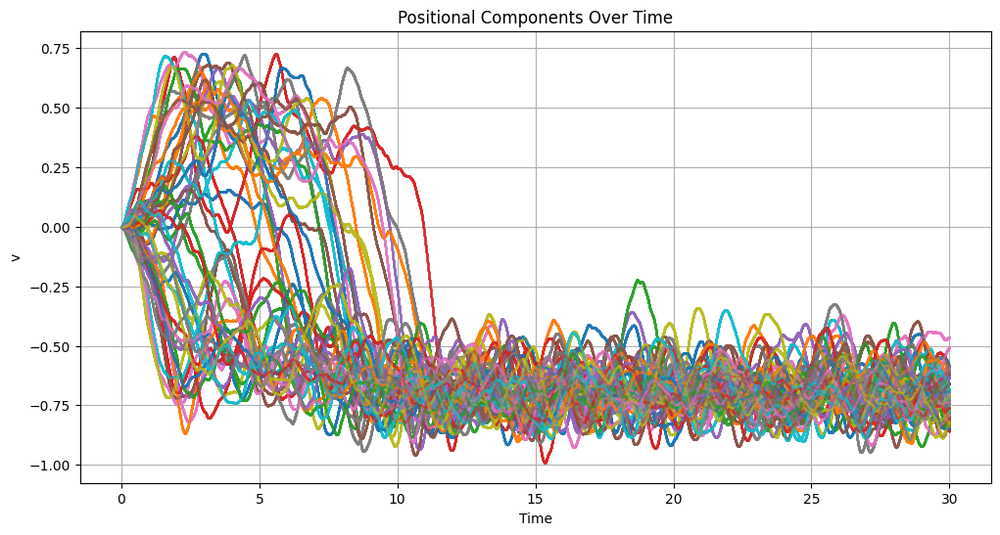

Optimising EM-based contrast estimator starts.
[1.96391273 1.60188031 0.49442253 1.90057313]
Likelihood value and gradient with estimated parameters:
(Array(-61248.105, dtype=float32), Array([-4.3665641e-05, -5.2079558e-06, -1.5843007e-03, -5.9714890e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99253523 1.51827788 0.49748966 1.92654753]
Likelihood value and gradient with estimated parameters:
(Array(-1927140.2, dtype=float32), Array([-4.7528744e-04,  1.2989044e-03, -5.4312986e-01,  7.5390562e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 59
Compute the sample paths


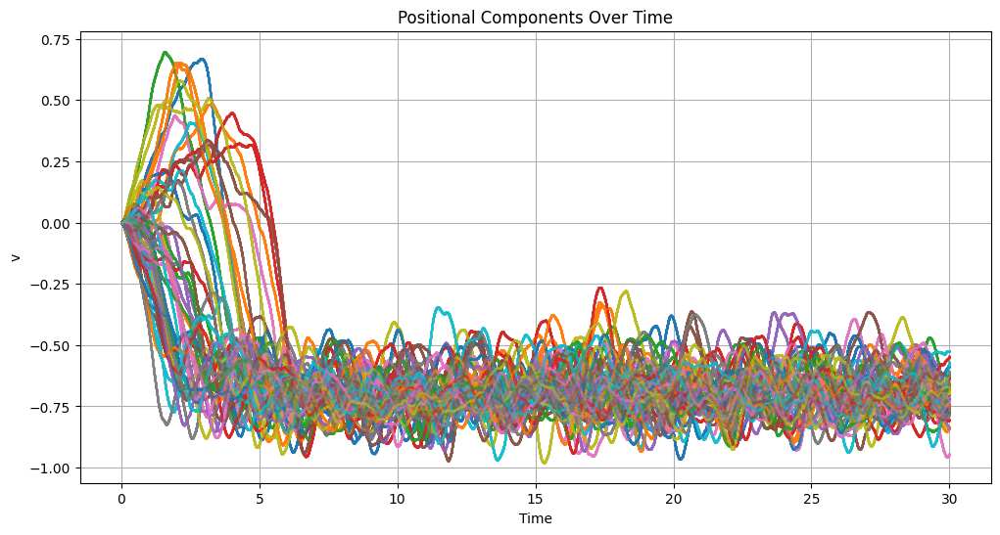

Optimising EM-based contrast estimator starts.
[1.93994606 1.67660701 0.49554676 2.00445127]
Likelihood value and gradient with estimated parameters:
(Array(-60567.453, dtype=float32), Array([2.5680056e-05, 2.5361776e-05, 1.4035362e-01, 4.5875320e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96613991 1.57934701 0.49852118 2.03421426]
Likelihood value and gradient with estimated parameters:
(Array(-1926552.6, dtype=float32), Array([-2.0279363e-04,  3.5126507e-04, -5.9597266e-01, -4.3630600e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 60
Compute the sample paths


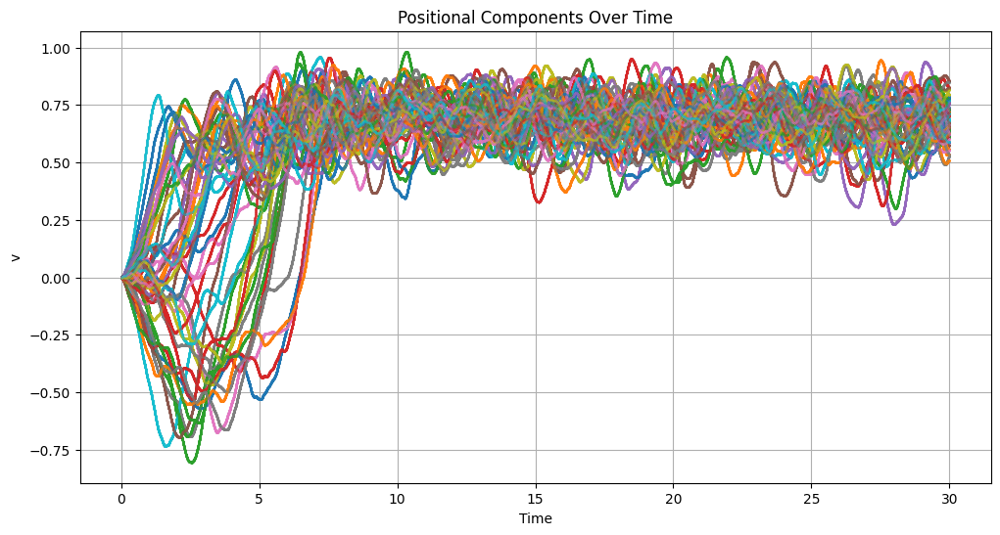

Optimising EM-based contrast estimator starts.
[1.98022246 1.56596398 0.49423894 2.00729823]
Likelihood value and gradient with estimated parameters:
(Array(-61359.438, dtype=float32), Array([-3.2688724e-05, -1.3528764e-04,  1.5610880e-03, -5.3239986e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00653243 1.47903752 0.49823168 2.0338254 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926672.8, dtype=float32), Array([ 1.6789138e-04, -4.0163994e-03,  7.4380326e-01, -7.8259036e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 61
Compute the sample paths


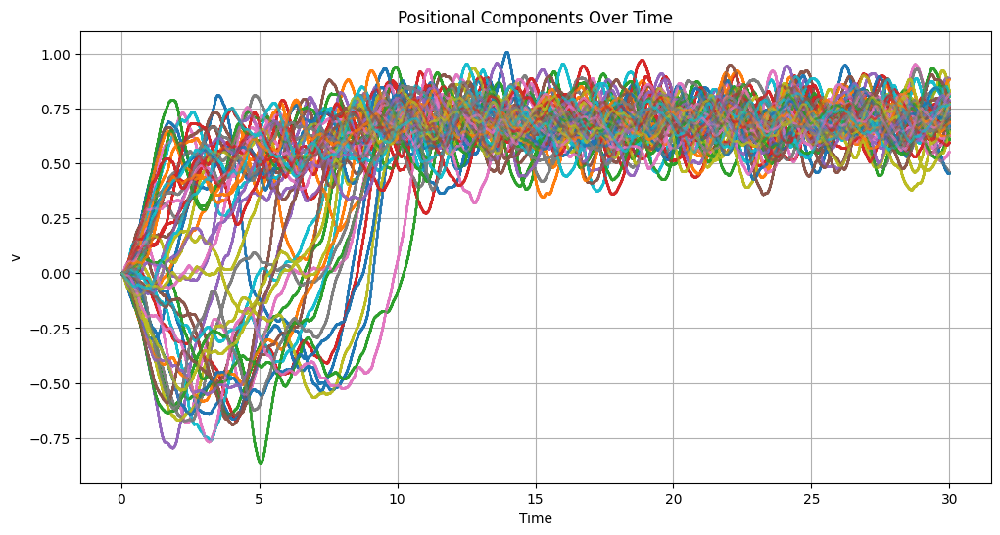

Optimising EM-based contrast estimator starts.
[1.96189618 1.64114404 0.49365184 1.93408334]
Likelihood value and gradient with estimated parameters:
(Array(-61715.68, dtype=float32), Array([-2.7607661e-05,  7.9482794e-05, -3.9613571e-02, -8.7137218e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98929834 1.55832517 0.49699196 1.96073651]
Likelihood value and gradient with estimated parameters:
(Array(-1927462.2, dtype=float32), Array([-2.1015853e-04,  1.8370152e-03,  8.5580170e-01,  4.9956143e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 62
Compute the sample paths


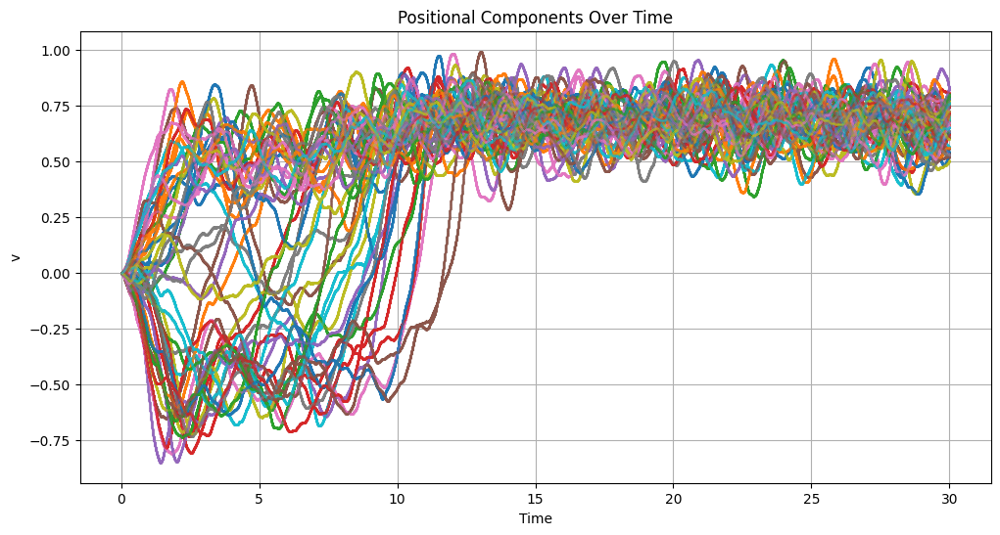

Optimising EM-based contrast estimator starts.
[2.01463246 1.56772757 0.49556768 1.88013852]
Likelihood value and gradient with estimated parameters:
(Array(-60554.79, dtype=float32), Array([-6.9581438e-07,  3.8057566e-05,  3.4049436e-02, -7.6430792e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.04228616 1.48786676 0.49893919 1.90519667]
Likelihood value and gradient with estimated parameters:
(Array(-1926251.1, dtype=float32), Array([-1.6666949e-04,  1.9161701e-03,  6.4115357e-01, -4.6022236e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 63
Compute the sample paths


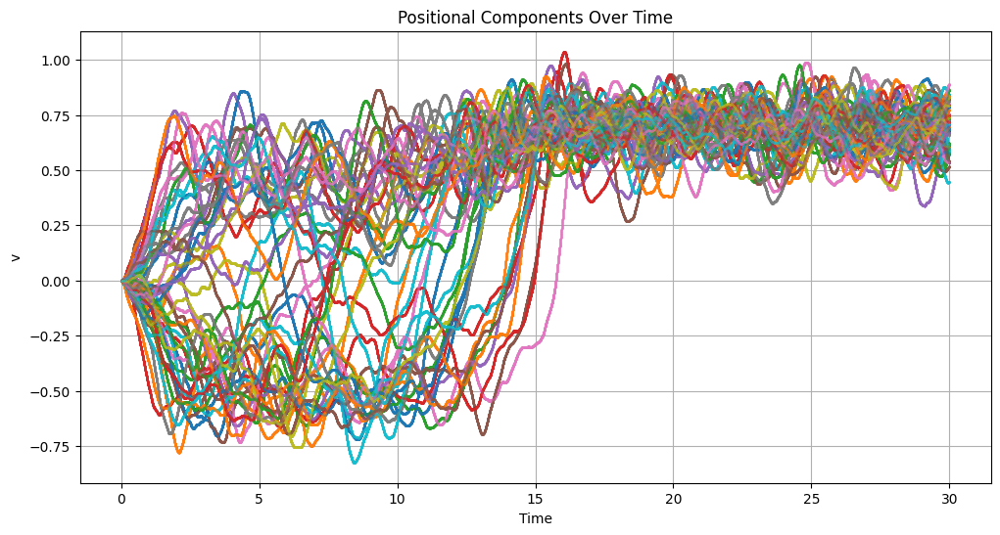

Optimising EM-based contrast estimator starts.
[1.86493003 1.59844565 0.49452341 1.89860594]
Likelihood value and gradient with estimated parameters:
(Array(-61186.984, dtype=float32), Array([-9.2638889e-05, -4.3947250e-05,  2.6410399e-03,  1.2571865e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.89000678 1.53568113 0.49789453 1.92419577]
Likelihood value and gradient with estimated parameters:
(Array(-1926905.8, dtype=float32), Array([-2.8578192e-04,  1.5375614e-03, -3.6668384e-01,  1.6846322e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 64
Compute the sample paths


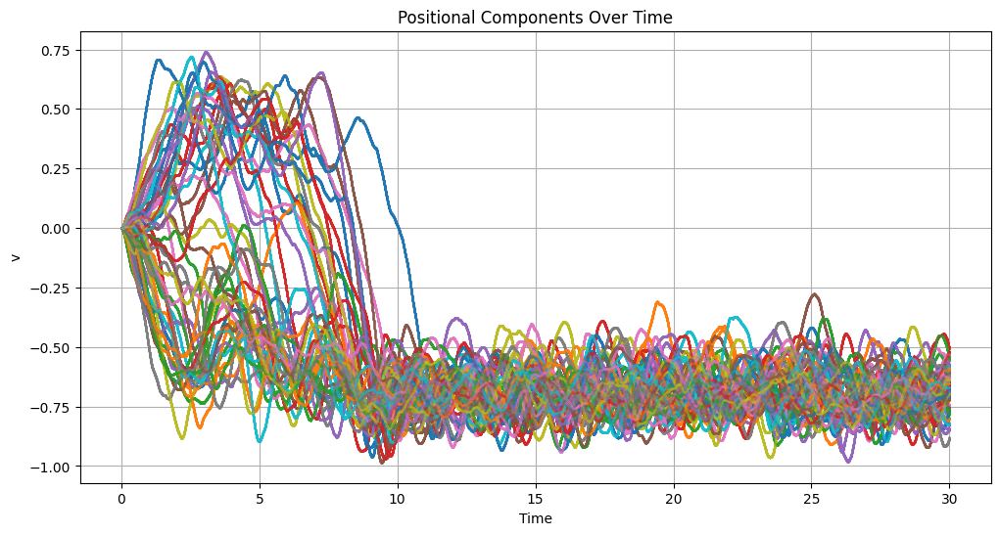

Optimising EM-based contrast estimator starts.
[1.97763634 1.62938297 0.49576589 2.03318095]
Likelihood value and gradient with estimated parameters:
(Array(-60434.93, dtype=float32), Array([-1.6379985e-04,  1.8737279e-04, -4.2404413e-02, -1.1425000e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00536299 1.54430819 0.49906719 2.06147766]
Likelihood value and gradient with estimated parameters:
(Array(-1926205.2, dtype=float32), Array([-1.4279783e-04,  6.5147877e-04, -3.4545785e-01, -5.4372475e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 65
Compute the sample paths


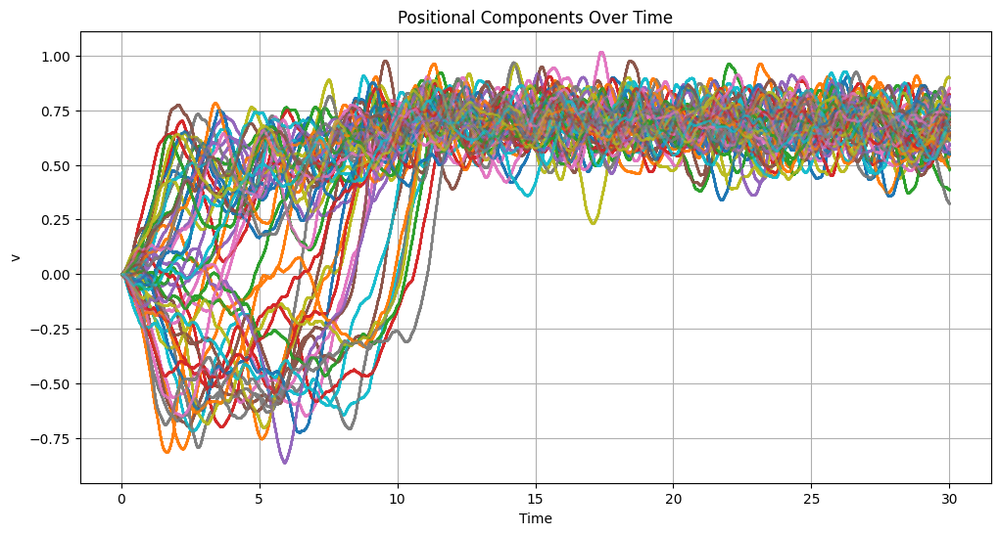

Optimising EM-based contrast estimator starts.
[1.98720419 1.60323787 0.49524081 1.94757664]
Likelihood value and gradient with estimated parameters:
(Array(-60752.555, dtype=float32), Array([ 6.0308259e-05, -4.2755157e-05,  1.1795748e-01, -4.7822949e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.01394892 1.52149594 0.49865964 1.97356439]
Likelihood value and gradient with estimated parameters:
(Array(-1926437.8, dtype=float32), Array([-3.7960708e-04,  4.1251183e-03, -3.6121994e-01,  3.7509948e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 66
Compute the sample paths


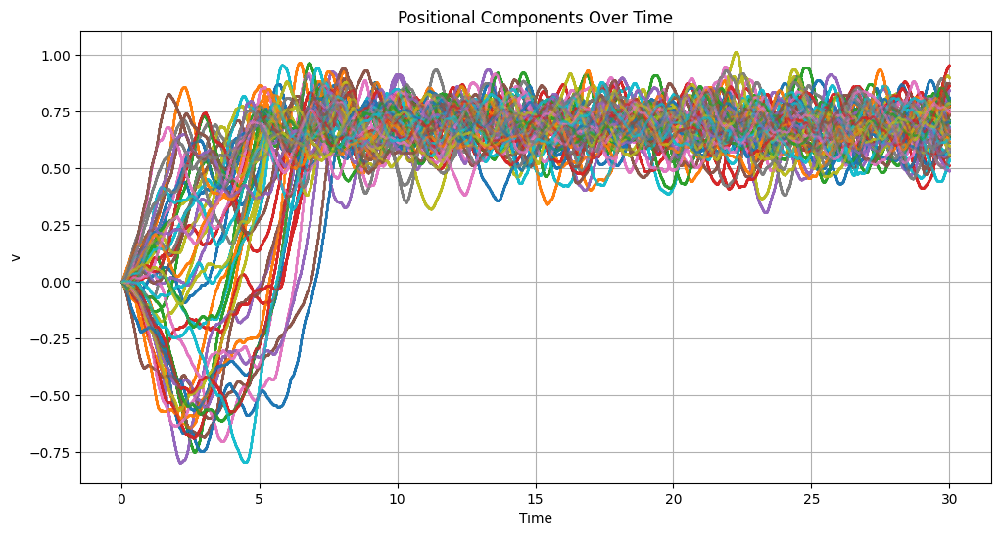

Optimising EM-based contrast estimator starts.
[1.95227242 1.64145958 0.49301395 1.92680275]
Likelihood value and gradient with estimated parameters:
(Array(-62103.17, dtype=float32), Array([1.06130145e-04, 7.59959221e-07, 3.51314573e-03, 2.53997860e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98058426 1.56039858 0.49675593 1.95333934]
Likelihood value and gradient with estimated parameters:
(Array(-1927605.9, dtype=float32), Array([ 1.6590953e-04, -8.2635880e-04, -4.1467667e-02,  3.4887344e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 67
Compute the sample paths


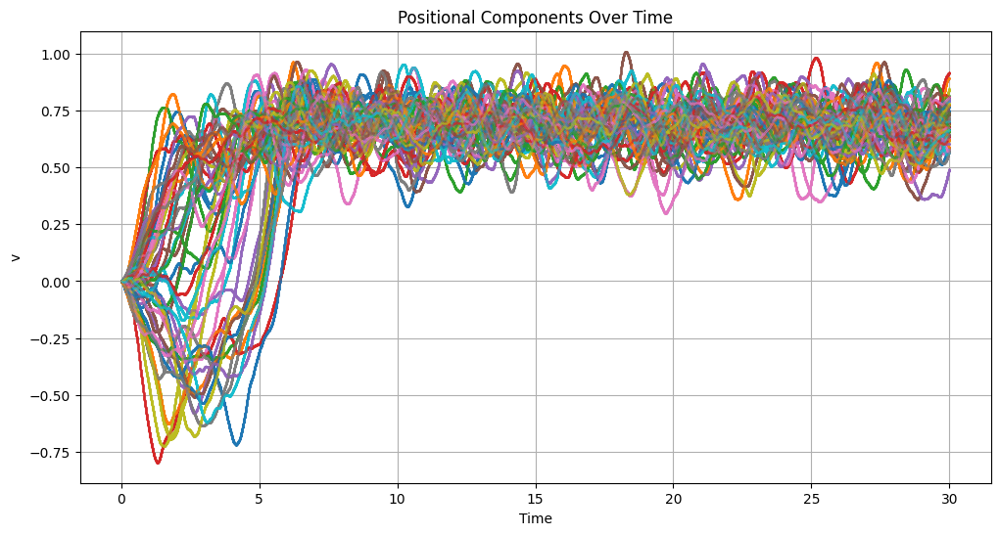

Optimising EM-based contrast estimator starts.
[1.88240826 1.5913856  0.49428654 2.09111381]
Likelihood value and gradient with estimated parameters:
(Array(-61330.6, dtype=float32), Array([ 1.0979548e-04,  3.0692667e-05,  7.0636608e-02, -8.4367930e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.90849507 1.50359464 0.49786001 2.11943555]
Likelihood value and gradient with estimated parameters:
(Array(-1926909.8, dtype=float32), Array([ 2.4256110e-04, -1.0118484e-03, -1.3184004e-01,  1.0486692e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 68
Compute the sample paths


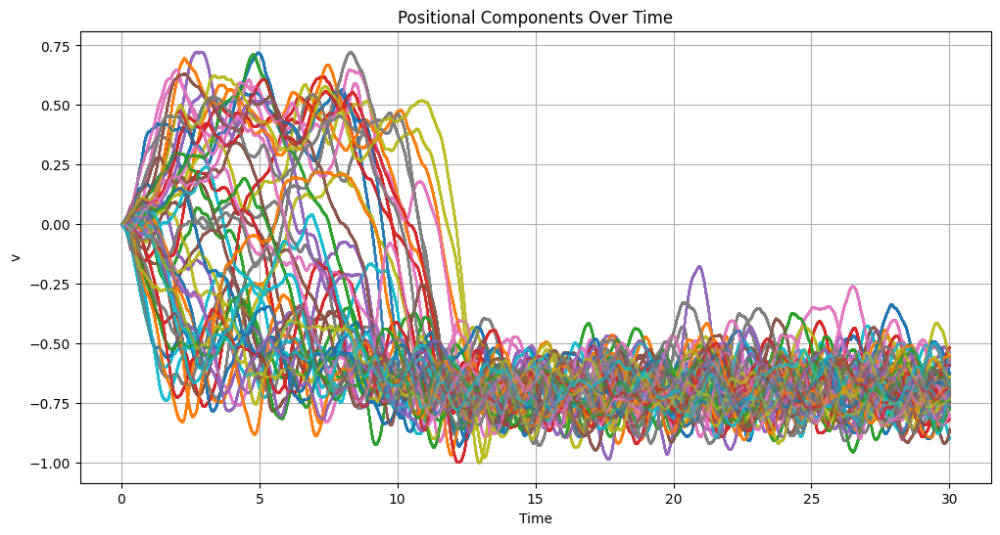

Optimising EM-based contrast estimator starts.
[1.92422962 1.55096114 0.49625492 1.92843974]
Likelihood value and gradient with estimated parameters:
(Array(-60139.453, dtype=float32), Array([ 3.0653551e-05, -6.1392784e-06, -3.4218993e-02, -2.2498600e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95019341 1.4710809  0.4993889  1.95370889]
Likelihood value and gradient with estimated parameters:
(Array(-1925972., dtype=float32), Array([ 1.2405217e-04, -1.4836788e-03,  1.5095949e-01, -8.8311266e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 69
Compute the sample paths


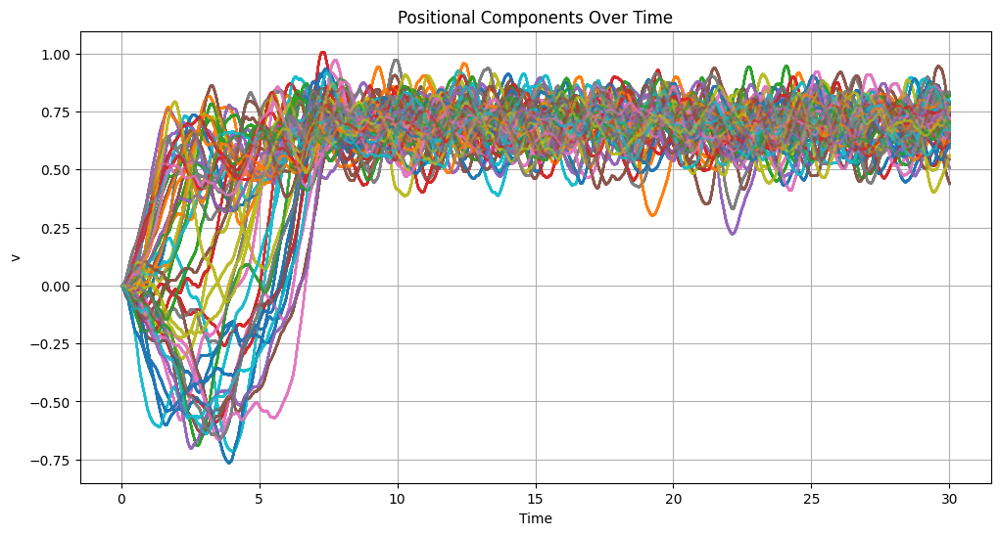

Optimising EM-based contrast estimator starts.
[2.02993608 1.61782646 0.49488884 2.02687812]
Likelihood value and gradient with estimated parameters:
(Array(-60965.61, dtype=float32), Array([ 2.6240665e-04,  8.2097948e-05, -3.7809882e-02,  3.5247969e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.05868721 1.52999413 0.49846131 2.05434227]
Likelihood value and gradient with estimated parameters:
(Array(-1926561.5, dtype=float32), Array([ 2.4601817e-04, -5.1419735e-03,  3.0076900e-01, -3.2560900e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 70
Compute the sample paths


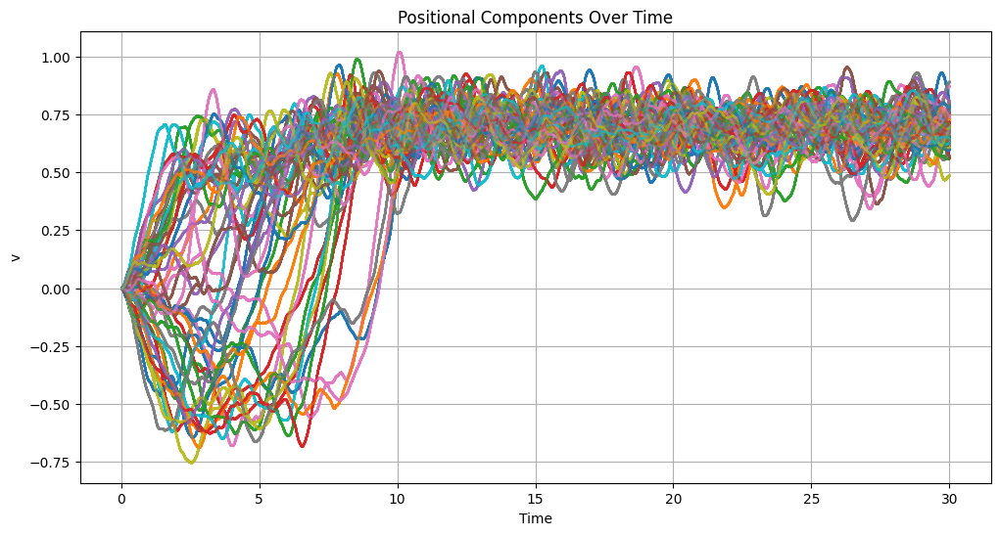

Optimising EM-based contrast estimator starts.
[1.98508084 1.72138393 0.49585769 2.00859046]
Likelihood value and gradient with estimated parameters:
(Array(-60379.473, dtype=float32), Array([-1.30109023e-04, -1.04904175e-04, -3.67716723e-03, -6.12338772e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.01476264 1.63534212 0.49921346 2.03768635]
Likelihood value and gradient with estimated parameters:
(Array(-1926168., dtype=float32), Array([ 1.7902255e-04,  4.7540665e-04,  1.0281372e-01, -8.1979902e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 71
Compute the sample paths


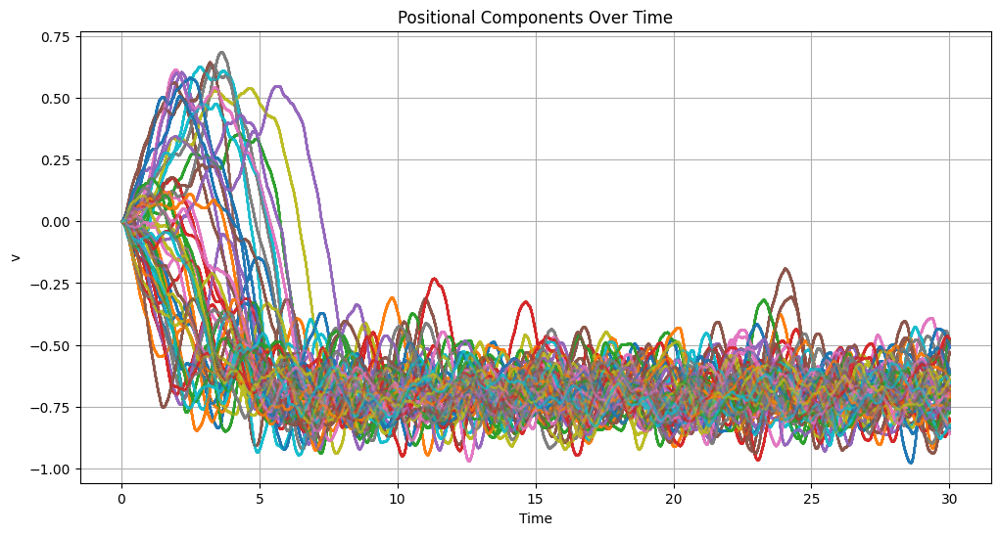

Optimising EM-based contrast estimator starts.
[1.94746864 1.60055649 0.49349976 2.11687493]
Likelihood value and gradient with estimated parameters:
(Array(-61808., dtype=float32), Array([3.1698262e-05, 9.4577670e-05, 3.4618251e-02, 1.4803722e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97390831 1.50685573 0.49676695 2.14505529]
Likelihood value and gradient with estimated parameters:
(Array(-1927569.8, dtype=float32), Array([ 3.3350289e-04, -3.9424896e-03, -3.1911734e-01, -1.1620345e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 72
Compute the sample paths


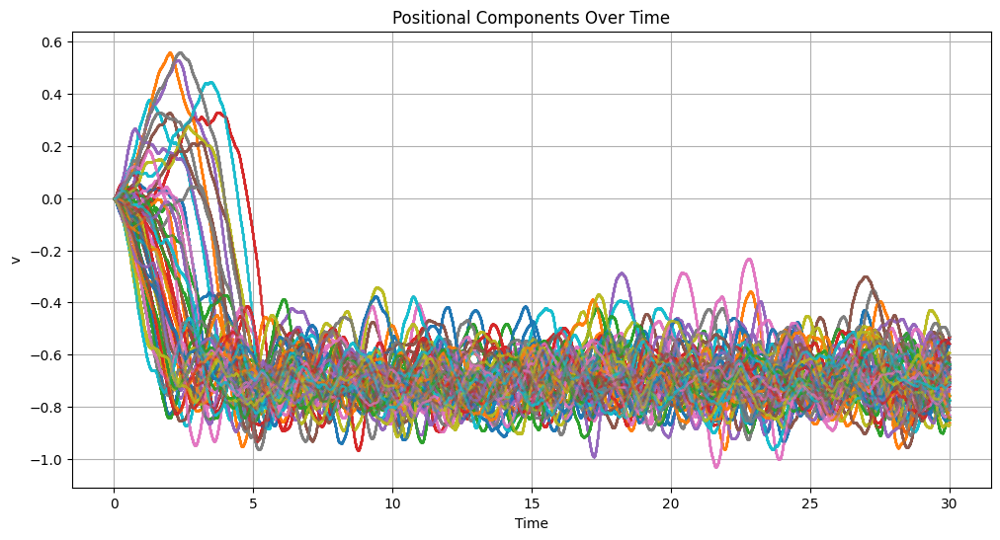

Optimising EM-based contrast estimator starts.
[1.98332155 1.6497786  0.49428976 1.96148241]
Likelihood value and gradient with estimated parameters:
(Array(-61328.617, dtype=float32), Array([-7.2446535e-05, -1.1086930e-05, -7.3380567e-02, -1.4510006e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.01176572 1.55632186 0.49799794 1.98830783]
Likelihood value and gradient with estimated parameters:
(Array(-1926854.2, dtype=float32), Array([ 2.0918250e-04, -3.0047894e-03, -1.0079974e+00, -5.0663948e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 73
Compute the sample paths


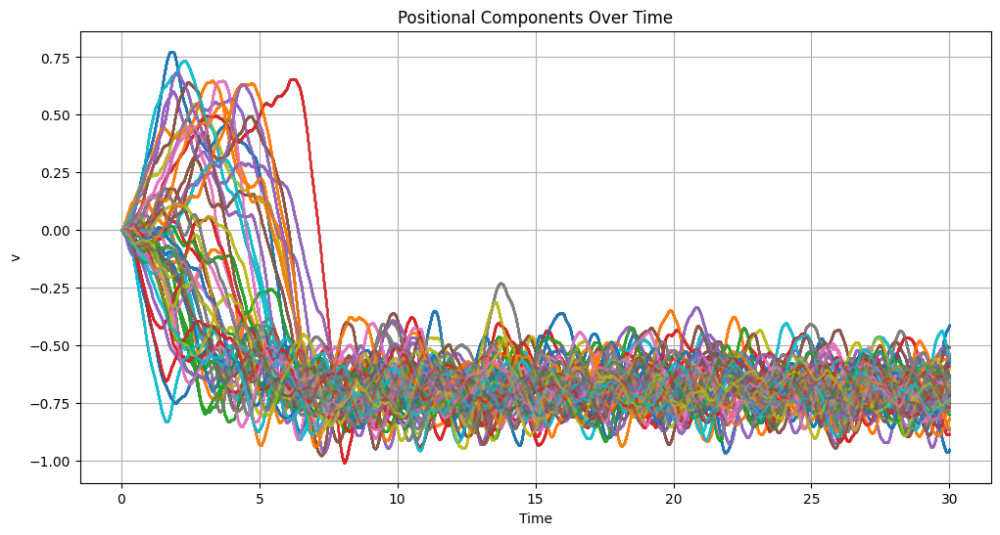

Optimising EM-based contrast estimator starts.
[1.98670185 1.59611416 0.49348485 2.06910777]
Likelihood value and gradient with estimated parameters:
(Array(-61817.04, dtype=float32), Array([-1.2522866e-04,  7.3865056e-05, -2.6055617e-02, -4.5468216e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.0116396  1.50848341 0.49737543 2.09703827]
Likelihood value and gradient with estimated parameters:
(Array(-1927204.5, dtype=float32), Array([-3.0623376e-04,  5.7916641e-03, -2.1969262e-01,  2.8209353e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 74
Compute the sample paths


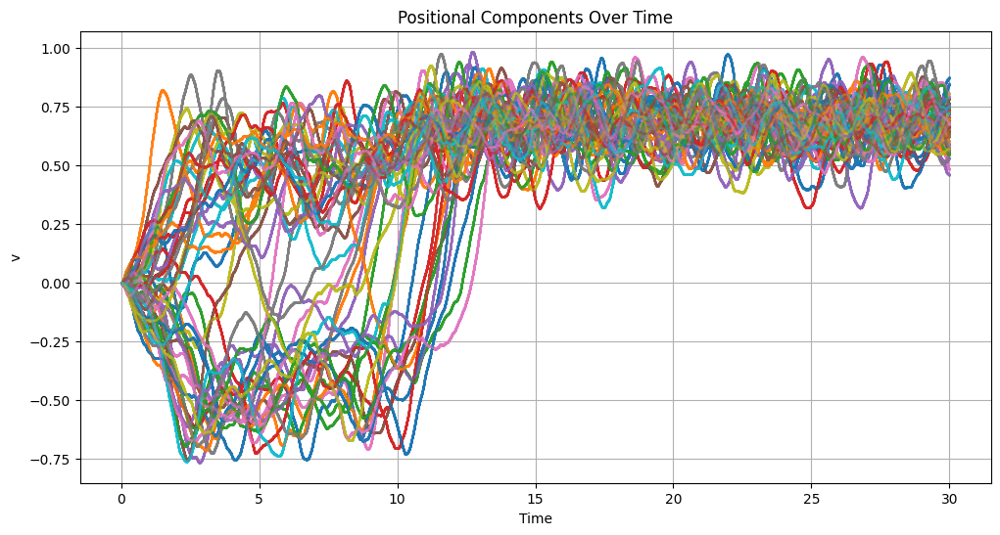

Optimising EM-based contrast estimator starts.
[1.97775543 1.51869178 0.49516091 1.91046989]
Likelihood value and gradient with estimated parameters:
(Array(-60800.887, dtype=float32), Array([-3.8919039e-05,  6.9044530e-05, -4.7263779e-02,  2.4940877e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.00208497 1.43645072 0.4982065  1.93436551]
Likelihood value and gradient with estimated parameters:
(Array(-1926664.2, dtype=float32), Array([ 5.2583218e-04, -2.5775433e-03,  1.0613954e-01, -7.1836635e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 75
Compute the sample paths


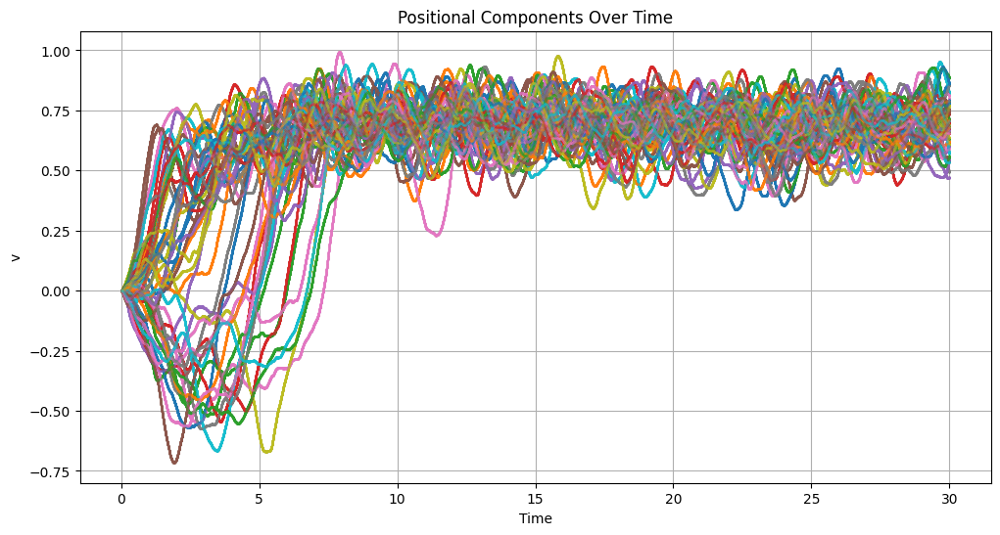

Optimising EM-based contrast estimator starts.
[1.91556394 1.66717517 0.49383897 2.00995088]
Likelihood value and gradient with estimated parameters:
(Array(-61602.062, dtype=float32), Array([ 2.5636400e-05, -6.6347420e-06, -2.0592323e-02,  1.6422069e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94328928 1.5852778  0.49773628 2.0382545 ]
Likelihood value and gradient with estimated parameters:
(Array(-1927028.2, dtype=float32), Array([ 3.5768747e-04, -2.0813942e-03, -9.2936516e-01, -2.1215528e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 76
Compute the sample paths


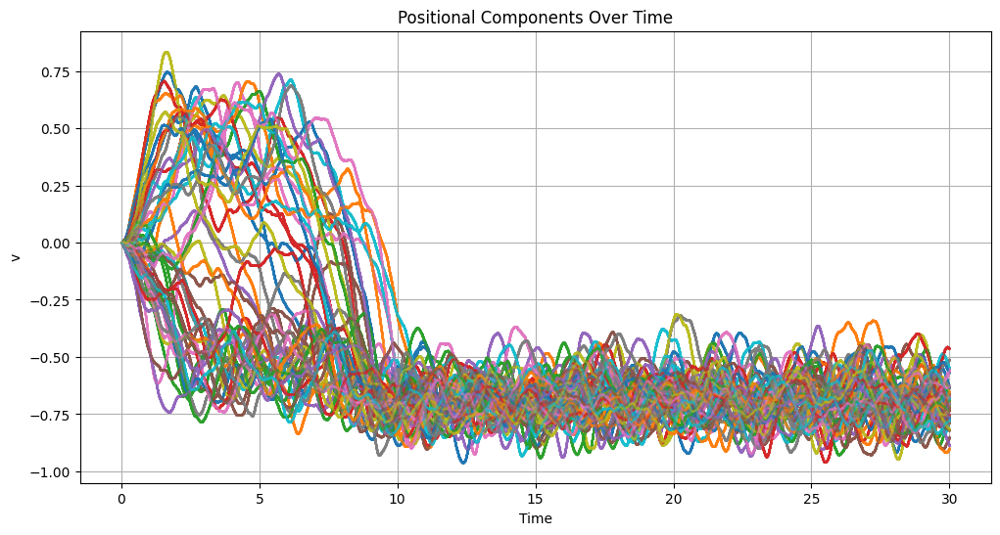

Optimising EM-based contrast estimator starts.
[1.91359138 1.65752792 0.4937821  2.03856754]
Likelihood value and gradient with estimated parameters:
(Array(-61636.594, dtype=float32), Array([-4.1584135e-05, -2.2545457e-05,  5.5099923e-02,  1.2810651e-04],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.93976092 1.5768193  0.49723265 2.06693745]
Likelihood value and gradient with estimated parameters:
(Array(-1927327.5, dtype=float32), Array([ 2.6680529e-04, -1.2638569e-03, -1.7368575e+00, -4.9469993e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 77
Compute the sample paths


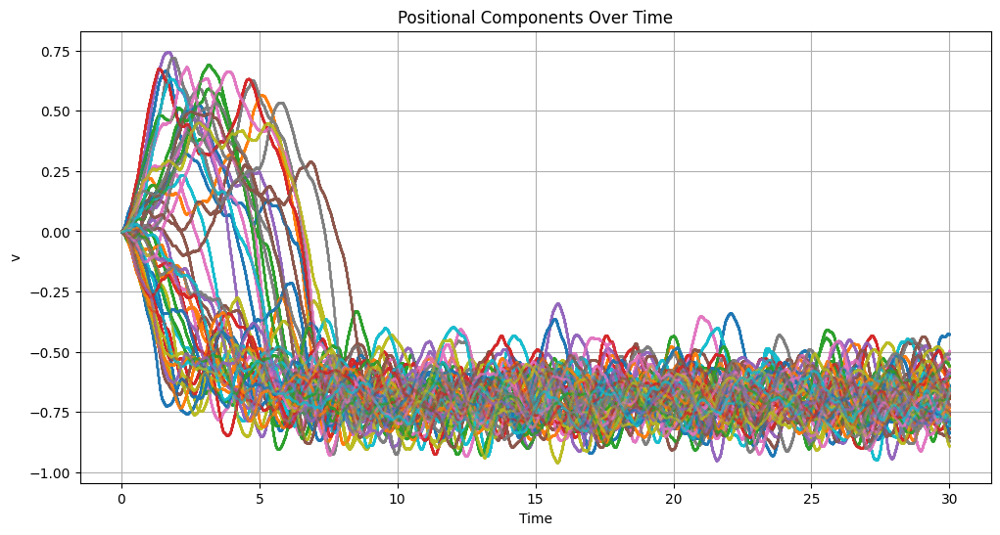

Optimising EM-based contrast estimator starts.
[2.00573754 1.66306937 0.49571896 2.02209353]
Likelihood value and gradient with estimated parameters:
(Array(-60463.312, dtype=float32), Array([-2.4357840e-05, -8.8751316e-05,  4.7814857e-02,  2.4446170e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.03520298 1.57632053 0.49934354 2.04976797]
Likelihood value and gradient with estimated parameters:
(Array(-1926057.9, dtype=float32), Array([ 1.41859055e-04,  2.87055969e-04,  1.20010674e-01, -7.45058060e-09],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 78
Compute the sample paths


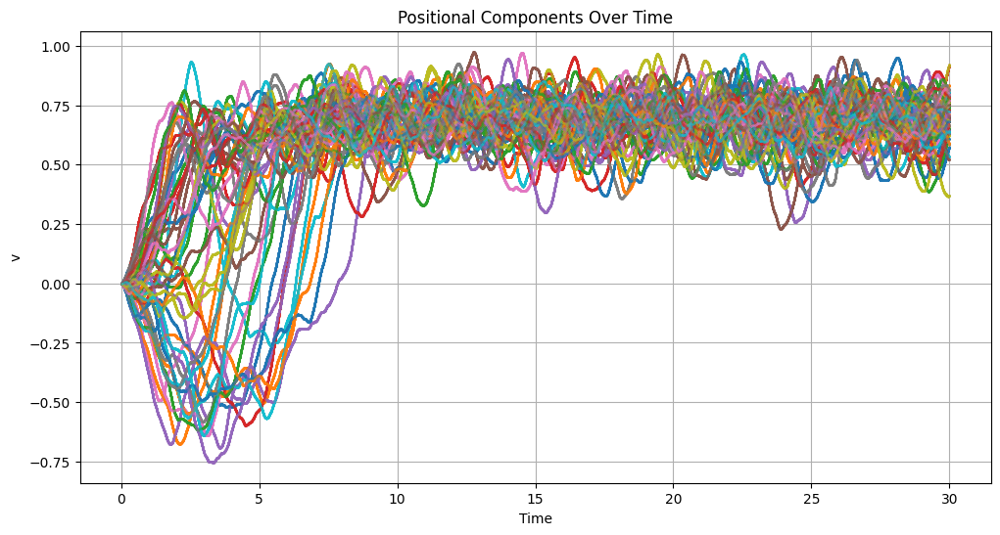

Optimising EM-based contrast estimator starts.
[1.96960056 1.61746502 0.49414137 1.93804896]
Likelihood value and gradient with estimated parameters:
(Array(-61418.582, dtype=float32), Array([ 2.2042077e-05,  4.9781054e-05, -9.8532706e-02, -1.4125195e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99578261 1.51869512 0.4967767  1.96397173]
Likelihood value and gradient with estimated parameters:
(Array(-1927570.2, dtype=float32), Array([-1.5728176e-05,  1.2138039e-03,  2.8176141e-01,  1.3740733e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 79
Compute the sample paths


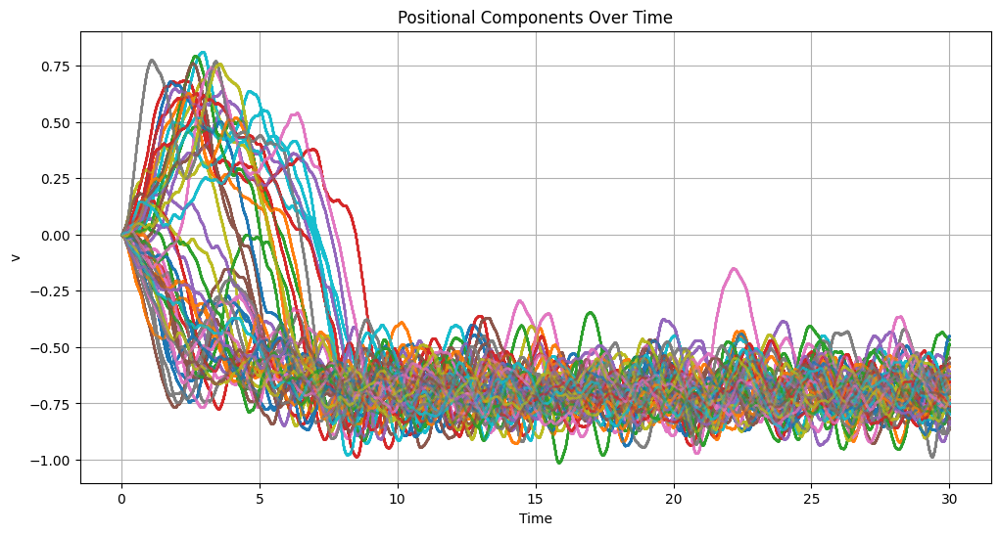

Optimising EM-based contrast estimator starts.
[1.92605877 1.62223732 0.49494991 1.91870475]
Likelihood value and gradient with estimated parameters:
(Array(-60928.6, dtype=float32), Array([-1.0915115e-04,  2.3953617e-05, -4.7990378e-02, -2.0658190e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95191896 1.53636801 0.49841797 1.94491613]
Likelihood value and gradient with estimated parameters:
(Array(-1926592., dtype=float32), Array([-3.9245933e-06,  5.1259995e-05, -1.9217730e-03,  6.5630302e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 80
Compute the sample paths


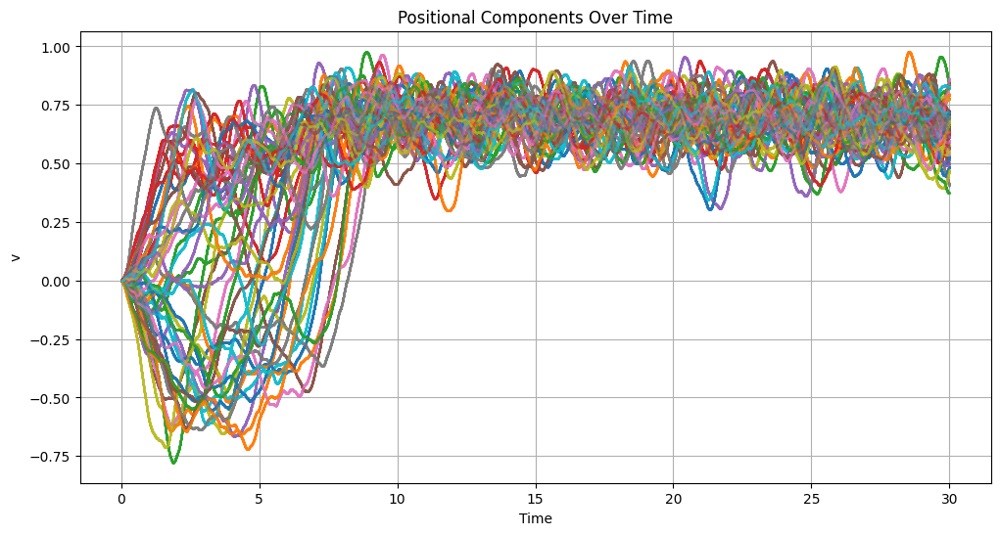

Optimising EM-based contrast estimator starts.
[1.96739531 1.59811008 0.49567181 2.1352756 ]
Likelihood value and gradient with estimated parameters:
(Array(-60491.797, dtype=float32), Array([-1.2933929e-04, -1.4168024e-04, -6.8081982e-02, -2.4482142e-07],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99446285 1.50695193 0.49867734 2.16406131]
Likelihood value and gradient with estimated parameters:
(Array(-1926419., dtype=float32), Array([-6.4551830e-05,  1.4427900e-03, -4.5359468e-01,  7.7707693e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 81
Compute the sample paths


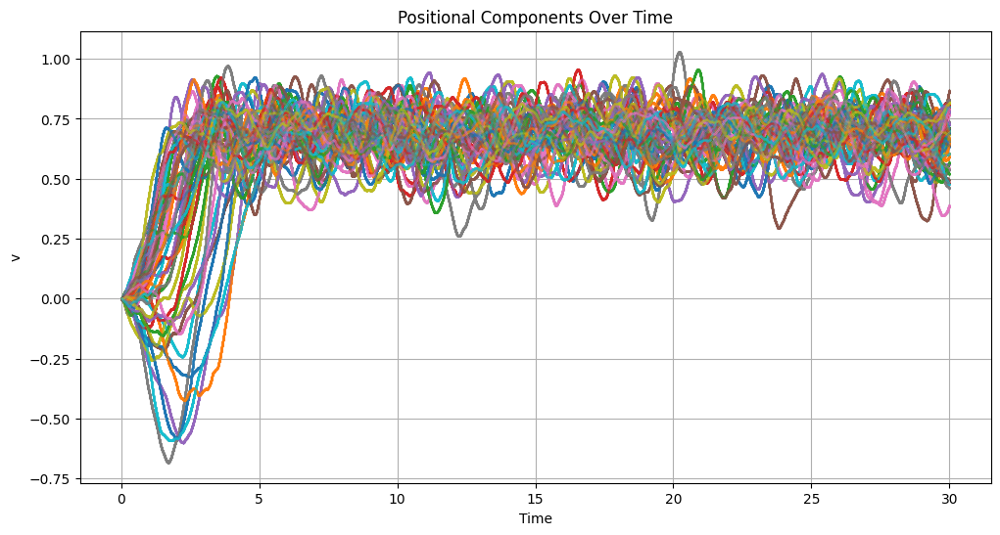

Optimising EM-based contrast estimator starts.
[1.96860957 1.64163327 0.49459347 1.96509612]
Likelihood value and gradient with estimated parameters:
(Array(-61144.527, dtype=float32), Array([-3.0812633e-05,  7.6845288e-05,  3.0187590e-03, -1.0858494e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99368656 1.54488933 0.49797565 1.99690807]
Likelihood value and gradient with estimated parameters:
(Array(-1926861.5, dtype=float32), Array([ 1.7394871e-04, -2.7394295e-03,  2.3267388e-01, -1.2811273e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 82
Compute the sample paths


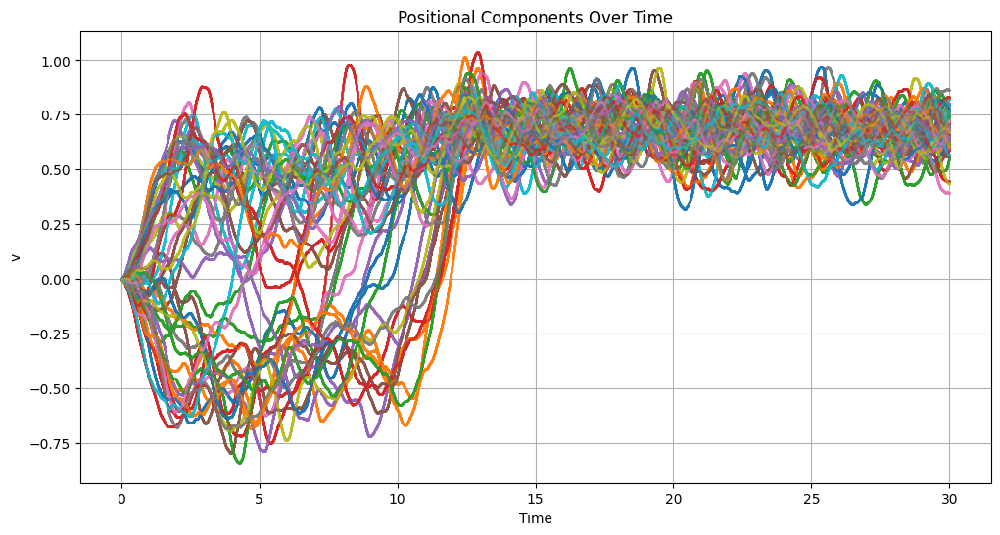

Optimising EM-based contrast estimator starts.
[1.94168782 1.53217113 0.49399322 1.99752092]
Likelihood value and gradient with estimated parameters:
(Array(-61508.465, dtype=float32), Array([-9.5158350e-05,  1.7814524e-04,  1.0925951e-02,  1.3435492e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96775746 1.45758545 0.4974395  2.02370048]
Likelihood value and gradient with estimated parameters:
(Array(-1927137.2, dtype=float32), Array([-4.6730042e-05, -2.1502972e-03,  8.2849097e-01, -3.5963021e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 83
Compute the sample paths


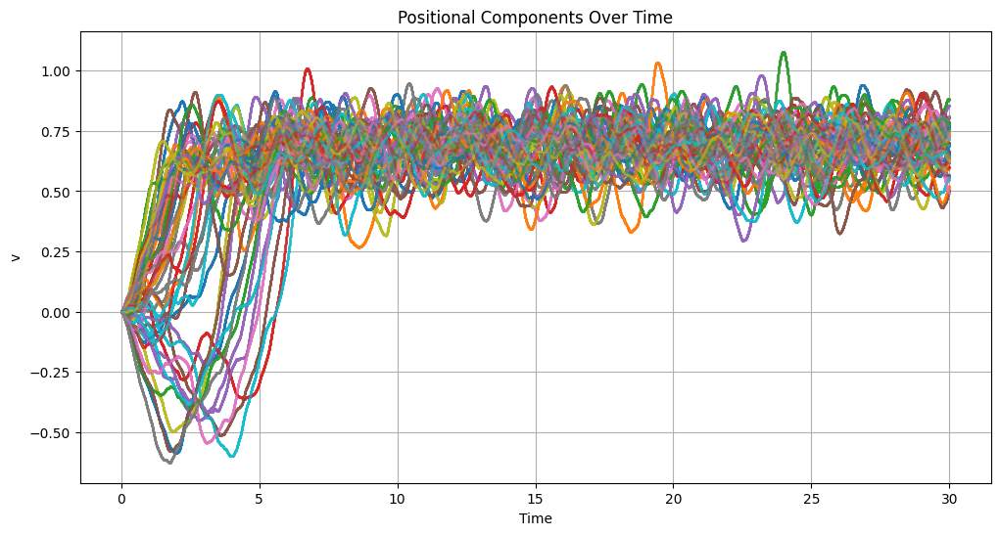

Optimising EM-based contrast estimator starts.
[1.95662522 1.60702622 0.49507204 1.95493627]
Likelihood value and gradient with estimated parameters:
(Array(-60854.664, dtype=float32), Array([-5.10108657e-05, -8.54507089e-05, -6.72531500e-02, -1.09055545e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98184574 1.51660848 0.49862319 1.9822998 ]
Likelihood value and gradient with estimated parameters:
(Array(-1926456.9, dtype=float32), Array([-1.8968433e-04,  1.7719269e-03, -1.0361397e-01, -1.1557713e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 84
Compute the sample paths


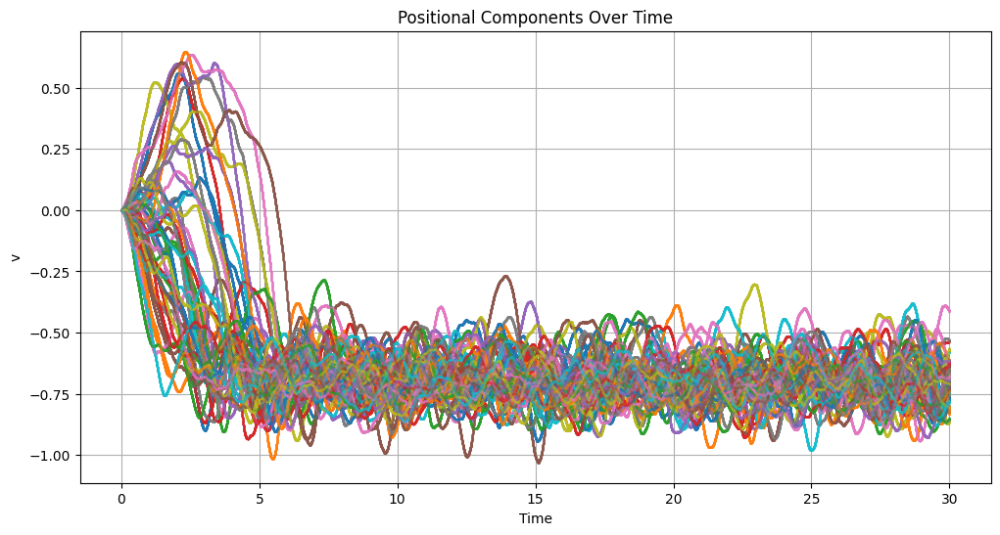

Optimising EM-based contrast estimator starts.
[1.94249046 1.63405836 0.49441257 2.04058981]
Likelihood value and gradient with estimated parameters:
(Array(-61254.16, dtype=float32), Array([-6.0439343e-05,  1.1205301e-04,  3.2020148e-02, -5.7823490e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96905935 1.53630114 0.4977347  2.06925702]
Likelihood value and gradient with estimated parameters:
(Array(-1927002.2, dtype=float32), Array([-6.2766671e-04,  5.1424503e-03,  8.8718021e-01, -3.2521784e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 85
Compute the sample paths


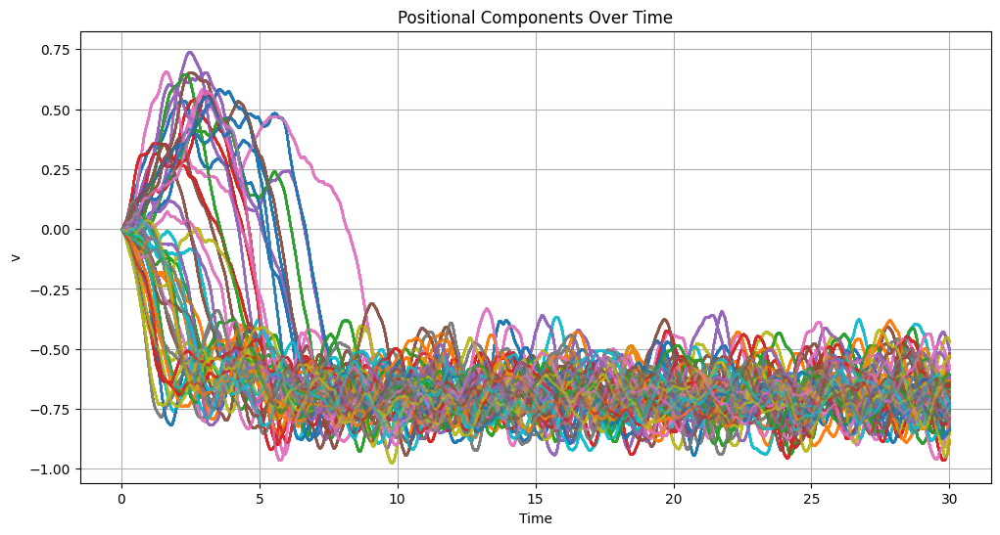

Optimising EM-based contrast estimator starts.
[1.96089613 1.62710166 0.49494284 1.86345744]
Likelihood value and gradient with estimated parameters:
(Array(-60932.895, dtype=float32), Array([ 1.46521488e-04, -1.02177262e-04, -3.12530100e-02,  1.30145345e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98861969 1.52846885 0.49770147 1.88872862]
Likelihood value and gradient with estimated parameters:
(Array(-1927018.2, dtype=float32), Array([-1.9696355e-04,  1.5954673e-03,  7.6429492e-01, -9.1195805e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 86
Compute the sample paths


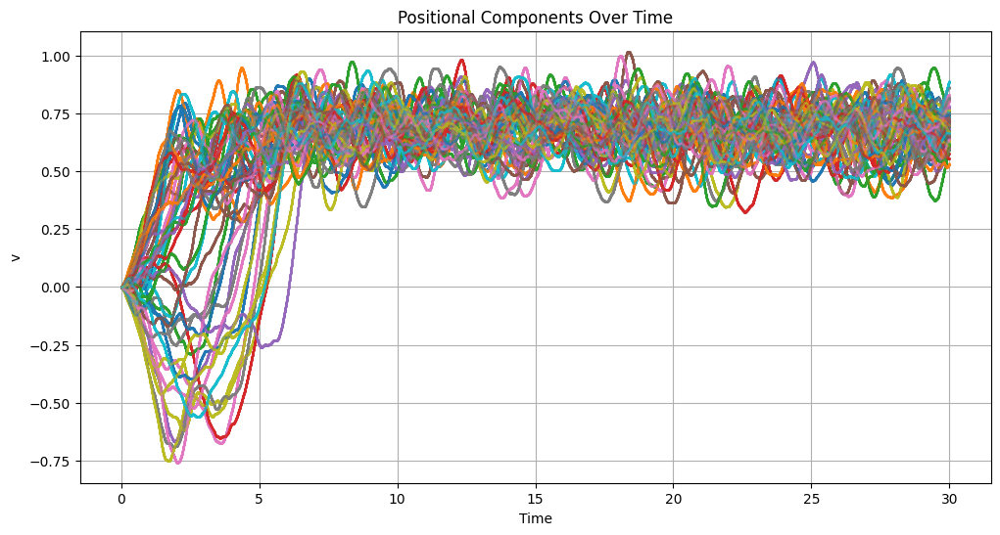

Optimising EM-based contrast estimator starts.
[1.94747245 1.55745113 0.49639273 2.04459667]
Likelihood value and gradient with estimated parameters:
(Array(-60056.242, dtype=float32), Array([ 1.0515307e-04, -3.1918287e-05, -5.9719976e-02,  9.5693395e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97177517 1.46247399 0.49988395 2.07230377]
Likelihood value and gradient with estimated parameters:
(Array(-1925669.8, dtype=float32), Array([ 4.8481673e-04, -3.2534599e-03, -4.3134403e-01, -3.2037497e-07],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 87
Compute the sample paths


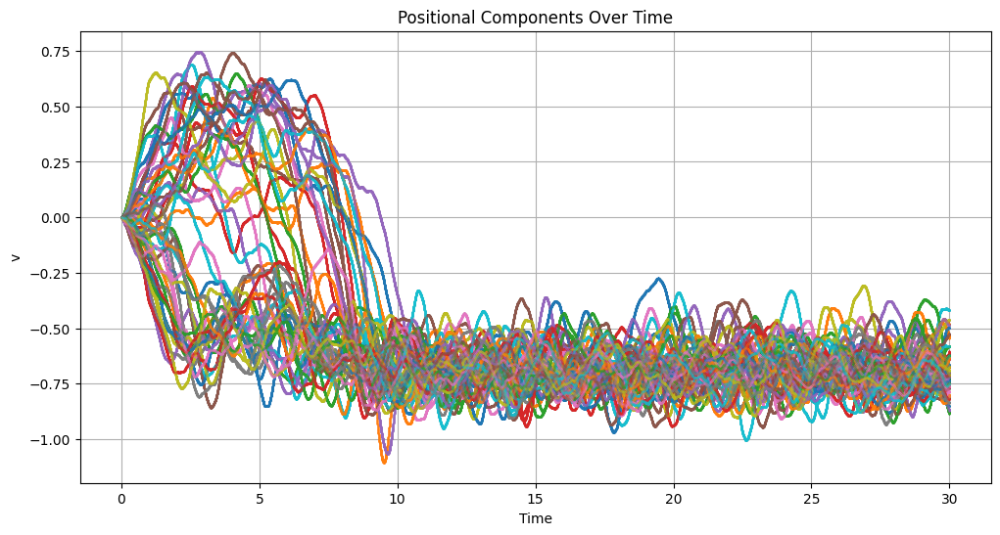

Optimising EM-based contrast estimator starts.
[1.93158698 1.62543619 0.49558401 2.05178213]
Likelihood value and gradient with estimated parameters:
(Array(-60544.89, dtype=float32), Array([-6.4892229e-05,  8.6382031e-05, -4.9154967e-02, -2.7738512e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95701909 1.54070437 0.49881962 2.07955027]
Likelihood value and gradient with estimated parameters:
(Array(-1926351.8, dtype=float32), Array([ 7.1077049e-04, -3.8460493e-03, -1.0522485e-01,  1.2008473e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 88
Compute the sample paths


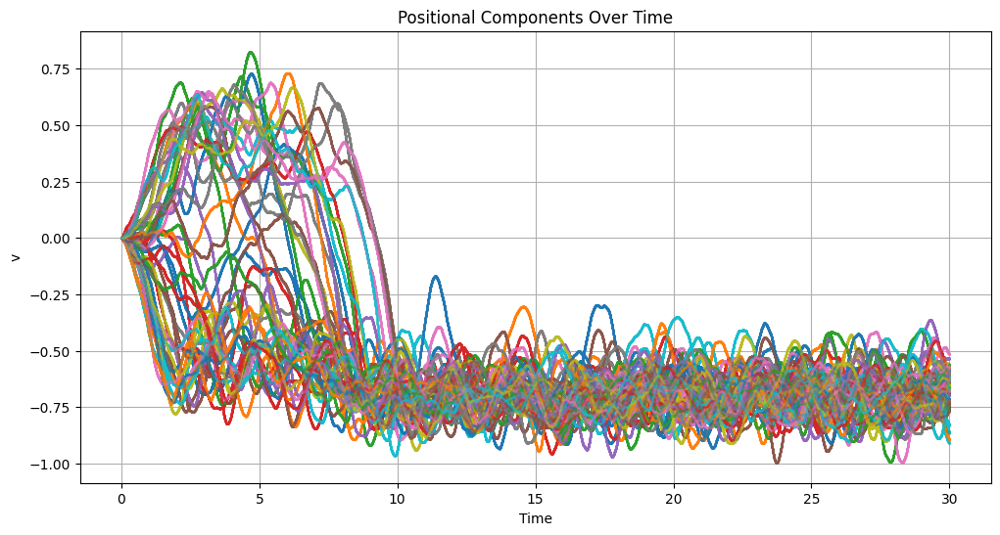

Optimising EM-based contrast estimator starts.
[2.05448127 1.56331944 0.49509886 2.08207726]
Likelihood value and gradient with estimated parameters:
(Array(-60838.445, dtype=float32), Array([-2.1061045e-04, -1.4622509e-04,  3.2044765e-02,  6.9222180e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[2.08115935 1.47246444 0.49843785 2.10898614]
Likelihood value and gradient with estimated parameters:
(Array(-1926544.5, dtype=float32), Array([-1.2286007e-04,  2.0430088e-03, -3.3962727e-04, -4.5442954e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 89
Compute the sample paths


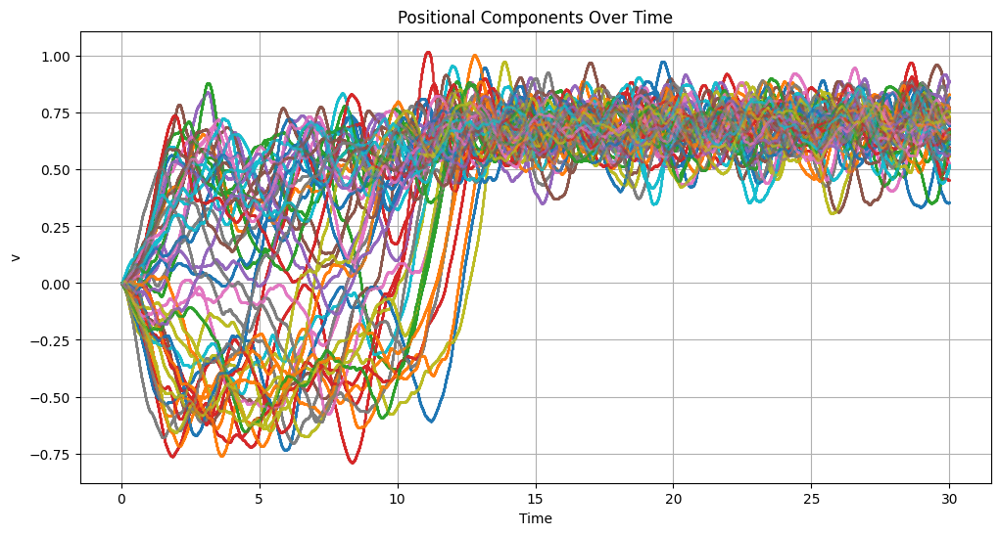

Optimising EM-based contrast estimator starts.
[1.91716993 1.62147105 0.49639902 2.00298834]
Likelihood value and gradient with estimated parameters:
(Array(-60052.438, dtype=float32), Array([-4.5245048e-05,  1.1522323e-04, -6.1921109e-03,  2.9304065e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94437635 1.55026639 0.49979883 2.03080893]
Likelihood value and gradient with estimated parameters:
(Array(-1925769.5, dtype=float32), Array([-2.8328598e-04,  2.4533272e-03, -4.1597152e-01,  3.9463397e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 90
Compute the sample paths


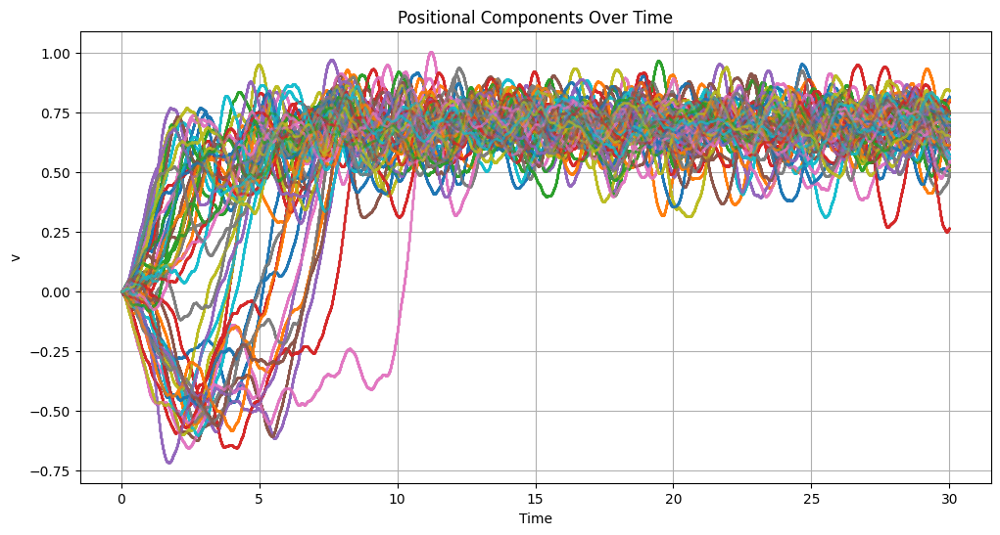

Optimising EM-based contrast estimator starts.
[1.92535913 1.67188299 0.49563596 1.90866411]
Likelihood value and gradient with estimated parameters:
(Array(-60513.473, dtype=float32), Array([ 1.6815285e-04,  1.7928891e-05, -1.0503223e-01,  9.9884346e-07],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95257258 1.58347666 0.49890673 1.93571305]
Likelihood value and gradient with estimated parameters:
(Array(-1926323.8, dtype=float32), Array([ 1.5333295e-05, -2.9344559e-03,  1.1190832e-02, -8.5011125e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 91
Compute the sample paths


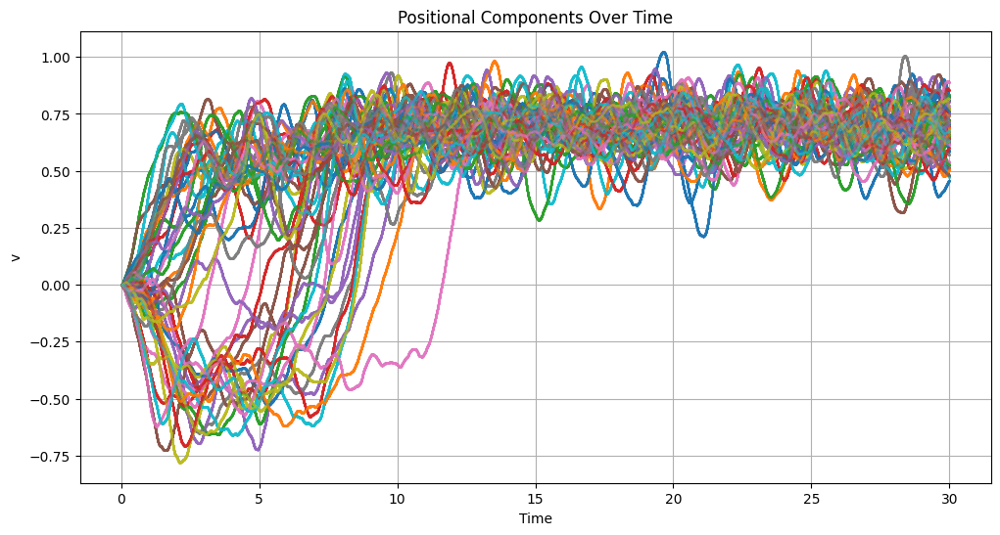

Optimising EM-based contrast estimator starts.
[1.92980075 1.61309195 0.49563572 1.85803068]
Likelihood value and gradient with estimated parameters:
(Array(-60513.67, dtype=float32), Array([ 4.5537105e-05, -4.1415915e-05,  1.0195034e-01,  1.9291794e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95557666 1.53048086 0.49905619 1.88300335]
Likelihood value and gradient with estimated parameters:
(Array(-1926204.2, dtype=float32), Array([-2.6509166e-05,  2.9709339e-03, -7.1790934e-01,  2.8574839e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 92
Compute the sample paths


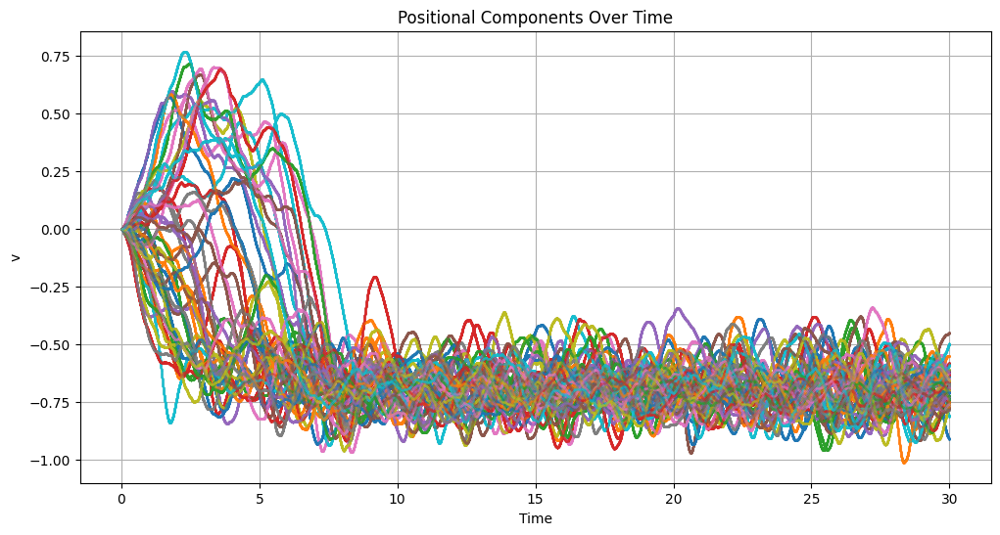

Optimising EM-based contrast estimator starts.
[1.93872917 1.67470741 0.49362031 1.88265324]
Likelihood value and gradient with estimated parameters:
(Array(-61734.83, dtype=float32), Array([ 1.2872479e-04, -5.9604645e-08, -1.4762814e-03, -3.8730650e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.9654808  1.58859134 0.49720848 1.90963137]
Likelihood value and gradient with estimated parameters:
(Array(-1927349., dtype=float32), Array([ 3.3747405e-04, -1.7502308e-03,  7.8950480e-02,  1.9825995e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 93
Compute the sample paths


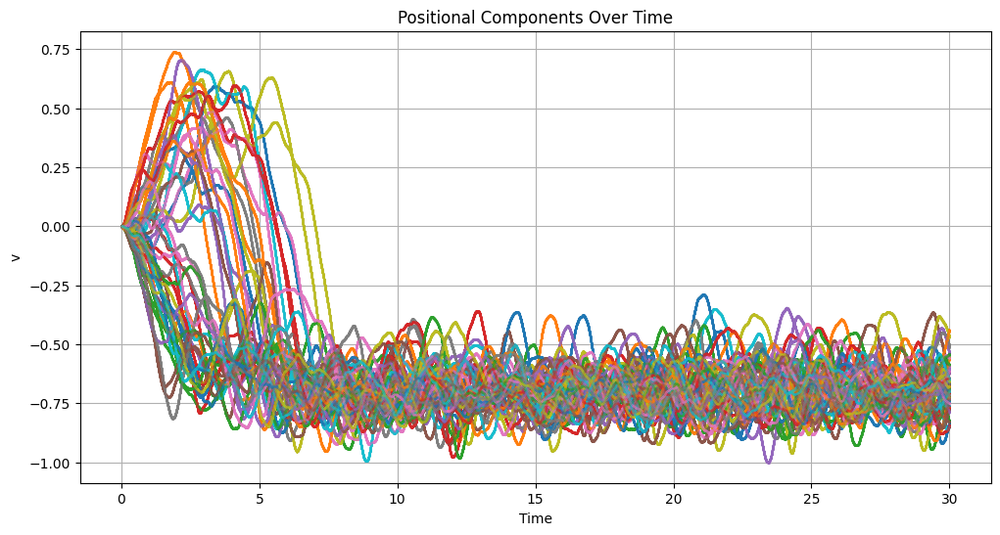

Optimising EM-based contrast estimator starts.
[1.94807243 1.63302267 0.49517307 2.00159383]
Likelihood value and gradient with estimated parameters:
(Array(-60793.555, dtype=float32), Array([-1.9992027e-04,  2.3849308e-04,  6.5353386e-02, -3.4928438e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97645855 1.54076982 0.49857846 2.02841091]
Likelihood value and gradient with estimated parameters:
(Array(-1926496.6, dtype=float32), Array([ 4.3520331e-04, -2.0554066e-03, -9.2553031e-01,  3.9264560e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 94
Compute the sample paths


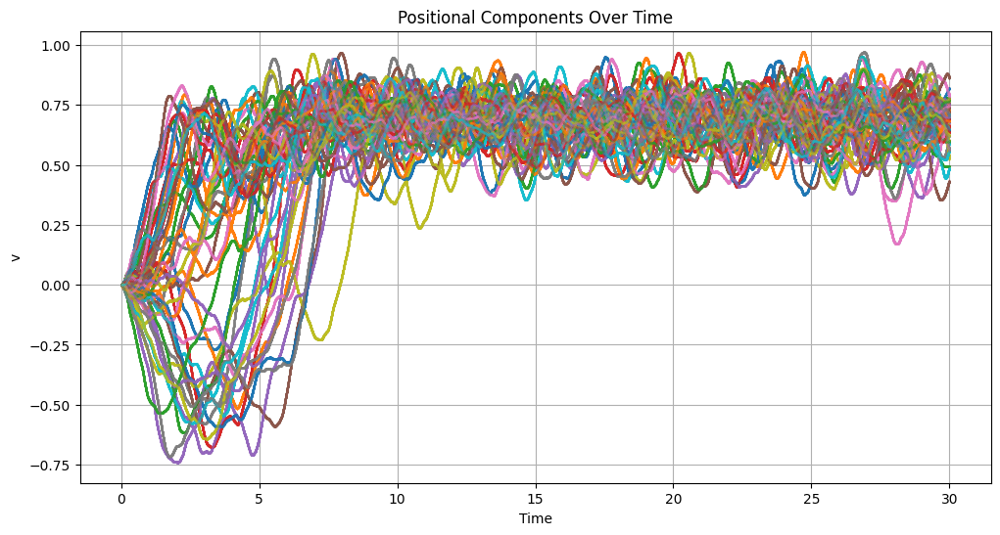

Optimising EM-based contrast estimator starts.
[1.93900847 1.58274376 0.49379084 1.86751044]
Likelihood value and gradient with estimated parameters:
(Array(-61631.29, dtype=float32), Array([ 1.8735882e-06, -9.8429620e-05,  2.6577301e-02,  2.1209707e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.96640301 1.49758625 0.49703464 1.89195883]
Likelihood value and gradient with estimated parameters:
(Array(-1927402.6, dtype=float32), Array([ 3.9649010e-04, -1.3132095e-03, -1.7879027e-01,  4.1047111e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 95
Compute the sample paths


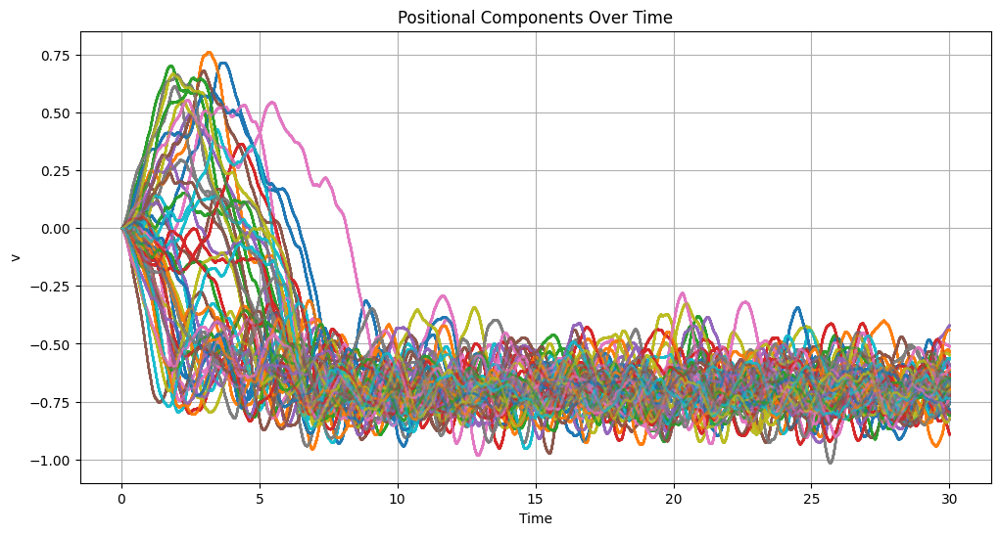

Optimising EM-based contrast estimator starts.
[1.91407502 1.60852969 0.49390647 1.91141725]
Likelihood value and gradient with estimated parameters:
(Array(-61561.1, dtype=float32), Array([-5.5598561e-05,  3.7193298e-05, -2.0725140e-03, -2.3632747e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.94053066 1.52403402 0.4976075  1.93736529]
Likelihood value and gradient with estimated parameters:
(Array(-1927072.6, dtype=float32), Array([ 6.2435865e-05, -1.1534691e-03,  2.4601531e-01, -6.4820051e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 96
Compute the sample paths


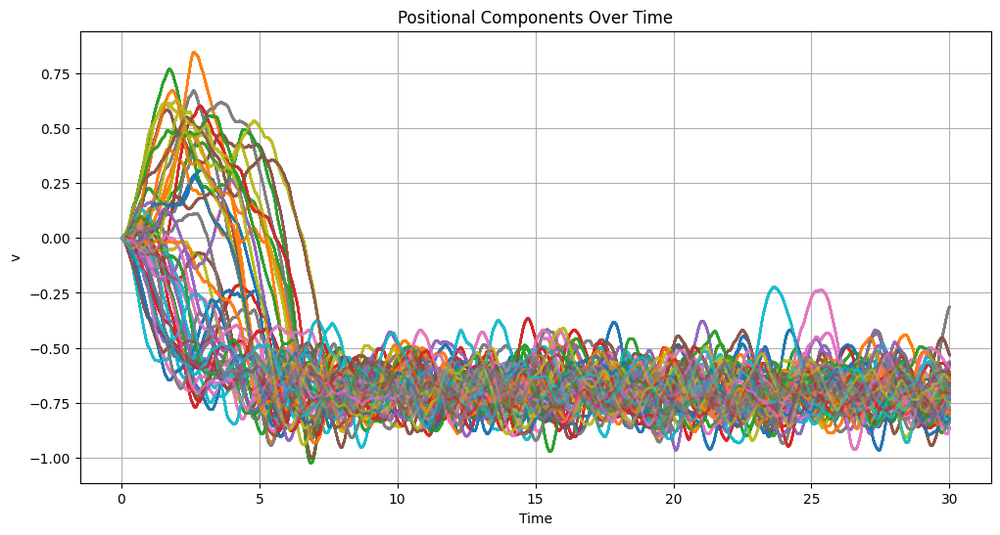

Optimising EM-based contrast estimator starts.
[1.92850649 1.59296787 0.49484232 2.05240941]
Likelihood value and gradient with estimated parameters:
(Array(-60993.797, dtype=float32), Array([-7.96788372e-05, -1.00784004e-04,  3.84689011e-02,  2.40451191e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.95551002 1.50170612 0.49811906 2.07964635]
Likelihood value and gradient with estimated parameters:
(Array(-1926752.8, dtype=float32), Array([ 4.2212009e-04, -5.2735806e-03, -3.4836537e-01, -5.4161996e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 97
Compute the sample paths


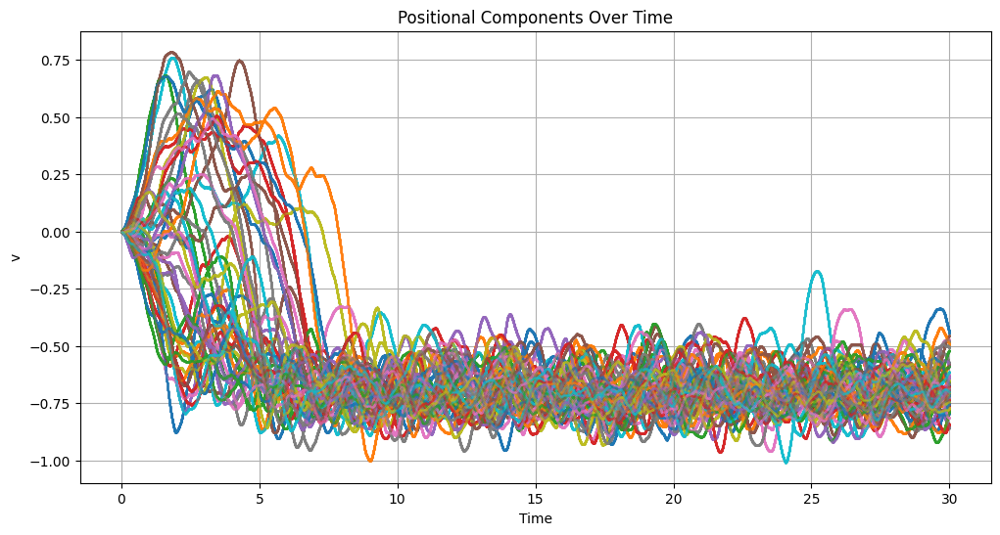

Optimising EM-based contrast estimator starts.
[1.96575654 1.59609914 0.49433321 1.98641586]
Likelihood value and gradient with estimated parameters:
(Array(-61302.28, dtype=float32), Array([ 1.0616868e-04,  2.9064715e-05, -6.9357208e-03, -8.6062355e-06],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.99413657 1.50598168 0.49744046 2.01281571]
Likelihood value and gradient with estimated parameters:
(Array(-1927163., dtype=float32), Array([-1.3637543e-04,  5.8877468e-04, -1.8556356e-02, -8.3325431e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 98
Compute the sample paths


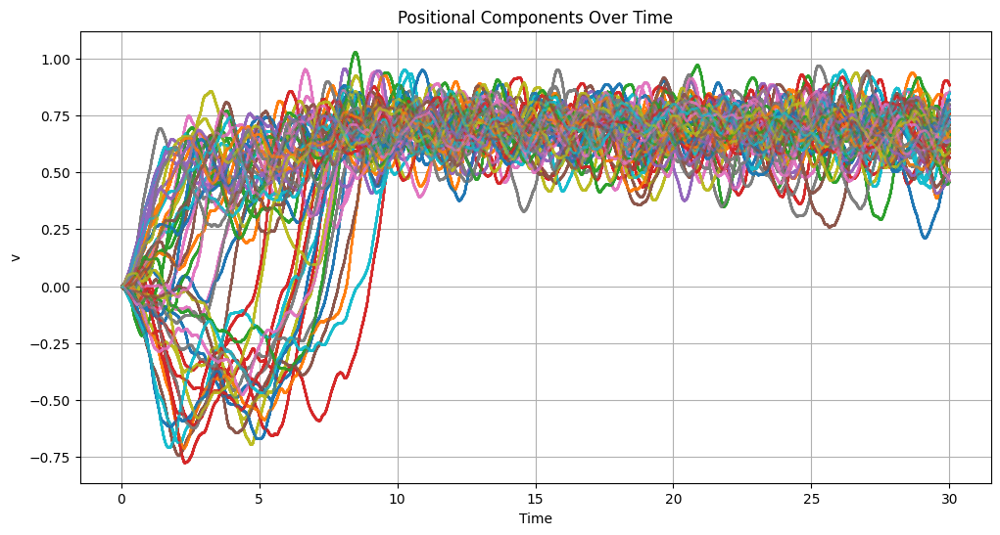

Optimising EM-based contrast estimator starts.
[1.9605459  1.54171169 0.49501169 1.98014641]
Likelihood value and gradient with estimated parameters:
(Array(-60891.21, dtype=float32), Array([-1.85682904e-04,  1.05932355e-04,  8.29170644e-02,  1.67107792e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.98702765 1.46189475 0.49873495 2.00564313]
Likelihood value and gradient with estimated parameters:
(Array(-1926359.6, dtype=float32), Array([ 1.88618898e-04, -7.73429871e-04, -1.11201406e-01,  4.17977571e-06],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 99
Compute the sample paths


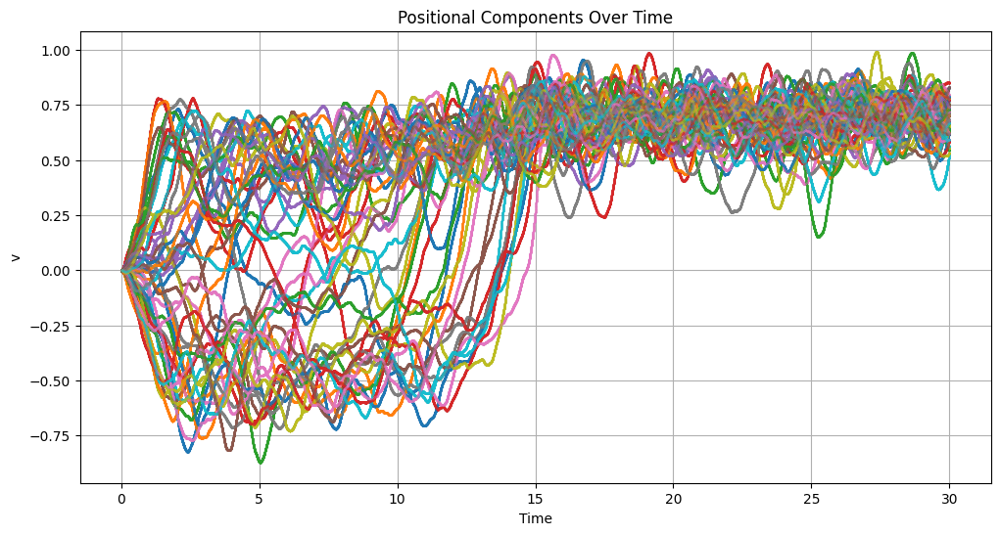

Optimising EM-based contrast estimator starts.
[1.94765425 1.59880805 0.49392006 1.90900433]
Likelihood value and gradient with estimated parameters:
(Array(-61552.86, dtype=float32), Array([-5.0759991e-05, -9.3519688e-05,  3.1032041e-02, -1.9206508e-04],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.97535884 1.52703691 0.49713087 1.93537521]
Likelihood value and gradient with estimated parameters:
(Array(-1927361.8, dtype=float32), Array([ 2.9653311e-04, -1.8258095e-03,  4.4989556e-01, -1.7951801e-04],      dtype=float32))
Optimising LG-based contrast estimator ends.
Iteration 100
Compute the sample paths


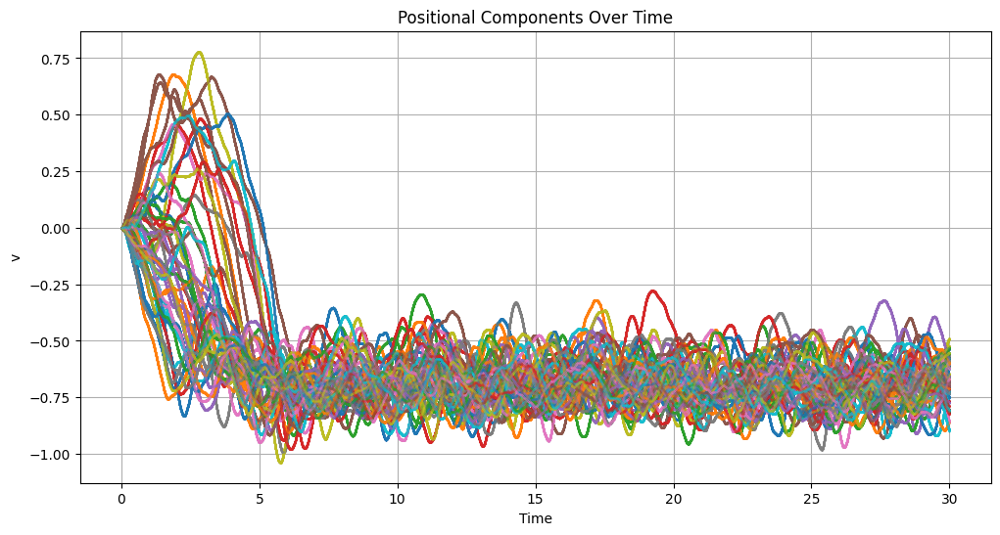

Optimising EM-based contrast estimator starts.
[1.82844198 1.65199733 0.49428707 2.15714645]
Likelihood value and gradient with estimated parameters:
(Array(-61330.258, dtype=float32), Array([ 9.0664253e-06,  1.9026920e-04, -2.2682332e-02, -3.9858511e-05],      dtype=float32))
Optimising EM-based contrast estimator ends.
Optimising LG-based contrast estimator starts.
[1.8535099  1.56129968 0.49743173 2.18875813]
Likelihood value and gradient with estimated parameters:
(Array(-1927199.2, dtype=float32), Array([-3.3655763e-04,  2.6705861e-03, -4.5136154e-01, -3.0670199e-05],      dtype=float32))
Optimising LG-based contrast estimator ends.


In [43]:
for i in range(num_iter):
    print(f"Iteration {i+1}")
    print("Compute the sample paths")
    xy_seq_particles_sim = run_simulation(seed=int(20250625 + int(i)), 
    num_particles=int(num_particles), num_steps=int(num_steps), dt=float(dt_sim), model_parameters=model_parameters, 
    grad_potential_func=grad_potential_func, discard_steps=int(discard_steps))

    x_seq_particles_sim = xy_seq_particles_sim[:, :, 1]  # Voltage variable
    # Run simulation for each iteration
    x_seq_particles_obs = x_seq_particles_sim[::sub_interval, :]  # Downsampled for observation

    empirical_mean_seq = x_seq_particles_obs[:, :].mean(axis=1)  # Mean of v over time for all particles 

    showplots(x_seq_particles_sim, x_seq_particles_obs, t_seq_sim, t_seq_obs)

    θ_0 = jnp.array([1.0, 1.0, 1.0, 1.0])  # Initial guess for parameters  

    print("Optimising EM-based contrast estimator starts.")
      
    θ_seq_em[:, i] = compute_contrast_estimator_em(
        ips_udl_em.get_contrast_function, x_seq_particles_obs, θ_0, empirical_mean_seq
    )
        
    print(θ_seq_em[:, i])

    print("Likelihood value and gradient with estimated parameters:")
    print(value_and_grad(ips_udl_em.get_contrast_function)(
            θ_seq_em[:, i], x_seq_particles_obs, empirical_mean_seq
        ))
    
    print("Optimising EM-based contrast estimator ends.") 

    print("Optimising LG-based contrast estimator starts.")
      
    θ_seq_lg[:, i] = compute_contrast_estimator_lg(
        ips_udl.get_contrast_function, x_seq_particles_obs, θ_0, initial_mean, initial_cov, empirical_mean_seq
    )
        
    print(θ_seq_lg[:, i])

    print("Likelihood value and gradient with estimated parameters:")
    print(value_and_grad(ips_udl.get_contrast_function)(
            θ_seq_lg[:, i], x_seq_particles_obs, initial_mean, initial_cov, empirical_mean_seq
        ))
    
    print("Optimising LG-based contrast estimator ends.") 




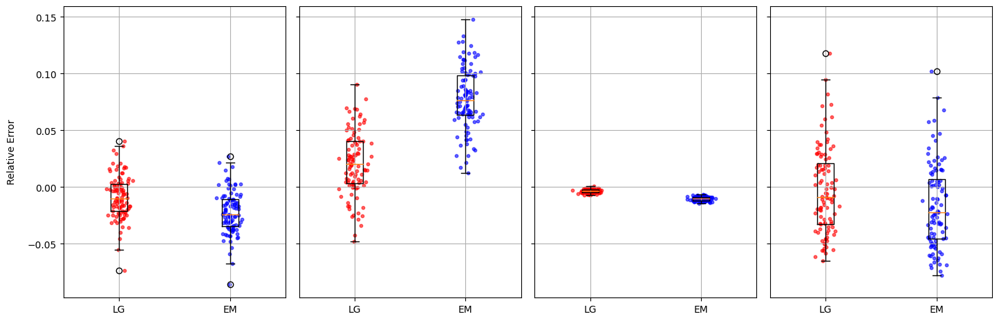

In [44]:
import matplotlib.pyplot as plt
import numpy as np

# Number of parameters
num_parameters = θ_seq_lg.shape[0]

# Create a single figure with subplots for relative errors of θ_seq_lg and θ_seq_em
fig, axes = plt.subplots(1, num_parameters, figsize=(15, 5), sharey=True)  # Adjust width and height
# fig.suptitle("Relative Errors of θ_seq_lg and θ_seq_em Parameters", fontsize=16)

reference_values = [model_parameters['lambda'], model_parameters['gamma'], model_parameters['sigma'], model_parameters['kappa']]
parameter_labels = ['λ', 'γ', 'σ', 'κ']  # True labels from model_parameters

for i in range(num_parameters):
    # Data for LG relative errors for the current parameter
    lg_data = (θ_seq_lg[i, :] - reference_values[i]) / reference_values[i]
    em_data = (θ_seq_em[i, :] - reference_values[i]) / reference_values[i]
    
    # Create boxplot for the current parameter
    axes[i].boxplot([lg_data, em_data], labels=['LG', 'EM'])
    axes[i].grid(True)

    # Overlay scattered points for LG and EM
    lg_positions = np.random.normal(1, 0.05, size=len(lg_data))  # Add slight jitter for LG
    em_positions = np.random.normal(2, 0.05, size=len(em_data))  # Add slight jitter for EM
    axes[i].scatter(lg_positions, lg_data, alpha=0.6, color='red', s=10, label='LG Data Points')
    axes[i].scatter(em_positions, em_data, alpha=0.6, color='blue', s=10, label='EM Data Points')

# Add a shared y-axis label
fig.text(0.04, 0.5, 'Relative Error', va='center', rotation='vertical')

plt.tight_layout(rect=[0.05, 0, 1, 0.95])  # Adjust layout to fit the title
plt.show()


In [45]:
import pandas as pd

# Combine θ_seq_lg and θ_seq_em into a single DataFrame
data = {
    f"LG_θ_{i+1}": θ_seq_lg[i, :] for i in range(θ_seq_lg.shape[0])
}
data.update({
    f"EM_θ_{i+1}": θ_seq_em[i, :] for i in range(θ_seq_em.shape[0])
})

df = pd.DataFrame(data)

# Write the DataFrame to a CSV file
output_file = "ips_udl_partial.csv"
df.to_csv(output_file, index=False)

print(f"Data successfully written to {output_file}")

Data successfully written to ips_udl_partial.csv
